In [2]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.utils.data as data
import torch.optim as optim
import torch.nn.functional as F

from datetime import datetime
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import KFold
from torch import nn
from tqdm.notebook import tqdm

print(f'GPUs Available: {torch.cuda.device_count()}')
print(f'Device name: {torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU available"}')

GPUs Available: 1
Device name: Tesla T4


In [3]:
# Normalised input features
INPUT_SIGNAL_TYPES = [
    "XMV(1)", "XMV(2)", "XMV(3)", "XMV(4)", "XMV(5)", "XMV(6)", "XMV(7)", "XMV(8)", "XMV(9)", "XMV(10)", "XMV(11)"
]

# Output classes
LABELS = ["NORMAL", "FAULT 1", "FAULT 2", "FAULT 3", "FAULT 4", "FAULT 5", "FAULT 7"]

# Input folders paths
DATASET_PATH = "tep/input/tep_dataset/"

TRAIN = "train/"
TEST = "test/"

X_train_signals_paths = [DATASET_PATH + TRAIN + signal + ".txt" for signal in INPUT_SIGNAL_TYPES]
X_test_signals_paths = [DATASET_PATH + TEST + signal + ".txt" for signal in INPUT_SIGNAL_TYPES]

y_train_path = DATASET_PATH + TRAIN + "idv.txt"
y_test_path = DATASET_PATH + TEST + "idv.txt"

# Helper functions
def load_X(X_signals_paths):
    # Function returns the input features tensor.
    X_signals = []
    for signal_type_path in X_signals_paths:
        with open(signal_type_path, 'r') as file:
            # Read dataset from disk, dealing with text files' syntax
            X_signals.append([np.array(serie, dtype=np.float32) for serie in [row.split() for row in file]])
    return np.transpose(np.array(X_signals), (1, 2, 0))

def load_y(y_path):
    # Function returns the fault labels vector.
    with open(y_path, 'r') as file:
        # Read dataset from disk, dealing with text file's syntax
        y_ = np.array([elem for elem in [row.split() for row in file]], dtype=np.int32)
    return y_

def model_size(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


In [4]:
# Input features tensors
X_train = load_X(X_train_signals_paths)
X_test = load_X(X_test_signals_paths)

# Fault labels
y_train = load_y(y_train_path)
y_test = load_y(y_test_path)

print("Some useful info to get an insight on dataset's shape and normalisation:")
print("(X shape, y shape, every X's mean, every X's standard deviation)")
print(X_test.shape, y_test.shape, np.mean(X_test), np.std(X_test))
print("The dataset is therefore properly normalised, as expected, but not yet one-hot encoded.")
print("")
unique_elements, counts_elements = np.unique(y_train, return_counts=True)
print('Faults distribution in the training set:')
print(np.asarray((unique_elements, counts_elements)))
unique_elements, counts_elements = np.unique(y_test, return_counts=True)
print('\nFaults distribution in the test set:')
print(np.asarray((unique_elements, counts_elements)))

# Input tensor data
training_data_count = len(X_train)  # 5733 training sequences (with 50% overlap between each sequence)
test_data_count = len(X_test)       # 2458 testing sequences
n_steps = len(X_train[0])           # 128 timesteps per sequence
n_input = len(X_train[0][0])        # 11 input features per timestep

Some useful info to get an insight on dataset's shape and normalisation:
(X shape, y shape, every X's mean, every X's standard deviation)
(2458, 128, 11) (2458, 1) -0.0012041103 0.99738777
The dataset is therefore properly normalised, as expected, but not yet one-hot encoded.

Faults distribution in the training set:
[[   0    1    2    3    4    5    7]
 [4709  172  168  162  117  184  221]]

Faults distribution in the test set:
[[   0    1    2    3    4    5    7]
 [2030   65   63   75   54   68  103]]


In [9]:
class StackedLSTM(nn.Module):

    def __init__(self):
        super(StackedLSTM, self).__init__()

        self.dense1 = nn.Linear(11, 32)
        nn.init.normal_(self.dense1.weight, std=1.0)
        nn.init.normal_(self.dense1.bias, std=1.0)

        self.dense2 = nn.Linear(32, 8)
        nn.init.normal_(self.dense2.weight, mean=1.0, std=1.0)
        nn.init.normal_(self.dense2.bias, std=1.0)

        self.lstm1 = nn.LSTM(32, 32, batch_first=True)
        self.lstm2 = nn.LSTM(32, 32, batch_first=True)

    def forward(self, x):
        x = F.relu(self.dense1(x))
        x, _ = self.lstm1(x)
        x, _ = self.lstm2(x)
        x = self.dense2(x[:, -1, :])  # Taking the last time step's output
        return x

# Parameters
epochs = 300
batch_size = 1500
learning_rate = 0.0025
reg_lambda = 0.0015

model = StackedLSTM()
# Save initial weights (this requires a forward pass to initialize parameters)
dummy_input = torch.randn(1, 128, 11)
model(dummy_input)
torch.save(model.state_dict(), '.\\models\\initial_weights.pth')

# Loss function, optimizer, and regularizer
loss_func = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=reg_lambda)

# Metrics (these will be computed manually during training)
train_loss = 0
train_accuracy = 0

test_loss = 0
test_accuracy = 0


In [10]:
X = np.vstack((X_train, X_test))
y = np.vstack((y_train, y_test))

print(f'Train data:\t{X_train.shape}, {y_train.shape}')
print(f'Test data:\t{X_test.shape}, {y_test.shape}')
print(f'Data:\t\t{X.shape}, {y.shape}')

Train data:	(5733, 128, 11), (5733, 1)
Test data:	(2458, 128, 11), (2458, 1)
Data:		(8191, 128, 11), (8191, 1)


In [30]:
def train_step(x_batch, y_batch, model):
    model.train()
    optimizer.zero_grad()

    y_batch = y_batch.squeeze()
    y_batch_pred = model(x_batch)

    loss = loss_func(y_batch_pred, y_batch)

    l2_reg = reg_lambda * sum(param.norm(2) for param in model.parameters())
    loss += l2_reg

    loss.backward()
    optimizer.step()
    train_loss = loss.item()
    train_accuracy = (y_batch_pred.argmax(1) == y_batch).float().mean().item()

    return train_loss, train_accuracy



def test_step(x_batch, y_batch, model):
    model.eval()
    with torch.no_grad():
        y_batch = y_batch.squeeze()
        y_batch = y_batch.long()
        y_batch_pred = model(x_batch)
        loss = loss_func(y_batch_pred, y_batch)

        l2_reg = reg_lambda * sum(param.norm(2) for param in model.parameters())
        loss += l2_reg

        test_loss = loss.item()
        test_accuracy = (y_batch_pred.argmax(1) == y_batch).float().mean().item()

    return test_loss, test_accuracy

def model_training(train_loader, test_loader, device):
    train_losses, test_losses = [], []
    train_accuracies, test_accuracies = [], []
    start = datetime.now()

    for epoch in range(epochs):
        epoch_train_loss, epoch_train_accuracy = 0, 0
        epoch_test_loss, epoch_test_accuracy = 0, 0

        for x_batch, y_batch in tqdm(train_loader, desc=f'Epoch {epoch + 1} [Train]'):
            x_batch, y_batch = x_batch.to(device), y_batch.to(device)
            loss, accuracy = train_step(x_batch, y_batch, model)
            epoch_train_loss += loss
            epoch_train_accuracy += accuracy

        for x_batch, y_batch in tqdm(test_loader, desc=f'Epoch {epoch + 1} [Test]'):
            x_batch, y_batch = x_batch.to(device), y_batch.to(device)
            loss, accuracy = test_step(x_batch, y_batch, model)
            epoch_test_loss += loss
            epoch_test_accuracy += accuracy

        # Averaging over batches
        epoch_train_loss /= len(train_loader)
        epoch_train_accuracy /= len(train_loader)
        epoch_test_loss /= len(test_loader)
        epoch_test_accuracy /= len(test_loader)

        train_losses.append(epoch_train_loss)
        test_losses.append(epoch_test_loss)
        train_accuracies.append(epoch_train_accuracy)
        test_accuracies.append(epoch_test_accuracy)

        print(f'Epoch {epoch + 1}, ', end='')
        print(f'Loss: {epoch_train_loss:.4f}, ', end='')
        print(f'Accuracy: {(epoch_train_accuracy * 100):.4f} %, ', end='')
        print(f'Test Loss: {epoch_test_loss:.4f}, ', end='')
        print(f'Test Accuracy: {(epoch_test_accuracy * 100):.4f} %')

    print(f'\nExec Time: {datetime.now() - start}')
    return train_accuracies, test_accuracies, train_losses, test_losses


In [31]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

kf = KFold(n_splits=5)

folds_res = []
for index, (train_index, test_index) in enumerate(kf.split(X)):
    fold = index + 1

    model.load_state_dict(torch.load('.\\models\\initial_weights.pth'))

    train_dataset = data.TensorDataset(torch.tensor(X[train_index], dtype=torch.float32),
                                       torch.tensor(y[train_index], dtype=torch.long))
    test_dataset = data.TensorDataset(torch.tensor(X[test_index], dtype=torch.float32),
                                      torch.tensor(y[test_index], dtype=torch.long))

    train_loader = data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    test_loader = data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

    print(f'>> Fold {fold} training >>>>')
    train_accuracies, test_accuracies, train_losses, test_losses = model_training(train_loader, test_loader, device)
    print(f'[fold {fold}] Accuracy: {test_accuracies[-1] * 100:.4f} %\n')

    torch.save(model.state_dict(), f'.\\models\\{fold}-fold-model.pth')

    folds_res.append({
        'fold': fold,
        'train_acc': train_accuracies,
        'test_acc': test_accuracies,
        'train_losses': train_losses,
        'test_losses': test_losses
    })

accuracies = np.array([res['test_acc'][-1] for res in folds_res])
print(f'Accuracy: {accuracies.mean():.4f} +/- {accuracies.std():.4f}')


>> Fold 1 training >>>>


Epoch 1 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 1 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 1, Loss: 1.4567, Accuracy: 60.9238 %, Test Loss: 0.7694, Test Accuracy: 83.7002 %


Epoch 2 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 2 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 2, Loss: 0.7835, Accuracy: 84.9017 %, Test Loss: 0.7876, Test Accuracy: 85.2460 %


Epoch 3 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 3 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 3, Loss: 0.7186, Accuracy: 86.8336 %, Test Loss: 0.5797, Test Accuracy: 89.1571 %


Epoch 4 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 4 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 4, Loss: 0.5632, Accuracy: 88.4110 %, Test Loss: 0.5091, Test Accuracy: 90.4571 %


Epoch 5 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 5 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 5, Loss: 0.4875, Accuracy: 91.0516 %, Test Loss: 0.4320, Test Accuracy: 91.2168 %


Epoch 6 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 6 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 6, Loss: 0.4182, Accuracy: 91.3638 %, Test Loss: 0.3750, Test Accuracy: 92.3362 %


Epoch 7 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 7 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 7, Loss: 0.3640, Accuracy: 93.5188 %, Test Loss: 0.3168, Test Accuracy: 95.0153 %


Epoch 8 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 8 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 8, Loss: 0.3192, Accuracy: 95.3400 %, Test Loss: 0.2665, Test Accuracy: 97.6070 %


Epoch 9 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 9 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 9, Loss: 0.3010, Accuracy: 95.7226 %, Test Loss: 0.2495, Test Accuracy: 97.2806 %


Epoch 10 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 10 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 10, Loss: 0.2810, Accuracy: 96.0200 %, Test Loss: 0.2358, Test Accuracy: 97.7070 %


Epoch 11 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 11 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 11, Loss: 0.2729, Accuracy: 96.2487 %, Test Loss: 0.2271, Test Accuracy: 97.7736 %


Epoch 12 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 12 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 12, Loss: 0.2668, Accuracy: 96.3020 %, Test Loss: 0.2177, Test Accuracy: 97.8403 %


Epoch 13 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 13 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 13, Loss: 0.2608, Accuracy: 96.4507 %, Test Loss: 0.2155, Test Accuracy: 97.9403 %


Epoch 14 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 14 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 14, Loss: 0.2589, Accuracy: 96.4029 %, Test Loss: 0.2081, Test Accuracy: 97.9736 %


Epoch 15 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 15 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 15, Loss: 0.2555, Accuracy: 96.4371 %, Test Loss: 0.2047, Test Accuracy: 97.8736 %


Epoch 16 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 16 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 16, Loss: 0.2479, Accuracy: 96.7632 %, Test Loss: 0.2030, Test Accuracy: 98.0070 %


Epoch 17 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 17 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 17, Loss: 0.2473, Accuracy: 96.6716 %, Test Loss: 0.1965, Test Accuracy: 98.1070 %


Epoch 18 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 18 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 18, Loss: 0.2450, Accuracy: 96.7612 %, Test Loss: 0.1969, Test Accuracy: 98.1070 %


Epoch 19 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 19 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 19, Loss: 0.2411, Accuracy: 96.8794 %, Test Loss: 0.1924, Test Accuracy: 98.4667 %


Epoch 20 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 20 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 20, Loss: 0.2425, Accuracy: 96.7954 %, Test Loss: 0.1903, Test Accuracy: 98.5000 %


Epoch 21 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 21 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 21, Loss: 0.2427, Accuracy: 96.8067 %, Test Loss: 0.1926, Test Accuracy: 98.4667 %


Epoch 22 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 22 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 22, Loss: 0.2395, Accuracy: 96.8887 %, Test Loss: 0.1874, Test Accuracy: 98.5000 %


Epoch 23 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 23 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 23, Loss: 0.2362, Accuracy: 96.9745 %, Test Loss: 0.1877, Test Accuracy: 98.4667 %


Epoch 24 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 24 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 24, Loss: 0.2344, Accuracy: 96.9478 %, Test Loss: 0.1871, Test Accuracy: 98.5000 %


Epoch 25 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 25 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 25, Loss: 0.2351, Accuracy: 96.9154 %, Test Loss: 0.1871, Test Accuracy: 98.4667 %


Epoch 26 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 26 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 26, Loss: 0.2337, Accuracy: 96.9649 %, Test Loss: 0.1845, Test Accuracy: 98.5000 %


Epoch 27 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 27 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 27, Loss: 0.2352, Accuracy: 96.8275 %, Test Loss: 0.1852, Test Accuracy: 98.4667 %


Epoch 28 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 28 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 28, Loss: 0.2297, Accuracy: 96.9841 %, Test Loss: 0.1801, Test Accuracy: 98.5333 %


Epoch 29 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 29 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 29, Loss: 0.2348, Accuracy: 96.7684 %, Test Loss: 0.1953, Test Accuracy: 98.4667 %


Epoch 30 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 30 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 30, Loss: 0.2284, Accuracy: 96.9707 %, Test Loss: 0.1787, Test Accuracy: 98.5000 %


Epoch 31 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 31 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 31, Loss: 0.2300, Accuracy: 96.8467 %, Test Loss: 0.1890, Test Accuracy: 98.4667 %


Epoch 32 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 32 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 32, Loss: 0.2201, Accuracy: 97.0357 %, Test Loss: 0.1838, Test Accuracy: 98.5000 %


Epoch 33 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 33 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 33, Loss: 0.2178, Accuracy: 96.9899 %, Test Loss: 0.1756, Test Accuracy: 98.4333 %


Epoch 34 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 34 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 34, Loss: 0.2361, Accuracy: 96.6559 %, Test Loss: 0.1871, Test Accuracy: 98.4333 %


Epoch 35 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 35 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 35, Loss: 0.2212, Accuracy: 96.9536 %, Test Loss: 0.1737, Test Accuracy: 98.4667 %


Epoch 36 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 36 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 36, Loss: 0.2165, Accuracy: 97.0623 %, Test Loss: 0.1746, Test Accuracy: 98.5000 %


Epoch 37 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 37 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 37, Loss: 0.2290, Accuracy: 96.9707 %, Test Loss: 0.1893, Test Accuracy: 98.5000 %


Epoch 38 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 38 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 38, Loss: 0.2178, Accuracy: 97.1252 %, Test Loss: 0.1722, Test Accuracy: 98.4667 %


Epoch 39 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 39 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 39, Loss: 0.2234, Accuracy: 96.8504 %, Test Loss: 0.1754, Test Accuracy: 98.4667 %


Epoch 40 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 40 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 40, Loss: 0.2151, Accuracy: 97.0107 %, Test Loss: 0.1690, Test Accuracy: 98.4333 %


Epoch 41 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 41 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 41, Loss: 0.2147, Accuracy: 96.8829 %, Test Loss: 0.1721, Test Accuracy: 98.3333 %


Epoch 42 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 42 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 42, Loss: 0.2102, Accuracy: 96.9078 %, Test Loss: 0.1967, Test Accuracy: 98.4667 %


Epoch 43 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 43 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 43, Loss: 0.2107, Accuracy: 97.0165 %, Test Loss: 0.1672, Test Accuracy: 98.3667 %


Epoch 44 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 44 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 44, Loss: 0.2116, Accuracy: 96.9212 %, Test Loss: 0.1648, Test Accuracy: 98.4667 %


Epoch 45 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 45 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 45, Loss: 0.2077, Accuracy: 96.9345 %, Test Loss: 0.1596, Test Accuracy: 98.5000 %


Epoch 46 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 46 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 46, Loss: 0.2047, Accuracy: 96.8791 %, Test Loss: 0.1619, Test Accuracy: 98.5333 %


Epoch 47 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 47 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 47, Loss: 0.1983, Accuracy: 97.0165 %, Test Loss: 0.1641, Test Accuracy: 98.5000 %


Epoch 48 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 48 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 48, Loss: 0.1888, Accuracy: 97.1252 %, Test Loss: 0.1584, Test Accuracy: 98.4667 %


Epoch 49 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 49 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 49, Loss: 0.1919, Accuracy: 97.0336 %, Test Loss: 0.1551, Test Accuracy: 98.4667 %


Epoch 50 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 50 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 50, Loss: 0.1895, Accuracy: 96.9191 %, Test Loss: 0.1564, Test Accuracy: 98.4667 %


Epoch 51 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 51 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 51, Loss: 0.1927, Accuracy: 96.8849 %, Test Loss: 0.1534, Test Accuracy: 98.5000 %


Epoch 52 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 52 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 52, Loss: 0.1800, Accuracy: 97.0890 %, Test Loss: 0.1862, Test Accuracy: 98.5000 %


Epoch 53 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 53 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 53, Loss: 0.1836, Accuracy: 97.0948 %, Test Loss: 0.1597, Test Accuracy: 98.4000 %


Epoch 54 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 54 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 54, Loss: 0.1856, Accuracy: 96.7667 %, Test Loss: 0.1794, Test Accuracy: 97.4806 %


Epoch 55 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 55 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 55, Loss: 0.1976, Accuracy: 96.8449 %, Test Loss: 0.1542, Test Accuracy: 98.5333 %


Epoch 56 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 56 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 56, Loss: 0.2109, Accuracy: 97.0623 %, Test Loss: 0.1711, Test Accuracy: 98.4333 %


Epoch 57 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 57 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 57, Loss: 0.2023, Accuracy: 96.8449 %, Test Loss: 0.1586, Test Accuracy: 98.4667 %


Epoch 58 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 58 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 58, Loss: 0.1924, Accuracy: 96.8983 %, Test Loss: 0.1624, Test Accuracy: 98.0403 %


Epoch 59 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 59 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 59, Loss: 0.1836, Accuracy: 96.8791 %, Test Loss: 0.1758, Test Accuracy: 97.9736 %


Epoch 60 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 60 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 60, Loss: 0.1797, Accuracy: 97.0948 %, Test Loss: 0.1629, Test Accuracy: 98.0403 %


Epoch 61 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 61 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 61, Loss: 0.1730, Accuracy: 97.0661 %, Test Loss: 0.1608, Test Accuracy: 98.4000 %


Epoch 62 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 62 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 62, Loss: 0.1688, Accuracy: 97.1252 %, Test Loss: 0.1499, Test Accuracy: 98.4667 %


Epoch 63 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 63 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 63, Loss: 0.1636, Accuracy: 97.1270 %, Test Loss: 0.1485, Test Accuracy: 98.3667 %


Epoch 64 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 64 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 64, Loss: 0.1683, Accuracy: 97.2336 %, Test Loss: 0.1465, Test Accuracy: 98.4667 %


Epoch 65 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 65 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 65, Loss: 0.1621, Accuracy: 97.2623 %, Test Loss: 0.1457, Test Accuracy: 98.4667 %


Epoch 66 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 66 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 66, Loss: 0.1599, Accuracy: 97.3728 %, Test Loss: 0.1490, Test Accuracy: 98.2667 %


Epoch 67 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 67 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 67, Loss: 0.1600, Accuracy: 97.4394 %, Test Loss: 0.1460, Test Accuracy: 98.4667 %


Epoch 68 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 68 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 68, Loss: 0.1631, Accuracy: 97.3536 %, Test Loss: 0.1458, Test Accuracy: 98.3667 %


Epoch 69 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 69 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 69, Loss: 0.1598, Accuracy: 97.2849 %, Test Loss: 0.1506, Test Accuracy: 97.6403 %


Epoch 70 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 70 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 70, Loss: 0.1605, Accuracy: 97.3861 %, Test Loss: 0.1548, Test Accuracy: 97.7403 %


Epoch 71 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 71 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 71, Loss: 0.1567, Accuracy: 97.3481 %, Test Loss: 0.1502, Test Accuracy: 97.9403 %


Epoch 72 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 72 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 72, Loss: 0.1556, Accuracy: 97.5099 %, Test Loss: 0.1425, Test Accuracy: 98.2000 %


Epoch 73 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 73 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 73, Loss: 0.1531, Accuracy: 97.5441 %, Test Loss: 0.1395, Test Accuracy: 98.4333 %


Epoch 74 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 74 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 74, Loss: 0.1519, Accuracy: 97.4870 %, Test Loss: 0.1425, Test Accuracy: 98.4000 %


Epoch 75 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 75 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 75, Loss: 0.1641, Accuracy: 97.5157 %, Test Loss: 0.1388, Test Accuracy: 98.5000 %


Epoch 76 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 76 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 76, Loss: 0.1609, Accuracy: 97.2206 %, Test Loss: 0.1462, Test Accuracy: 98.4667 %


Epoch 77 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 77 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 77, Loss: 0.1529, Accuracy: 97.6281 %, Test Loss: 0.1799, Test Accuracy: 95.8278 %


Epoch 78 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 78 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 78, Loss: 0.1594, Accuracy: 97.2986 %, Test Loss: 0.1380, Test Accuracy: 98.5000 %


Epoch 79 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 79 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 79, Loss: 0.1631, Accuracy: 97.1936 %, Test Loss: 0.1372, Test Accuracy: 98.5333 %


Epoch 80 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 80 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 80, Loss: 0.1529, Accuracy: 97.4319 %, Test Loss: 0.1369, Test Accuracy: 98.5667 %


Epoch 81 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 81 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 81, Loss: 0.1543, Accuracy: 97.6586 %, Test Loss: 0.1379, Test Accuracy: 98.5667 %


Epoch 82 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 82 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 82, Loss: 0.1526, Accuracy: 97.5461 %, Test Loss: 0.1364, Test Accuracy: 98.4333 %


Epoch 83 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 83 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 83, Loss: 0.1501, Accuracy: 97.4736 %, Test Loss: 0.1343, Test Accuracy: 98.4667 %


Epoch 84 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 84 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 84, Loss: 0.1459, Accuracy: 97.6394 %, Test Loss: 0.1562, Test Accuracy: 96.8875 %


Epoch 85 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 85 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 85, Loss: 0.1428, Accuracy: 97.8339 %, Test Loss: 0.1355, Test Accuracy: 97.9736 %


Epoch 86 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 86 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 86, Loss: 0.1378, Accuracy: 97.9730 %, Test Loss: 0.1371, Test Accuracy: 98.4333 %


Epoch 87 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 87 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 87, Loss: 0.1551, Accuracy: 97.3957 %, Test Loss: 0.1360, Test Accuracy: 98.1403 %


Epoch 88 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 88 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 88, Loss: 0.1429, Accuracy: 97.6394 %, Test Loss: 0.1333, Test Accuracy: 98.4000 %


Epoch 89 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 89 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 89, Loss: 0.1484, Accuracy: 97.4548 %, Test Loss: 0.1749, Test Accuracy: 96.5209 %


Epoch 90 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 90 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 90, Loss: 0.1533, Accuracy: 97.3061 %, Test Loss: 0.1577, Test Accuracy: 97.2139 %


Epoch 91 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 91 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 91, Loss: 0.1385, Accuracy: 98.0455 %, Test Loss: 0.1413, Test Accuracy: 97.8070 %


Epoch 92 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 92 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 92, Loss: 0.1434, Accuracy: 97.9194 %, Test Loss: 0.1362, Test Accuracy: 97.5139 %


Epoch 93 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 93 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 93, Loss: 0.1414, Accuracy: 97.7441 %, Test Loss: 0.1392, Test Accuracy: 98.2333 %


Epoch 94 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 94 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 94, Loss: 0.1477, Accuracy: 97.4870 %, Test Loss: 0.1298, Test Accuracy: 98.5000 %


Epoch 95 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 95 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 95, Loss: 0.1469, Accuracy: 97.7177 %, Test Loss: 0.1333, Test Accuracy: 98.4333 %


Epoch 96 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 96 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 96, Loss: 0.1564, Accuracy: 97.6072 %, Test Loss: 0.1298, Test Accuracy: 98.5000 %


Epoch 97 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 97 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 97, Loss: 0.1569, Accuracy: 97.4910 %, Test Loss: 0.1476, Test Accuracy: 97.5472 %


Epoch 98 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 98 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 98, Loss: 0.1440, Accuracy: 97.7539 %, Test Loss: 0.1783, Test Accuracy: 95.6348 %


Epoch 99 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 99 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 99, Loss: 0.1439, Accuracy: 97.7081 %, Test Loss: 0.1497, Test Accuracy: 96.9209 %


Epoch 100 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 100 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100, Loss: 0.1376, Accuracy: 97.7423 %, Test Loss: 0.1508, Test Accuracy: 96.7875 %


Epoch 101 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 101 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 101, Loss: 0.1389, Accuracy: 97.8070 %, Test Loss: 0.1701, Test Accuracy: 95.9278 %


Epoch 102 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 102 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 102, Loss: 0.1390, Accuracy: 97.7368 %, Test Loss: 0.1445, Test Accuracy: 97.1209 %


Epoch 103 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 103 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 103, Loss: 0.1315, Accuracy: 98.0435 %, Test Loss: 0.1394, Test Accuracy: 97.1875 %


Epoch 104 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 104 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 104, Loss: 0.1300, Accuracy: 98.1614 %, Test Loss: 0.1544, Test Accuracy: 96.3612 %


Epoch 105 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 105 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 105, Loss: 0.1333, Accuracy: 97.9484 %, Test Loss: 0.1344, Test Accuracy: 97.9070 %


Epoch 106 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 106 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 106, Loss: 0.1288, Accuracy: 98.1197 %, Test Loss: 0.1306, Test Accuracy: 98.2736 %


Epoch 107 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 107 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 107, Loss: 0.1277, Accuracy: 98.1330 %, Test Loss: 0.1266, Test Accuracy: 98.6000 %


Epoch 108 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 108 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 108, Loss: 0.1249, Accuracy: 98.2664 %, Test Loss: 0.1283, Test Accuracy: 98.4667 %


Epoch 109 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 109 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 109, Loss: 0.1245, Accuracy: 98.2243 %, Test Loss: 0.1269, Test Accuracy: 98.5333 %


Epoch 110 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 110 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 110, Loss: 0.1225, Accuracy: 98.3426 %, Test Loss: 0.1264, Test Accuracy: 98.4667 %


Epoch 111 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 111 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 111, Loss: 0.1264, Accuracy: 98.1290 %, Test Loss: 0.1281, Test Accuracy: 98.3070 %


Epoch 112 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 112 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 112, Loss: 0.1328, Accuracy: 97.9745 %, Test Loss: 0.1575, Test Accuracy: 96.2278 %


Epoch 113 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 113 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 113, Loss: 0.1341, Accuracy: 97.7786 %, Test Loss: 0.1489, Test Accuracy: 96.7542 %


Epoch 114 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 114 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 114, Loss: 0.1292, Accuracy: 98.0165 %, Test Loss: 0.1502, Test Accuracy: 96.5612 %


Epoch 115 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 115 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 115, Loss: 0.1342, Accuracy: 97.8510 %, Test Loss: 0.1255, Test Accuracy: 98.5667 %


Epoch 116 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 116 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 116, Loss: 0.1387, Accuracy: 97.4641 %, Test Loss: 0.1306, Test Accuracy: 97.9736 %


Epoch 117 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 117 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 117, Loss: 0.1267, Accuracy: 98.0719 %, Test Loss: 0.1253, Test Accuracy: 98.6333 %


Epoch 118 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 118 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 118, Loss: 0.1271, Accuracy: 98.0701 %, Test Loss: 0.1264, Test Accuracy: 98.5000 %


Epoch 119 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 119 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 119, Loss: 0.1412, Accuracy: 97.5270 %, Test Loss: 0.1294, Test Accuracy: 98.5667 %


Epoch 120 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 120 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 120, Loss: 0.1372, Accuracy: 97.6890 %, Test Loss: 0.1255, Test Accuracy: 98.6000 %


Epoch 121 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 121 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 121, Loss: 0.1322, Accuracy: 97.7823 %, Test Loss: 0.1241, Test Accuracy: 98.5000 %


Epoch 122 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 122 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 122, Loss: 0.1319, Accuracy: 97.8565 %, Test Loss: 0.1265, Test Accuracy: 98.1070 %


Epoch 123 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 123 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 123, Loss: 0.1248, Accuracy: 98.0435 %, Test Loss: 0.1265, Test Accuracy: 98.2736 %


Epoch 124 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 124 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 124, Loss: 0.1268, Accuracy: 97.9481 %, Test Loss: 0.1232, Test Accuracy: 98.5000 %


Epoch 125 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 125 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 125, Loss: 0.1266, Accuracy: 97.8696 %, Test Loss: 0.1551, Test Accuracy: 95.9014 %


Epoch 126 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 126 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 126, Loss: 0.1372, Accuracy: 97.3783 %, Test Loss: 0.1756, Test Accuracy: 95.1417 %


Epoch 127 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 127 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 127, Loss: 0.1410, Accuracy: 97.4812 %, Test Loss: 0.1190, Test Accuracy: 98.6333 %


Epoch 128 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 128 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 128, Loss: 0.1296, Accuracy: 97.8377 %, Test Loss: 0.1258, Test Accuracy: 98.5667 %


Epoch 129 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 129 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 129, Loss: 0.1298, Accuracy: 97.6490 %, Test Loss: 0.1274, Test Accuracy: 98.5333 %


Epoch 130 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 130 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 130, Loss: 0.1332, Accuracy: 97.6185 %, Test Loss: 0.1231, Test Accuracy: 98.5000 %


Epoch 131 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 131 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 131, Loss: 0.1286, Accuracy: 97.8014 %, Test Loss: 0.1244, Test Accuracy: 98.3070 %


Epoch 132 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 132 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 132, Loss: 0.1232, Accuracy: 98.1101 %, Test Loss: 0.1223, Test Accuracy: 98.1736 %


Epoch 133 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 133 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 133, Loss: 0.1184, Accuracy: 98.1157 %, Test Loss: 0.1241, Test Accuracy: 97.8806 %


Epoch 134 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 134 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 134, Loss: 0.1136, Accuracy: 98.4588 %, Test Loss: 0.1198, Test Accuracy: 98.5667 %


Epoch 135 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 135 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 135, Loss: 0.1135, Accuracy: 98.5446 %, Test Loss: 0.1207, Test Accuracy: 98.6333 %


Epoch 136 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 136 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 136, Loss: 0.1163, Accuracy: 98.2948 %, Test Loss: 0.1195, Test Accuracy: 98.6333 %


Epoch 137 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 137 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 137, Loss: 0.1144, Accuracy: 98.3119 %, Test Loss: 0.1310, Test Accuracy: 97.2209 %


Epoch 138 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 138 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 138, Loss: 0.1158, Accuracy: 98.3672 %, Test Loss: 0.1330, Test Accuracy: 97.2875 %


Epoch 139 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 139 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 139, Loss: 0.1152, Accuracy: 98.3652 %, Test Loss: 0.1522, Test Accuracy: 96.1348 %


Epoch 140 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 140 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 140, Loss: 0.1238, Accuracy: 97.9194 %, Test Loss: 0.1358, Test Accuracy: 97.2875 %


Epoch 141 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 141 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 141, Loss: 0.1246, Accuracy: 98.0014 %, Test Loss: 0.1300, Test Accuracy: 97.7806 %


Epoch 142 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 142 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 142, Loss: 0.1153, Accuracy: 98.1959 %, Test Loss: 0.1266, Test Accuracy: 97.5209 %


Epoch 143 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 143 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 143, Loss: 0.1193, Accuracy: 98.1612 %, Test Loss: 0.1182, Test Accuracy: 98.6000 %


Epoch 144 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 144 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 144, Loss: 0.1224, Accuracy: 98.0719 %, Test Loss: 0.1224, Test Accuracy: 98.1070 %


Epoch 145 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 145 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 145, Loss: 0.1223, Accuracy: 97.9139 %, Test Loss: 0.1194, Test Accuracy: 98.1070 %


Epoch 146 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 146 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 146, Loss: 0.1112, Accuracy: 98.4455 %, Test Loss: 0.1280, Test Accuracy: 98.0736 %


Epoch 147 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 147 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 147, Loss: 0.1237, Accuracy: 97.7803 %, Test Loss: 0.1185, Test Accuracy: 98.4667 %


Epoch 148 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 148 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 148, Loss: 0.1098, Accuracy: 98.3768 %, Test Loss: 0.1267, Test Accuracy: 98.1403 %


Epoch 149 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 149 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 149, Loss: 0.1162, Accuracy: 98.2893 %, Test Loss: 0.1290, Test Accuracy: 97.3209 %


Epoch 150 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 150 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 150, Loss: 0.1120, Accuracy: 98.2568 %, Test Loss: 0.1276, Test Accuracy: 97.3875 %


Epoch 151 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 151 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 151, Loss: 0.1096, Accuracy: 98.5368 %, Test Loss: 0.1230, Test Accuracy: 97.8472 %


Epoch 152 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 152 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 152, Loss: 0.1116, Accuracy: 98.3977 %, Test Loss: 0.1181, Test Accuracy: 98.2070 %


Epoch 153 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 153 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 153, Loss: 0.1141, Accuracy: 98.1423 %, Test Loss: 0.1452, Test Accuracy: 96.2681 %


Epoch 154 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 154 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 154, Loss: 0.1151, Accuracy: 98.0832 %, Test Loss: 0.1541, Test Accuracy: 95.7751 %


Epoch 155 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 155 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 155, Loss: 0.1207, Accuracy: 97.8452 %, Test Loss: 0.1213, Test Accuracy: 97.8472 %


Epoch 156 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 156 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 156, Loss: 0.1142, Accuracy: 98.1023 %, Test Loss: 0.1251, Test Accuracy: 97.8139 %


Epoch 157 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 157 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 157, Loss: 0.1080, Accuracy: 98.4397 %, Test Loss: 0.1261, Test Accuracy: 98.1070 %


Epoch 158 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 158 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 158, Loss: 0.1126, Accuracy: 98.2510 %, Test Loss: 0.1199, Test Accuracy: 97.4875 %


Epoch 159 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 159 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 159, Loss: 0.1101, Accuracy: 98.3826 %, Test Loss: 0.1202, Test Accuracy: 98.1070 %


Epoch 160 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 160 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 160, Loss: 0.1078, Accuracy: 98.5977 %, Test Loss: 0.1358, Test Accuracy: 96.5348 %


Epoch 161 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 161 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 161, Loss: 0.1026, Accuracy: 98.5464 %, Test Loss: 0.1349, Test Accuracy: 97.1612 %


Epoch 162 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 162 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 162, Loss: 0.1002, Accuracy: 98.7064 %, Test Loss: 0.1342, Test Accuracy: 96.8014 %


Epoch 163 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 163 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 163, Loss: 0.1011, Accuracy: 98.7064 %, Test Loss: 0.1216, Test Accuracy: 97.9472 %


Epoch 164 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 164 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 164, Loss: 0.1031, Accuracy: 98.6301 %, Test Loss: 0.1197, Test Accuracy: 97.9472 %


Epoch 165 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 165 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 165, Loss: 0.1010, Accuracy: 98.6835 %, Test Loss: 0.1224, Test Accuracy: 98.1736 %


Epoch 166 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 166 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 166, Loss: 0.1074, Accuracy: 98.3006 %, Test Loss: 0.1348, Test Accuracy: 97.4542 %


Epoch 167 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 167 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 167, Loss: 0.1087, Accuracy: 98.2452 %, Test Loss: 0.1216, Test Accuracy: 98.1736 %


Epoch 168 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 168 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 168, Loss: 0.1016, Accuracy: 98.4968 %, Test Loss: 0.1257, Test Accuracy: 97.8139 %


Epoch 169 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 169 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 169, Loss: 0.1050, Accuracy: 98.4322 %, Test Loss: 0.1279, Test Accuracy: 97.5542 %


Epoch 170 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 170 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 170, Loss: 0.0992, Accuracy: 98.6530 %, Test Loss: 0.1248, Test Accuracy: 97.8139 %


Epoch 171 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 171 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 171, Loss: 0.0981, Accuracy: 98.7597 %, Test Loss: 0.1323, Test Accuracy: 96.9278 %


Epoch 172 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 172 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 172, Loss: 0.1002, Accuracy: 98.7006 %, Test Loss: 0.1304, Test Accuracy: 97.3209 %


Epoch 173 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 173 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 173, Loss: 0.0991, Accuracy: 98.6588 %, Test Loss: 0.1310, Test Accuracy: 96.9612 %


Epoch 174 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 174 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 174, Loss: 0.0983, Accuracy: 98.6759 %, Test Loss: 0.1413, Test Accuracy: 96.4014 %


Epoch 175 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 175 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 175, Loss: 0.1034, Accuracy: 98.4985 %, Test Loss: 0.1257, Test Accuracy: 97.7806 %


Epoch 176 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 176 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 176, Loss: 0.1116, Accuracy: 98.1806 %, Test Loss: 0.1204, Test Accuracy: 98.5333 %


Epoch 177 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 177 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 177, Loss: 0.1171, Accuracy: 97.7232 %, Test Loss: 0.1155, Test Accuracy: 98.6000 %


Epoch 178 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 178 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 178, Loss: 0.1083, Accuracy: 98.1484 %, Test Loss: 0.1200, Test Accuracy: 98.1403 %


Epoch 179 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 179 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 179, Loss: 0.1024, Accuracy: 98.4739 %, Test Loss: 0.1422, Test Accuracy: 96.1084 %


Epoch 180 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 180 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 180, Loss: 0.1026, Accuracy: 98.4301 %, Test Loss: 0.1573, Test Accuracy: 95.7751 %


Epoch 181 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 181 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 181, Loss: 0.1051, Accuracy: 98.4739 %, Test Loss: 0.1227, Test Accuracy: 97.8139 %


Epoch 182 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 182 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 182, Loss: 0.0974, Accuracy: 98.6684 %, Test Loss: 0.1183, Test Accuracy: 98.0736 %


Epoch 183 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 183 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 183, Loss: 0.1001, Accuracy: 98.5748 %, Test Loss: 0.1353, Test Accuracy: 97.1209 %


Epoch 184 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 184 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 184, Loss: 0.0996, Accuracy: 98.6646 %, Test Loss: 0.1400, Test Accuracy: 96.5014 %


Epoch 185 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 185 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 185, Loss: 0.0980, Accuracy: 98.5843 %, Test Loss: 0.1227, Test Accuracy: 97.4875 %


Epoch 186 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 186 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 186, Loss: 0.0985, Accuracy: 98.7026 %, Test Loss: 0.1264, Test Accuracy: 97.3542 %


Epoch 187 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 187 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 187, Loss: 0.0971, Accuracy: 98.6168 %, Test Loss: 0.1323, Test Accuracy: 97.8139 %


Epoch 188 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 188 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 188, Loss: 0.0978, Accuracy: 98.6055 %, Test Loss: 0.1212, Test Accuracy: 98.1403 %


Epoch 189 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 189 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 189, Loss: 0.1021, Accuracy: 98.4893 %, Test Loss: 0.1295, Test Accuracy: 97.0278 %


Epoch 190 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 190 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 190, Loss: 0.0999, Accuracy: 98.5652 %, Test Loss: 0.1660, Test Accuracy: 95.4084 %


Epoch 191 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 191 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 191, Loss: 0.1076, Accuracy: 98.1957 %, Test Loss: 0.1216, Test Accuracy: 97.8806 %


Epoch 192 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 192 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 192, Loss: 0.0958, Accuracy: 98.6930 %, Test Loss: 0.1266, Test Accuracy: 97.4209 %


Epoch 193 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 193 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 193, Loss: 0.0908, Accuracy: 98.8646 %, Test Loss: 0.1330, Test Accuracy: 97.7806 %


Epoch 194 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 194 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 194, Loss: 0.1109, Accuracy: 97.9197 %, Test Loss: 0.1475, Test Accuracy: 95.8084 %


Epoch 195 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 195 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 195, Loss: 0.1050, Accuracy: 98.3826 %, Test Loss: 0.1701, Test Accuracy: 95.2487 %


Epoch 196 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 196 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 196, Loss: 0.1009, Accuracy: 98.2852 %, Test Loss: 0.1275, Test Accuracy: 97.4542 %


Epoch 197 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 197 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 197, Loss: 0.0957, Accuracy: 98.6530 %, Test Loss: 0.1259, Test Accuracy: 97.4209 %


Epoch 198 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 198 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 198, Loss: 0.1017, Accuracy: 98.4722 %, Test Loss: 0.1885, Test Accuracy: 94.4556 %


Epoch 199 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 199 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 199, Loss: 0.1190, Accuracy: 97.7026 %, Test Loss: 0.1840, Test Accuracy: 94.2626 %


Epoch 200 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 200 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 200, Loss: 0.1070, Accuracy: 98.3751 %, Test Loss: 0.1269, Test Accuracy: 97.4542 %


Epoch 201 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 201 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 201, Loss: 0.0948, Accuracy: 98.8780 %, Test Loss: 0.1240, Test Accuracy: 98.2736 %


Epoch 202 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 202 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 202, Loss: 0.1048, Accuracy: 98.0852 %, Test Loss: 0.1195, Test Accuracy: 98.4667 %


Epoch 203 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 203 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 203, Loss: 0.1036, Accuracy: 98.3939 %, Test Loss: 0.1271, Test Accuracy: 97.4542 %


Epoch 204 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 204 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 204, Loss: 0.0942, Accuracy: 98.6606 %, Test Loss: 0.1321, Test Accuracy: 97.4209 %


Epoch 205 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 205 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 205, Loss: 0.0913, Accuracy: 98.8664 %, Test Loss: 0.1344, Test Accuracy: 96.6681 %


Epoch 206 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 206 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 206, Loss: 0.0916, Accuracy: 98.8664 %, Test Loss: 0.1589, Test Accuracy: 95.7820 %


Epoch 207 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 207 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 207, Loss: 0.0914, Accuracy: 98.8397 %, Test Loss: 0.1830, Test Accuracy: 95.3417 %


Epoch 208 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 208 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 208, Loss: 0.1152, Accuracy: 97.7194 %, Test Loss: 0.1156, Test Accuracy: 98.5000 %


Epoch 209 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 209 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 209, Loss: 0.1223, Accuracy: 97.6719 %, Test Loss: 0.1267, Test Accuracy: 97.2875 %


Epoch 210 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 210 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 210, Loss: 0.1042, Accuracy: 98.2301 %, Test Loss: 0.1716, Test Accuracy: 95.3487 %


Epoch 211 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 211 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 211, Loss: 0.1025, Accuracy: 98.4835 %, Test Loss: 0.1406, Test Accuracy: 96.6014 %


Epoch 212 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 212 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 212, Loss: 0.0918, Accuracy: 98.7693 %, Test Loss: 0.1374, Test Accuracy: 96.7014 %


Epoch 213 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 213 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 213, Loss: 0.0918, Accuracy: 98.7597 %, Test Loss: 0.1324, Test Accuracy: 98.0736 %


Epoch 214 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 214 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 214, Loss: 0.1003, Accuracy: 98.4777 %, Test Loss: 0.1206, Test Accuracy: 97.7806 %


Epoch 215 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 215 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 215, Loss: 0.0967, Accuracy: 98.5768 %, Test Loss: 0.1446, Test Accuracy: 96.8945 %


Epoch 216 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 216 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 216, Loss: 0.0924, Accuracy: 98.7180 %, Test Loss: 0.1331, Test Accuracy: 96.9945 %


Epoch 217 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 217 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 217, Loss: 0.0911, Accuracy: 98.8264 %, Test Loss: 0.1527, Test Accuracy: 96.1751 %


Epoch 218 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 218 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 218, Loss: 0.0897, Accuracy: 98.8493 %, Test Loss: 0.1775, Test Accuracy: 95.5487 %


Epoch 219 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 219 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 219, Loss: 0.0937, Accuracy: 98.6913 %, Test Loss: 0.1250, Test Accuracy: 97.7806 %


Epoch 220 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 220 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 220, Loss: 0.0895, Accuracy: 98.7484 %, Test Loss: 0.1263, Test Accuracy: 97.7806 %


Epoch 221 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 221 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 221, Loss: 0.0891, Accuracy: 98.8893 %, Test Loss: 0.1310, Test Accuracy: 97.1278 %


Epoch 222 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 222 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 222, Loss: 0.0849, Accuracy: 99.1180 %, Test Loss: 0.1598, Test Accuracy: 96.1751 %


Epoch 223 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 223 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 223, Loss: 0.0869, Accuracy: 99.0322 %, Test Loss: 0.1409, Test Accuracy: 96.7014 %


Epoch 224 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 224 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 224, Loss: 0.0820, Accuracy: 99.1484 %, Test Loss: 0.1465, Test Accuracy: 96.9612 %


Epoch 225 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 225 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 225, Loss: 0.0839, Accuracy: 99.0035 %, Test Loss: 0.1333, Test Accuracy: 97.4542 %


Epoch 226 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 226 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 226, Loss: 0.0911, Accuracy: 98.6052 %, Test Loss: 0.1730, Test Accuracy: 94.8890 %


Epoch 227 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 227 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 227, Loss: 0.0949, Accuracy: 98.5977 %, Test Loss: 0.1409, Test Accuracy: 96.6681 %


Epoch 228 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 228 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 228, Loss: 0.0976, Accuracy: 98.3826 %, Test Loss: 0.1305, Test Accuracy: 98.1736 %


Epoch 229 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 229 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 229, Loss: 0.1030, Accuracy: 98.2110 %, Test Loss: 0.1211, Test Accuracy: 98.4667 %


Epoch 230 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 230 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 230, Loss: 0.0901, Accuracy: 98.7426 %, Test Loss: 0.1501, Test Accuracy: 96.0153 %


Epoch 231 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 231 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 231, Loss: 0.0882, Accuracy: 98.8855 %, Test Loss: 0.1840, Test Accuracy: 94.6626 %


Epoch 232 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 232 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 232, Loss: 0.0926, Accuracy: 98.5214 %, Test Loss: 0.1293, Test Accuracy: 97.1278 %


Epoch 233 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 233 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 233, Loss: 0.0858, Accuracy: 98.9368 %, Test Loss: 0.1239, Test Accuracy: 98.2403 %


Epoch 234 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 234 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 234, Loss: 0.0856, Accuracy: 98.7713 %, Test Loss: 0.1377, Test Accuracy: 96.8348 %


Epoch 235 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 235 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 235, Loss: 0.0857, Accuracy: 99.0530 %, Test Loss: 0.1662, Test Accuracy: 96.6612 %


Epoch 236 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 236 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 236, Loss: 0.0913, Accuracy: 98.6643 %, Test Loss: 0.1286, Test Accuracy: 97.3875 %


Epoch 237 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 237 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 237, Loss: 0.0876, Accuracy: 98.9330 %, Test Loss: 0.1372, Test Accuracy: 97.0278 %


Epoch 238 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 238 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 238, Loss: 0.0850, Accuracy: 99.0301 %, Test Loss: 0.1327, Test Accuracy: 97.0612 %


Epoch 239 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 239 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 239, Loss: 0.0855, Accuracy: 98.9980 %, Test Loss: 0.1451, Test Accuracy: 96.5014 %


Epoch 240 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 240 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 240, Loss: 0.0820, Accuracy: 99.1580 %, Test Loss: 0.1542, Test Accuracy: 96.1751 %


Epoch 241 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 241 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 241, Loss: 0.0848, Accuracy: 98.9959 %, Test Loss: 0.1505, Test Accuracy: 97.2875 %


Epoch 242 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 242 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 242, Loss: 0.0814, Accuracy: 99.0588 %, Test Loss: 0.1841, Test Accuracy: 95.2556 %


Epoch 243 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 243 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 243, Loss: 0.0826, Accuracy: 98.9426 %, Test Loss: 0.1488, Test Accuracy: 97.0612 %


Epoch 244 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 244 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 244, Loss: 0.0792, Accuracy: 99.2359 %, Test Loss: 0.1555, Test Accuracy: 96.4348 %


Epoch 245 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 245 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 245, Loss: 0.0827, Accuracy: 98.9672 %, Test Loss: 0.1828, Test Accuracy: 96.0417 %


Epoch 246 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 246 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 246, Loss: 0.0854, Accuracy: 98.9559 %, Test Loss: 0.1712, Test Accuracy: 96.0084 %


Epoch 247 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 247 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 247, Loss: 0.0958, Accuracy: 98.4452 %, Test Loss: 0.1394, Test Accuracy: 96.8612 %


Epoch 248 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 248 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 248, Loss: 0.0876, Accuracy: 98.8246 %, Test Loss: 0.1262, Test Accuracy: 98.2403 %


Epoch 249 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 249 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 249, Loss: 0.1116, Accuracy: 98.0835 %, Test Loss: 0.1249, Test Accuracy: 98.4333 %


Epoch 250 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 250 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 250, Loss: 0.1047, Accuracy: 97.8643 %, Test Loss: 0.1278, Test Accuracy: 98.0736 %


Epoch 251 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 251 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 251, Loss: 0.0964, Accuracy: 98.5235 %, Test Loss: 0.1343, Test Accuracy: 96.6348 %


Epoch 252 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 252 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 252, Loss: 0.0921, Accuracy: 98.5348 %, Test Loss: 0.1353, Test Accuracy: 96.7014 %


Epoch 253 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 253 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 253, Loss: 0.0921, Accuracy: 98.4281 %, Test Loss: 0.2314, Test Accuracy: 93.4959 %


Epoch 254 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 254 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 254, Loss: 0.1227, Accuracy: 97.6780 %, Test Loss: 0.1320, Test Accuracy: 96.9612 %


Epoch 255 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 255 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 255, Loss: 0.1005, Accuracy: 98.2661 %, Test Loss: 0.1433, Test Accuracy: 96.5014 %


Epoch 256 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 256 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 256, Loss: 0.1107, Accuracy: 98.2281 %, Test Loss: 0.1203, Test Accuracy: 97.5875 %


Epoch 257 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 257 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 257, Loss: 0.0957, Accuracy: 98.5255 %, Test Loss: 0.1414, Test Accuracy: 96.8945 %


Epoch 258 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 258 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 258, Loss: 0.0989, Accuracy: 98.5751 %, Test Loss: 0.1287, Test Accuracy: 97.5209 %


Epoch 259 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 259 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 259, Loss: 0.0997, Accuracy: 98.2606 %, Test Loss: 0.1254, Test Accuracy: 97.3542 %


Epoch 260 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 260 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 260, Loss: 0.0938, Accuracy: 98.6759 %, Test Loss: 0.1271, Test Accuracy: 97.4209 %


Epoch 261 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 261 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 261, Loss: 0.0852, Accuracy: 98.8568 %, Test Loss: 0.1406, Test Accuracy: 97.5542 %


Epoch 262 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 262 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 262, Loss: 0.0972, Accuracy: 98.8072 %, Test Loss: 0.1409, Test Accuracy: 96.1084 %


Epoch 263 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 263 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 263, Loss: 0.0883, Accuracy: 98.7217 %, Test Loss: 0.1400, Test Accuracy: 97.4542 %


Epoch 264 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 264 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 264, Loss: 0.0891, Accuracy: 98.7180 %, Test Loss: 0.1690, Test Accuracy: 95.5487 %


Epoch 265 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 265 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 265, Loss: 0.0894, Accuracy: 98.7293 %, Test Loss: 0.1543, Test Accuracy: 96.0084 %


Epoch 266 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 266 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 266, Loss: 0.0885, Accuracy: 98.7748 %, Test Loss: 0.1583, Test Accuracy: 96.3084 %


Epoch 267 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 267 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 267, Loss: 0.0827, Accuracy: 98.9330 %, Test Loss: 0.1322, Test Accuracy: 97.1945 %


Epoch 268 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 268 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 268, Loss: 0.0908, Accuracy: 98.5101 %, Test Loss: 0.1529, Test Accuracy: 96.3417 %


Epoch 269 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 269 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 269, Loss: 0.0878, Accuracy: 98.7614 %, Test Loss: 0.1540, Test Accuracy: 96.4348 %


Epoch 270 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 270 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 270, Loss: 0.0832, Accuracy: 98.9617 %, Test Loss: 0.1522, Test Accuracy: 96.6681 %


Epoch 271 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 271 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 271, Loss: 0.0819, Accuracy: 99.1788 %, Test Loss: 0.1543, Test Accuracy: 96.1751 %


Epoch 272 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 272 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 272, Loss: 0.0777, Accuracy: 99.2417 %, Test Loss: 0.1560, Test Accuracy: 96.5014 %


Epoch 273 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 273 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 273, Loss: 0.0783, Accuracy: 99.1272 %, Test Loss: 0.1333, Test Accuracy: 97.2278 %


Epoch 274 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 274 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 274, Loss: 0.0786, Accuracy: 99.0722 %, Test Loss: 0.1529, Test Accuracy: 96.8612 %


Epoch 275 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 275 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 275, Loss: 0.0795, Accuracy: 99.0151 %, Test Loss: 0.1316, Test Accuracy: 97.5209 %


Epoch 276 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 276 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 276, Loss: 0.0751, Accuracy: 99.3009 %, Test Loss: 0.1499, Test Accuracy: 96.8612 %


Epoch 277 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 277 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 277, Loss: 0.0757, Accuracy: 99.4075 %, Test Loss: 0.1450, Test Accuracy: 96.6014 %


Epoch 278 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 278 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 278, Loss: 0.0726, Accuracy: 99.3446 %, Test Loss: 0.1396, Test Accuracy: 97.8806 %


Epoch 279 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 279 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 279, Loss: 0.0823, Accuracy: 98.9180 %, Test Loss: 0.1774, Test Accuracy: 94.9293 %


Epoch 280 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 280 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 280, Loss: 0.0854, Accuracy: 98.6951 %, Test Loss: 0.1379, Test Accuracy: 97.2278 %


Epoch 281 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 281 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 281, Loss: 0.0757, Accuracy: 99.0893 %, Test Loss: 0.2118, Test Accuracy: 94.6626 %


Epoch 282 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 282 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 282, Loss: 0.0798, Accuracy: 98.8472 %, Test Loss: 0.1417, Test Accuracy: 97.6542 %


Epoch 283 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 283 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 283, Loss: 0.0758, Accuracy: 99.2455 %, Test Loss: 0.1671, Test Accuracy: 96.2417 %


Epoch 284 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 284 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 284, Loss: 0.0748, Accuracy: 99.3084 %, Test Loss: 0.1883, Test Accuracy: 95.7820 %


Epoch 285 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 285 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 285, Loss: 0.0722, Accuracy: 99.2913 %, Test Loss: 0.1555, Test Accuracy: 96.7348 %


Epoch 286 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 286 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 286, Loss: 0.0779, Accuracy: 99.1255 %, Test Loss: 0.2219, Test Accuracy: 94.6626 %


Epoch 287 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 287 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 287, Loss: 0.0879, Accuracy: 98.5516 %, Test Loss: 0.1244, Test Accuracy: 98.6333 %


Epoch 288 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 288 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 288, Loss: 0.0970, Accuracy: 98.4017 %, Test Loss: 0.1217, Test Accuracy: 97.8472 %


Epoch 289 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 289 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 289, Loss: 0.0885, Accuracy: 98.5977 %, Test Loss: 0.1480, Test Accuracy: 96.6014 %


Epoch 290 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 290 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 290, Loss: 0.0780, Accuracy: 99.0588 %, Test Loss: 0.1533, Test Accuracy: 96.2084 %


Epoch 291 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 291 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 291, Loss: 0.0815, Accuracy: 98.9846 %, Test Loss: 0.1882, Test Accuracy: 94.6556 %


Epoch 292 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 292 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 292, Loss: 0.0914, Accuracy: 98.4093 %, Test Loss: 0.1445, Test Accuracy: 96.8348 %


Epoch 293 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 293 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 293, Loss: 0.0784, Accuracy: 99.1122 %, Test Loss: 0.1597, Test Accuracy: 96.4084 %


Epoch 294 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 294 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 294, Loss: 0.0745, Accuracy: 99.1751 %, Test Loss: 0.1343, Test Accuracy: 97.4542 %


Epoch 295 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 295 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 295, Loss: 0.0829, Accuracy: 99.0777 %, Test Loss: 0.1560, Test Accuracy: 96.7681 %


Epoch 296 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 296 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 296, Loss: 0.0764, Accuracy: 99.1751 %, Test Loss: 0.1859, Test Accuracy: 95.8487 %


Epoch 297 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 297 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 297, Loss: 0.0791, Accuracy: 99.0933 %, Test Loss: 0.1964, Test Accuracy: 95.3820 %


Epoch 298 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 298 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 298, Loss: 0.0779, Accuracy: 99.0017 %, Test Loss: 0.1790, Test Accuracy: 95.8820 %


Epoch 299 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 299 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 299, Loss: 0.0724, Accuracy: 99.2838 %, Test Loss: 0.1514, Test Accuracy: 97.1278 %


Epoch 300 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 300 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 300, Loss: 0.0888, Accuracy: 98.6739 %, Test Loss: 0.1450, Test Accuracy: 96.4084 %

Exec Time: 0:01:47.192751
[fold 1] Accuracy: 96.4084 %

>> Fold 2 training >>>>


Epoch 1 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 1 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 1, Loss: 1.3681, Accuracy: 63.0422 %, Test Loss: 0.7411, Test Accuracy: 85.7652 %


Epoch 2 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 2 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 2, Loss: 0.7748, Accuracy: 84.0079 %, Test Loss: 0.5499, Test Accuracy: 88.3986 %


Epoch 3 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 3 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 3, Loss: 0.5764, Accuracy: 88.1310 %, Test Loss: 0.4980, Test Accuracy: 91.0478 %


Epoch 4 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 4 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 4, Loss: 0.4667, Accuracy: 90.5860 %, Test Loss: 0.3446, Test Accuracy: 95.4464 %


Epoch 5 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 5 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 5, Loss: 0.3817, Accuracy: 93.1572 %, Test Loss: 0.2873, Test Accuracy: 96.7087 %


Epoch 6 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 6 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 6, Loss: 0.3189, Accuracy: 95.4443 %, Test Loss: 0.2688, Test Accuracy: 97.1087 %


Epoch 7 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 7 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 7, Loss: 0.2973, Accuracy: 95.9833 %, Test Loss: 0.2294, Test Accuracy: 97.7043 %


Epoch 8 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 8 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 8, Loss: 0.2836, Accuracy: 96.0823 %, Test Loss: 0.2197, Test Accuracy: 97.7710 %


Epoch 9 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 9 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 9, Loss: 0.2723, Accuracy: 96.3413 %, Test Loss: 0.2211, Test Accuracy: 97.6377 %


Epoch 10 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 10 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 10, Loss: 0.2717, Accuracy: 96.0862 %, Test Loss: 0.2111, Test Accuracy: 97.9043 %


Epoch 11 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 11 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 11, Loss: 0.2625, Accuracy: 96.3890 %, Test Loss: 0.2102, Test Accuracy: 97.5087 %


Epoch 12 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 12 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 12, Loss: 0.2629, Accuracy: 96.3243 %, Test Loss: 0.2051, Test Accuracy: 97.8377 %


Epoch 13 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 13 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 13, Loss: 0.2565, Accuracy: 96.5033 %, Test Loss: 0.2042, Test Accuracy: 98.3333 %


Epoch 14 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 14 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 14, Loss: 0.2465, Accuracy: 96.7088 %, Test Loss: 0.1991, Test Accuracy: 98.3333 %


Epoch 15 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 15 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 15, Loss: 0.2484, Accuracy: 96.5928 %, Test Loss: 0.1936, Test Accuracy: 98.4000 %


Epoch 16 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 16 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 16, Loss: 0.2446, Accuracy: 96.6957 %, Test Loss: 0.1947, Test Accuracy: 98.4000 %


Epoch 17 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 17 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 17, Loss: 0.2357, Accuracy: 97.0078 %, Test Loss: 0.1931, Test Accuracy: 98.4333 %


Epoch 18 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 18 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 18, Loss: 0.2353, Accuracy: 96.9927 %, Test Loss: 0.1869, Test Accuracy: 98.5000 %


Epoch 19 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 19 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 19, Loss: 0.2371, Accuracy: 96.9642 %, Test Loss: 0.1900, Test Accuracy: 98.4000 %


Epoch 20 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 20 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 20, Loss: 0.2330, Accuracy: 97.0422 %, Test Loss: 0.1897, Test Accuracy: 98.4667 %


Epoch 21 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 21 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 21, Loss: 0.2389, Accuracy: 96.8577 %, Test Loss: 0.1853, Test Accuracy: 98.4333 %


Epoch 22 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 22 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 22, Loss: 0.2388, Accuracy: 96.8348 %, Test Loss: 0.1886, Test Accuracy: 98.4333 %


Epoch 23 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 23 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 23, Loss: 0.2341, Accuracy: 96.8957 %, Test Loss: 0.1858, Test Accuracy: 98.4667 %


Epoch 24 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 24 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 24, Loss: 0.2269, Accuracy: 97.1412 %, Test Loss: 0.1835, Test Accuracy: 98.4333 %


Epoch 25 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 25 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 25, Loss: 0.2316, Accuracy: 96.9680 %, Test Loss: 0.1846, Test Accuracy: 98.4667 %


Epoch 26 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 26 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 26, Loss: 0.2254, Accuracy: 97.1222 %, Test Loss: 0.1844, Test Accuracy: 98.4333 %


Epoch 27 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 27 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 27, Loss: 0.2298, Accuracy: 96.9490 %, Test Loss: 0.1816, Test Accuracy: 98.4333 %


Epoch 28 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 28 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 28, Loss: 0.2301, Accuracy: 96.8900 %, Test Loss: 0.1863, Test Accuracy: 98.4333 %


Epoch 29 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 29 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 29, Loss: 0.2264, Accuracy: 97.0080 %, Test Loss: 0.1791, Test Accuracy: 98.4667 %


Epoch 30 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 30 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 30, Loss: 0.2302, Accuracy: 96.8710 %, Test Loss: 0.1813, Test Accuracy: 98.4667 %


Epoch 31 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 31 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 31, Loss: 0.2262, Accuracy: 96.9490 %, Test Loss: 0.1833, Test Accuracy: 98.4667 %


Epoch 32 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 32 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 32, Loss: 0.2202, Accuracy: 97.0993 %, Test Loss: 0.1772, Test Accuracy: 98.4667 %


Epoch 33 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 33 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 33, Loss: 0.2221, Accuracy: 97.0080 %, Test Loss: 0.1811, Test Accuracy: 98.4333 %


Epoch 34 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 34 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 34, Loss: 0.2207, Accuracy: 97.0442 %, Test Loss: 0.1759, Test Accuracy: 98.5000 %


Epoch 35 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 35 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 35, Loss: 0.2169, Accuracy: 97.1127 %, Test Loss: 0.1757, Test Accuracy: 98.5000 %


Epoch 36 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 36 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 36, Loss: 0.2228, Accuracy: 96.9433 %, Test Loss: 0.1766, Test Accuracy: 98.5000 %


Epoch 37 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 37 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 37, Loss: 0.2180, Accuracy: 97.0575 %, Test Loss: 0.1743, Test Accuracy: 98.5000 %


Epoch 38 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 38 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 38, Loss: 0.2176, Accuracy: 97.0575 %, Test Loss: 0.1758, Test Accuracy: 98.5000 %


Epoch 39 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 39 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 39, Loss: 0.2136, Accuracy: 97.1260 %, Test Loss: 0.1748, Test Accuracy: 98.1377 %


Epoch 40 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 40 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 40, Loss: 0.2162, Accuracy: 97.0347 %, Test Loss: 0.1753, Test Accuracy: 98.1377 %


Epoch 41 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 41 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 41, Loss: 0.2133, Accuracy: 97.0937 %, Test Loss: 0.1733, Test Accuracy: 98.1377 %


Epoch 42 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 42 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 42, Loss: 0.2130, Accuracy: 97.0708 %, Test Loss: 0.1698, Test Accuracy: 98.1377 %


Epoch 43 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 43 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 43, Loss: 0.2134, Accuracy: 97.0213 %, Test Loss: 0.1671, Test Accuracy: 98.1043 %


Epoch 44 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 44 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 44, Loss: 0.2125, Accuracy: 97.0993 %, Test Loss: 0.1715, Test Accuracy: 98.4667 %


Epoch 45 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 45 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 45, Loss: 0.2141, Accuracy: 97.0442 %, Test Loss: 0.1730, Test Accuracy: 98.1377 %


Epoch 46 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 46 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 46, Loss: 0.2143, Accuracy: 97.0252 %, Test Loss: 0.1737, Test Accuracy: 98.1377 %


Epoch 47 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 47 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 47, Loss: 0.2121, Accuracy: 97.0252 %, Test Loss: 0.1689, Test Accuracy: 98.1043 %


Epoch 48 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 48 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 48, Loss: 0.2070, Accuracy: 97.1393 %, Test Loss: 0.1671, Test Accuracy: 98.1710 %


Epoch 49 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 49 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 49, Loss: 0.2088, Accuracy: 96.9985 %, Test Loss: 0.1753, Test Accuracy: 98.1710 %


Epoch 50 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 50 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 50, Loss: 0.2068, Accuracy: 96.9205 %, Test Loss: 0.1624, Test Accuracy: 98.1710 %


Epoch 51 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 51 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 51, Loss: 0.2230, Accuracy: 96.8253 %, Test Loss: 0.1716, Test Accuracy: 98.1377 %


Epoch 52 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 52 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 52, Loss: 0.2150, Accuracy: 97.0137 %, Test Loss: 0.1656, Test Accuracy: 98.1377 %


Epoch 53 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 53 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 53, Loss: 0.2201, Accuracy: 96.7643 %, Test Loss: 0.1893, Test Accuracy: 98.1043 %


Epoch 54 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 54 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 54, Loss: 0.2176, Accuracy: 96.8938 %, Test Loss: 0.1689, Test Accuracy: 98.0710 %


Epoch 55 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 55 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 55, Loss: 0.2168, Accuracy: 96.8843 %, Test Loss: 0.1735, Test Accuracy: 98.0710 %


Epoch 56 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 56 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 56, Loss: 0.2143, Accuracy: 96.9167 %, Test Loss: 0.1769, Test Accuracy: 98.1043 %


Epoch 57 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 57 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 57, Loss: 0.2082, Accuracy: 97.0803 %, Test Loss: 0.1711, Test Accuracy: 98.1043 %


Epoch 58 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 58 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 58, Loss: 0.2085, Accuracy: 97.0252 %, Test Loss: 0.1746, Test Accuracy: 98.1043 %


Epoch 59 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 59 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 59, Loss: 0.2118, Accuracy: 96.9338 %, Test Loss: 0.1715, Test Accuracy: 98.1377 %


Epoch 60 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 60 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 60, Loss: 0.2057, Accuracy: 97.0708 %, Test Loss: 0.1720, Test Accuracy: 98.1377 %


Epoch 61 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 61 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 61, Loss: 0.2006, Accuracy: 97.2078 %, Test Loss: 0.1693, Test Accuracy: 98.1377 %


Epoch 62 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 62 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 62, Loss: 0.1997, Accuracy: 97.2078 %, Test Loss: 0.1668, Test Accuracy: 98.1377 %


Epoch 63 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 63 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 63, Loss: 0.2042, Accuracy: 97.0708 %, Test Loss: 0.1690, Test Accuracy: 98.1377 %


Epoch 64 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 64 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 64, Loss: 0.1997, Accuracy: 97.1622 %, Test Loss: 0.1676, Test Accuracy: 98.1377 %


Epoch 65 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 65 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 65, Loss: 0.2010, Accuracy: 97.1165 %, Test Loss: 0.1696, Test Accuracy: 98.1377 %


Epoch 66 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 66 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 66, Loss: 0.2024, Accuracy: 97.0252 %, Test Loss: 0.1691, Test Accuracy: 98.1377 %


Epoch 67 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 67 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 67, Loss: 0.2010, Accuracy: 97.0480 %, Test Loss: 0.1658, Test Accuracy: 98.1377 %


Epoch 68 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 68 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 68, Loss: 0.1990, Accuracy: 97.0708 %, Test Loss: 0.1681, Test Accuracy: 98.1377 %


Epoch 69 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 69 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 69, Loss: 0.1985, Accuracy: 97.0708 %, Test Loss: 0.1669, Test Accuracy: 98.1377 %


Epoch 70 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 70 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 70, Loss: 0.1979, Accuracy: 97.0937 %, Test Loss: 0.1647, Test Accuracy: 98.1377 %


Epoch 71 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 71 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 71, Loss: 0.2001, Accuracy: 96.9567 %, Test Loss: 0.1713, Test Accuracy: 98.1377 %


Epoch 72 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 72 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 72, Loss: 0.1971, Accuracy: 97.0708 %, Test Loss: 0.1676, Test Accuracy: 98.1377 %


Epoch 73 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 73 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 73, Loss: 0.1953, Accuracy: 97.1622 %, Test Loss: 0.1727, Test Accuracy: 98.1377 %


Epoch 74 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 74 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 74, Loss: 0.1951, Accuracy: 97.0937 %, Test Loss: 0.1607, Test Accuracy: 98.1377 %


Epoch 75 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 75 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 75, Loss: 0.1997, Accuracy: 96.9338 %, Test Loss: 0.1661, Test Accuracy: 98.1377 %


Epoch 76 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 76 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 76, Loss: 0.1979, Accuracy: 96.9795 %, Test Loss: 0.1554, Test Accuracy: 98.1377 %


Epoch 77 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 77 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 77, Loss: 0.1916, Accuracy: 97.0252 %, Test Loss: 0.1655, Test Accuracy: 98.1043 %


Epoch 78 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 78 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 78, Loss: 0.1924, Accuracy: 96.9433 %, Test Loss: 0.1631, Test Accuracy: 98.1377 %


Epoch 79 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 79 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 79, Loss: 0.1969, Accuracy: 97.0708 %, Test Loss: 0.1534, Test Accuracy: 98.1043 %


Epoch 80 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 80 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 80, Loss: 0.1889, Accuracy: 97.0708 %, Test Loss: 0.1616, Test Accuracy: 98.1377 %


Epoch 81 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 81 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 81, Loss: 0.1989, Accuracy: 97.1032 %, Test Loss: 0.1680, Test Accuracy: 98.1377 %


Epoch 82 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 82 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 82, Loss: 0.2009, Accuracy: 96.9890 %, Test Loss: 0.1674, Test Accuracy: 98.1377 %


Epoch 83 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 83 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 83, Loss: 0.1973, Accuracy: 97.0803 %, Test Loss: 0.1625, Test Accuracy: 98.1710 %


Epoch 84 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 84 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 84, Loss: 0.1967, Accuracy: 97.0575 %, Test Loss: 0.1550, Test Accuracy: 98.5000 %


Epoch 85 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 85 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 85, Loss: 0.1969, Accuracy: 96.9662 %, Test Loss: 0.1594, Test Accuracy: 98.5000 %


Epoch 86 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 86 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 86, Loss: 0.1943, Accuracy: 97.0708 %, Test Loss: 0.1569, Test Accuracy: 98.5333 %


Epoch 87 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 87 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 87, Loss: 0.1950, Accuracy: 96.9795 %, Test Loss: 0.1681, Test Accuracy: 98.5667 %


Epoch 88 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 88 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 88, Loss: 0.1931, Accuracy: 97.1393 %, Test Loss: 0.1510, Test Accuracy: 98.5333 %


Epoch 89 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 89 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 89, Loss: 0.1881, Accuracy: 97.0937 %, Test Loss: 0.1561, Test Accuracy: 98.1710 %


Epoch 90 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 90 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 90, Loss: 0.1933, Accuracy: 97.1850 %, Test Loss: 0.1597, Test Accuracy: 98.4667 %


Epoch 91 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 91 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 91, Loss: 0.2005, Accuracy: 96.9757 %, Test Loss: 0.1531, Test Accuracy: 98.4667 %


Epoch 92 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 92 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 92, Loss: 0.2015, Accuracy: 96.8652 %, Test Loss: 0.1571, Test Accuracy: 98.4667 %


Epoch 93 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 93 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 93, Loss: 0.1994, Accuracy: 96.8957 %, Test Loss: 0.1507, Test Accuracy: 98.5333 %


Epoch 94 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 94 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 94, Loss: 0.1925, Accuracy: 97.0308 %, Test Loss: 0.1546, Test Accuracy: 98.1710 %


Epoch 95 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 95 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 95, Loss: 0.1912, Accuracy: 97.0898 %, Test Loss: 0.1543, Test Accuracy: 98.5333 %


Epoch 96 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 96 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 96, Loss: 0.1912, Accuracy: 97.0023 %, Test Loss: 0.1536, Test Accuracy: 98.5667 %


Epoch 97 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 97 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 97, Loss: 0.1879, Accuracy: 97.0803 %, Test Loss: 0.1507, Test Accuracy: 98.5000 %


Epoch 98 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 98 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 98, Loss: 0.1871, Accuracy: 97.0937 %, Test Loss: 0.1465, Test Accuracy: 98.4667 %


Epoch 99 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 99 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 99, Loss: 0.1851, Accuracy: 97.1165 %, Test Loss: 0.1579, Test Accuracy: 98.1377 %


Epoch 100 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 100 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100, Loss: 0.1806, Accuracy: 97.2078 %, Test Loss: 0.1486, Test Accuracy: 98.1043 %


Epoch 101 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 101 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 101, Loss: 0.1865, Accuracy: 96.9567 %, Test Loss: 0.1611, Test Accuracy: 98.1710 %


Epoch 102 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 102 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 102, Loss: 0.1845, Accuracy: 97.0023 %, Test Loss: 0.1477, Test Accuracy: 98.4667 %


Epoch 103 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 103 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 103, Loss: 0.2090, Accuracy: 96.8710 %, Test Loss: 0.1706, Test Accuracy: 98.5000 %


Epoch 104 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 104 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 104, Loss: 0.2058, Accuracy: 96.8882 %, Test Loss: 0.1560, Test Accuracy: 98.1710 %


Epoch 105 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 105 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 105, Loss: 0.1880, Accuracy: 97.1393 %, Test Loss: 0.1594, Test Accuracy: 98.2043 %


Epoch 106 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 106 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 106, Loss: 0.2089, Accuracy: 96.3493 %, Test Loss: 0.1828, Test Accuracy: 97.6710 %


Epoch 107 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 107 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 107, Loss: 0.2207, Accuracy: 96.3338 %, Test Loss: 0.1638, Test Accuracy: 98.3000 %


Epoch 108 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 108 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 108, Loss: 0.2007, Accuracy: 96.8403 %, Test Loss: 0.1555, Test Accuracy: 98.4000 %


Epoch 109 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 109 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 109, Loss: 0.1936, Accuracy: 96.8955 %, Test Loss: 0.1561, Test Accuracy: 98.4333 %


Epoch 110 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 110 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 110, Loss: 0.1847, Accuracy: 97.0232 %, Test Loss: 0.1431, Test Accuracy: 98.5000 %


Epoch 111 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 111 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 111, Loss: 0.1888, Accuracy: 96.8728 %, Test Loss: 0.1446, Test Accuracy: 98.4667 %


Epoch 112 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 112 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 112, Loss: 0.1878, Accuracy: 97.0232 %, Test Loss: 0.1487, Test Accuracy: 98.5000 %


Epoch 113 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 113 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 113, Loss: 0.1999, Accuracy: 97.0042 %, Test Loss: 0.1554, Test Accuracy: 98.1377 %


Epoch 114 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 114 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 114, Loss: 0.1950, Accuracy: 97.0175 %, Test Loss: 0.1464, Test Accuracy: 98.5000 %


Epoch 115 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 115 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 115, Loss: 0.1961, Accuracy: 97.0288 %, Test Loss: 0.1696, Test Accuracy: 98.0710 %


Epoch 116 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 116 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 116, Loss: 0.1994, Accuracy: 96.8347 %, Test Loss: 0.1612, Test Accuracy: 98.1377 %


Epoch 117 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 117 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 117, Loss: 0.1956, Accuracy: 96.9947 %, Test Loss: 0.1536, Test Accuracy: 98.1710 %


Epoch 118 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 118 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 118, Loss: 0.1979, Accuracy: 96.8748 %, Test Loss: 0.1509, Test Accuracy: 98.5667 %


Epoch 119 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 119 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 119, Loss: 0.1959, Accuracy: 96.9395 %, Test Loss: 0.1500, Test Accuracy: 98.5333 %


Epoch 120 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 120 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 120, Loss: 0.1932, Accuracy: 96.9528 %, Test Loss: 0.1567, Test Accuracy: 98.1710 %


Epoch 121 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 121 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 121, Loss: 0.1873, Accuracy: 97.1488 %, Test Loss: 0.1618, Test Accuracy: 98.1710 %


Epoch 122 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 122 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 122, Loss: 0.1901, Accuracy: 97.0480 %, Test Loss: 0.1505, Test Accuracy: 98.1710 %


Epoch 123 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 123 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 123, Loss: 0.1857, Accuracy: 97.1622 %, Test Loss: 0.1498, Test Accuracy: 98.5667 %


Epoch 124 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 124 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 124, Loss: 0.1832, Accuracy: 97.2078 %, Test Loss: 0.1435, Test Accuracy: 98.5667 %


Epoch 125 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 125 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 125, Loss: 0.1895, Accuracy: 97.0252 %, Test Loss: 0.1499, Test Accuracy: 98.5667 %


Epoch 126 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 126 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 126, Loss: 0.1876, Accuracy: 97.0708 %, Test Loss: 0.1449, Test Accuracy: 98.5667 %


Epoch 127 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 127 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 127, Loss: 0.1938, Accuracy: 96.8653 %, Test Loss: 0.1535, Test Accuracy: 98.2043 %


Epoch 128 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 128 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 128, Loss: 0.1874, Accuracy: 97.0708 %, Test Loss: 0.1465, Test Accuracy: 98.2043 %


Epoch 129 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 129 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 129, Loss: 0.1850, Accuracy: 97.0937 %, Test Loss: 0.1521, Test Accuracy: 98.1710 %


Epoch 130 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 130 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 130, Loss: 0.1861, Accuracy: 97.0252 %, Test Loss: 0.1523, Test Accuracy: 98.1377 %


Epoch 131 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 131 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 131, Loss: 0.1855, Accuracy: 97.0252 %, Test Loss: 0.1570, Test Accuracy: 98.1710 %


Epoch 132 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 132 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 132, Loss: 0.1845, Accuracy: 97.0480 %, Test Loss: 0.1605, Test Accuracy: 98.1710 %


Epoch 133 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 133 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 133, Loss: 0.1902, Accuracy: 96.9110 %, Test Loss: 0.1510, Test Accuracy: 98.1710 %


Epoch 134 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 134 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 134, Loss: 0.1834, Accuracy: 97.0480 %, Test Loss: 0.1499, Test Accuracy: 98.1710 %


Epoch 135 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 135 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 135, Loss: 0.1815, Accuracy: 97.0708 %, Test Loss: 0.1554, Test Accuracy: 98.1710 %


Epoch 136 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 136 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 136, Loss: 0.1824, Accuracy: 97.0023 %, Test Loss: 0.1624, Test Accuracy: 98.1710 %


Epoch 137 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 137 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 137, Loss: 0.1772, Accuracy: 97.1393 %, Test Loss: 0.1457, Test Accuracy: 98.1710 %


Epoch 138 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 138 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 138, Loss: 0.1952, Accuracy: 96.9795 %, Test Loss: 0.1431, Test Accuracy: 98.1710 %


Epoch 139 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 139 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 139, Loss: 0.1876, Accuracy: 97.1850 %, Test Loss: 0.1640, Test Accuracy: 98.1710 %


Epoch 140 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 140 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 140, Loss: 0.1944, Accuracy: 96.8158 %, Test Loss: 0.1478, Test Accuracy: 98.1377 %


Epoch 141 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 141 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 141, Loss: 0.1917, Accuracy: 96.8520 %, Test Loss: 0.1599, Test Accuracy: 98.1710 %


Epoch 142 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 142 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 142, Loss: 0.1823, Accuracy: 97.1622 %, Test Loss: 0.1530, Test Accuracy: 98.1377 %


Epoch 143 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 143 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 143, Loss: 0.1862, Accuracy: 96.9300 %, Test Loss: 0.1483, Test Accuracy: 98.1377 %


Epoch 144 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 144 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 144, Loss: 0.1848, Accuracy: 96.9890 %, Test Loss: 0.1659, Test Accuracy: 98.1710 %


Epoch 145 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 145 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 145, Loss: 0.1789, Accuracy: 97.1393 %, Test Loss: 0.1499, Test Accuracy: 98.1710 %


Epoch 146 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 146 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 146, Loss: 0.1798, Accuracy: 97.0708 %, Test Loss: 0.1445, Test Accuracy: 98.5333 %


Epoch 147 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 147 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 147, Loss: 0.1739, Accuracy: 97.1393 %, Test Loss: 0.1400, Test Accuracy: 98.5333 %


Epoch 148 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 148 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 148, Loss: 0.1697, Accuracy: 97.0937 %, Test Loss: 0.1305, Test Accuracy: 98.5333 %


Epoch 149 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 149 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 149, Loss: 0.1790, Accuracy: 97.0252 %, Test Loss: 0.1384, Test Accuracy: 98.5667 %


Epoch 150 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 150 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 150, Loss: 0.1635, Accuracy: 97.0708 %, Test Loss: 0.1391, Test Accuracy: 98.5667 %


Epoch 151 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 151 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 151, Loss: 0.1653, Accuracy: 97.0252 %, Test Loss: 0.1350, Test Accuracy: 98.5667 %


Epoch 152 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 152 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 152, Loss: 0.1870, Accuracy: 97.1488 %, Test Loss: 0.1725, Test Accuracy: 98.2043 %


Epoch 153 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 153 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 153, Loss: 0.1722, Accuracy: 97.2212 %, Test Loss: 0.1247, Test Accuracy: 98.5667 %


Epoch 154 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 154 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 154, Loss: 0.1671, Accuracy: 97.0480 %, Test Loss: 0.1367, Test Accuracy: 98.5667 %


Epoch 155 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 155 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 155, Loss: 0.1690, Accuracy: 96.9623 %, Test Loss: 0.1244, Test Accuracy: 98.5333 %


Epoch 156 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 156 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 156, Loss: 0.1656, Accuracy: 97.0975 %, Test Loss: 0.1369, Test Accuracy: 98.4667 %


Epoch 157 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 157 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 157, Loss: 0.1878, Accuracy: 97.0098 %, Test Loss: 0.1524, Test Accuracy: 98.4333 %


Epoch 158 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 158 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 158, Loss: 0.1848, Accuracy: 97.0632 %, Test Loss: 0.1518, Test Accuracy: 98.1043 %


Epoch 159 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 159 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 159, Loss: 0.1895, Accuracy: 96.7815 %, Test Loss: 0.1408, Test Accuracy: 98.1377 %


Epoch 160 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 160 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 160, Loss: 0.1816, Accuracy: 96.9947 %, Test Loss: 0.1503, Test Accuracy: 98.2043 %


Epoch 161 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 161 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 161, Loss: 0.1852, Accuracy: 96.9395 %, Test Loss: 0.1378, Test Accuracy: 98.5667 %


Epoch 162 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 162 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 162, Loss: 0.1878, Accuracy: 96.8520 %, Test Loss: 0.1461, Test Accuracy: 98.2043 %


Epoch 163 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 163 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 163, Loss: 0.1799, Accuracy: 97.0803 %, Test Loss: 0.1484, Test Accuracy: 98.2043 %


Epoch 164 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 164 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 164, Loss: 0.1794, Accuracy: 97.0252 %, Test Loss: 0.1430, Test Accuracy: 98.1377 %


Epoch 165 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 165 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 165, Loss: 0.1737, Accuracy: 97.1393 %, Test Loss: 0.1501, Test Accuracy: 98.1710 %


Epoch 166 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 166 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 166, Loss: 0.1678, Accuracy: 97.1850 %, Test Loss: 0.1419, Test Accuracy: 98.1710 %


Epoch 167 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 167 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 167, Loss: 0.1634, Accuracy: 97.1032 %, Test Loss: 0.1320, Test Accuracy: 98.1710 %


Epoch 168 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 168 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 168, Loss: 0.1692, Accuracy: 97.0347 %, Test Loss: 0.1334, Test Accuracy: 98.5333 %


Epoch 169 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 169 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 169, Loss: 0.1923, Accuracy: 97.0023 %, Test Loss: 0.1551, Test Accuracy: 98.5333 %


Epoch 170 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 170 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 170, Loss: 0.1844, Accuracy: 97.1850 %, Test Loss: 0.1377, Test Accuracy: 98.1710 %


Epoch 171 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 171 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 171, Loss: 0.1815, Accuracy: 97.1622 %, Test Loss: 0.1393, Test Accuracy: 98.2043 %


Epoch 172 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 172 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 172, Loss: 0.1794, Accuracy: 97.1032 %, Test Loss: 0.1590, Test Accuracy: 98.1710 %


Epoch 173 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 173 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 173, Loss: 0.1827, Accuracy: 96.9528 %, Test Loss: 0.1498, Test Accuracy: 98.1710 %


Epoch 174 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 174 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 174, Loss: 0.1790, Accuracy: 97.0252 %, Test Loss: 0.1440, Test Accuracy: 98.1710 %


Epoch 175 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 175 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 175, Loss: 0.1758, Accuracy: 97.0442 %, Test Loss: 0.1495, Test Accuracy: 98.1377 %


Epoch 176 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 176 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 176, Loss: 0.1749, Accuracy: 97.0708 %, Test Loss: 0.1420, Test Accuracy: 98.1377 %


Epoch 177 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 177 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 177, Loss: 0.1714, Accuracy: 97.1165 %, Test Loss: 0.1450, Test Accuracy: 98.1710 %


Epoch 178 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 178 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 178, Loss: 0.1641, Accuracy: 97.1393 %, Test Loss: 0.1401, Test Accuracy: 98.5333 %


Epoch 179 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 179 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 179, Loss: 0.1599, Accuracy: 97.0347 %, Test Loss: 0.1290, Test Accuracy: 98.4667 %


Epoch 180 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 180 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 180, Loss: 0.1585, Accuracy: 96.9928 %, Test Loss: 0.1353, Test Accuracy: 98.5333 %


Epoch 181 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 181 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 181, Loss: 0.1909, Accuracy: 96.9623 %, Test Loss: 0.1468, Test Accuracy: 98.4667 %


Epoch 182 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 182 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 182, Loss: 0.1863, Accuracy: 96.9813 %, Test Loss: 0.1391, Test Accuracy: 98.5000 %


Epoch 183 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 183 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 183, Loss: 0.1889, Accuracy: 96.8880 %, Test Loss: 0.1387, Test Accuracy: 98.1043 %


Epoch 184 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 184 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 184, Loss: 0.1883, Accuracy: 96.8862 %, Test Loss: 0.1626, Test Accuracy: 98.1043 %


Epoch 185 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 185 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 185, Loss: 0.1857, Accuracy: 96.9680 %, Test Loss: 0.1579, Test Accuracy: 98.0377 %


Epoch 186 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 186 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 186, Loss: 0.1836, Accuracy: 96.9642 %, Test Loss: 0.1507, Test Accuracy: 98.2043 %


Epoch 187 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 187 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 187, Loss: 0.1778, Accuracy: 97.0632 %, Test Loss: 0.1445, Test Accuracy: 98.1710 %


Epoch 188 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 188 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 188, Loss: 0.1763, Accuracy: 97.1032 %, Test Loss: 0.1362, Test Accuracy: 98.5333 %


Epoch 189 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 189 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 189, Loss: 0.1776, Accuracy: 97.0118 %, Test Loss: 0.1365, Test Accuracy: 98.5333 %


Epoch 190 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 190 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 190, Loss: 0.1732, Accuracy: 97.1393 %, Test Loss: 0.1335, Test Accuracy: 98.5333 %


Epoch 191 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 191 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 191, Loss: 0.1748, Accuracy: 97.0480 %, Test Loss: 0.1345, Test Accuracy: 98.5333 %


Epoch 192 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 192 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 192, Loss: 0.1767, Accuracy: 96.9528 %, Test Loss: 0.1451, Test Accuracy: 98.2043 %


Epoch 193 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 193 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 193, Loss: 0.1743, Accuracy: 96.9890 %, Test Loss: 0.1467, Test Accuracy: 98.2043 %


Epoch 194 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 194 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 194, Loss: 0.1771, Accuracy: 96.8425 %, Test Loss: 0.1646, Test Accuracy: 98.1710 %


Epoch 195 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 195 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 195, Loss: 0.1753, Accuracy: 97.0937 %, Test Loss: 0.1454, Test Accuracy: 98.5000 %


Epoch 196 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 196 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 196, Loss: 0.1673, Accuracy: 97.1355 %, Test Loss: 0.1269, Test Accuracy: 98.5667 %


Epoch 197 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 197 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 197, Loss: 0.1707, Accuracy: 96.9567 %, Test Loss: 0.1312, Test Accuracy: 98.5667 %


Epoch 198 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 198 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 198, Loss: 0.1698, Accuracy: 97.0480 %, Test Loss: 0.1243, Test Accuracy: 98.5667 %


Epoch 199 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 199 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 199, Loss: 0.1940, Accuracy: 97.0213 %, Test Loss: 0.1335, Test Accuracy: 98.5333 %


Epoch 200 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 200 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 200, Loss: 0.1885, Accuracy: 97.2040 %, Test Loss: 0.1294, Test Accuracy: 98.5667 %


Epoch 201 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 201 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 201, Loss: 0.1857, Accuracy: 96.8292 %, Test Loss: 0.1483, Test Accuracy: 98.5667 %


Epoch 202 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 202 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 202, Loss: 0.1849, Accuracy: 96.9795 %, Test Loss: 0.1341, Test Accuracy: 98.5333 %


Epoch 203 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 203 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 203, Loss: 0.1774, Accuracy: 97.0803 %, Test Loss: 0.1286, Test Accuracy: 98.5667 %


Epoch 204 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 204 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 204, Loss: 0.1774, Accuracy: 97.0708 %, Test Loss: 0.1319, Test Accuracy: 98.5667 %


Epoch 205 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 205 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 205, Loss: 0.1799, Accuracy: 96.8977 %, Test Loss: 0.1350, Test Accuracy: 98.5667 %


Epoch 206 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 206 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 206, Loss: 0.1699, Accuracy: 97.1393 %, Test Loss: 0.1281, Test Accuracy: 98.5667 %


Epoch 207 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 207 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 207, Loss: 0.1678, Accuracy: 97.0480 %, Test Loss: 0.1279, Test Accuracy: 98.5667 %


Epoch 208 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 208 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 208, Loss: 0.1556, Accuracy: 97.1393 %, Test Loss: 0.1189, Test Accuracy: 98.5667 %


Epoch 209 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 209 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 209, Loss: 0.1619, Accuracy: 96.9110 %, Test Loss: 0.1255, Test Accuracy: 98.5667 %


Epoch 210 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 210 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 210, Loss: 0.1504, Accuracy: 97.0480 %, Test Loss: 0.1295, Test Accuracy: 98.2043 %


Epoch 211 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 211 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 211, Loss: 0.1470, Accuracy: 97.0785 %, Test Loss: 0.1248, Test Accuracy: 98.6333 %


Epoch 212 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 212 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 212, Loss: 0.1570, Accuracy: 97.1108 %, Test Loss: 0.1229, Test Accuracy: 98.5667 %


Epoch 213 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 213 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 213, Loss: 0.1604, Accuracy: 97.0937 %, Test Loss: 0.1189, Test Accuracy: 98.5333 %


Epoch 214 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 214 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 214, Loss: 0.1555, Accuracy: 97.1165 %, Test Loss: 0.1166, Test Accuracy: 98.5667 %


Epoch 215 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 215 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 215, Loss: 0.1561, Accuracy: 97.0937 %, Test Loss: 0.1144, Test Accuracy: 98.5667 %


Epoch 216 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 216 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 216, Loss: 0.1451, Accuracy: 97.0708 %, Test Loss: 0.1135, Test Accuracy: 98.5667 %


Epoch 217 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 217 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 217, Loss: 0.1429, Accuracy: 97.0252 %, Test Loss: 0.1142, Test Accuracy: 98.5667 %


Epoch 218 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 218 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 218, Loss: 0.1348, Accuracy: 97.1357 %, Test Loss: 0.1104, Test Accuracy: 98.6333 %


Epoch 219 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 219 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 219, Loss: 0.1353, Accuracy: 97.1795 %, Test Loss: 0.1146, Test Accuracy: 98.6000 %


Epoch 220 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 220 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 220, Loss: 0.1559, Accuracy: 97.1317 %, Test Loss: 0.1120, Test Accuracy: 98.5667 %


Epoch 221 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 221 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 221, Loss: 0.1450, Accuracy: 97.0975 %, Test Loss: 0.1100, Test Accuracy: 98.5667 %


Epoch 222 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 222 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 222, Loss: 0.1480, Accuracy: 96.8425 %, Test Loss: 0.1141, Test Accuracy: 98.5667 %


Epoch 223 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 223 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 223, Loss: 0.1391, Accuracy: 97.1527 %, Test Loss: 0.1089, Test Accuracy: 98.5333 %


Epoch 224 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 224 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 224, Loss: 0.1345, Accuracy: 97.0385 %, Test Loss: 0.1049, Test Accuracy: 98.5667 %


Epoch 225 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 225 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 225, Loss: 0.1336, Accuracy: 97.2327 %, Test Loss: 0.1072, Test Accuracy: 98.5667 %


Epoch 226 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 226 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 226, Loss: 0.1371, Accuracy: 97.3032 %, Test Loss: 0.1237, Test Accuracy: 98.5667 %


Epoch 227 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 227 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 227, Loss: 0.1590, Accuracy: 97.0005 %, Test Loss: 0.1123, Test Accuracy: 98.5667 %


Epoch 228 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 228 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 228, Loss: 0.1413, Accuracy: 97.0652 %, Test Loss: 0.1056, Test Accuracy: 98.5667 %


Epoch 229 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 229 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 229, Loss: 0.1301, Accuracy: 97.2003 %, Test Loss: 0.1127, Test Accuracy: 98.5667 %


Epoch 230 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 230 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 230, Loss: 0.1378, Accuracy: 97.2403 %, Test Loss: 0.1107, Test Accuracy: 98.5667 %


Epoch 231 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 231 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 231, Loss: 0.1320, Accuracy: 97.1985 %, Test Loss: 0.1030, Test Accuracy: 98.5667 %


Epoch 232 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 232 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 232, Loss: 0.1332, Accuracy: 97.0843 %, Test Loss: 0.1011, Test Accuracy: 98.7667 %


Epoch 233 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 233 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 233, Loss: 0.1293, Accuracy: 97.5813 %, Test Loss: 0.1434, Test Accuracy: 97.5754 %


Epoch 234 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 234 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 234, Loss: 0.1379, Accuracy: 97.2632 %, Test Loss: 0.1348, Test Accuracy: 98.6000 %


Epoch 235 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 235 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 235, Loss: 0.1359, Accuracy: 97.1738 %, Test Loss: 0.1575, Test Accuracy: 98.1043 %


Epoch 236 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 236 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 236, Loss: 0.1327, Accuracy: 97.3337 %, Test Loss: 0.1146, Test Accuracy: 98.7667 %


Epoch 237 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 237 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 237, Loss: 0.1249, Accuracy: 97.3452 %, Test Loss: 0.1356, Test Accuracy: 98.0710 %


Epoch 238 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 238 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 238, Loss: 0.1245, Accuracy: 97.5088 %, Test Loss: 0.1106, Test Accuracy: 98.6667 %


Epoch 239 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 239 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 239, Loss: 0.1227, Accuracy: 97.4728 %, Test Loss: 0.1548, Test Accuracy: 96.1551 %


Epoch 240 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 240 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 240, Loss: 0.1409, Accuracy: 97.1032 %, Test Loss: 0.1732, Test Accuracy: 96.7174 %


Epoch 241 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 241 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 241, Loss: 0.1462, Accuracy: 97.1870 %, Test Loss: 0.1042, Test Accuracy: 98.5667 %


Epoch 242 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 242 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 242, Loss: 0.1370, Accuracy: 97.2138 %, Test Loss: 0.1031, Test Accuracy: 98.5000 %


Epoch 243 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 243 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 243, Loss: 0.1213, Accuracy: 97.5583 %, Test Loss: 0.1271, Test Accuracy: 98.2377 %


Epoch 244 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 244 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 244, Loss: 0.1301, Accuracy: 97.3013 %, Test Loss: 0.0977, Test Accuracy: 98.6667 %


Epoch 245 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 245 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 245, Loss: 0.1188, Accuracy: 97.5965 %, Test Loss: 0.0990, Test Accuracy: 98.6667 %


Epoch 246 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 246 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 246, Loss: 0.1152, Accuracy: 97.9163 %, Test Loss: 0.1049, Test Accuracy: 98.6667 %


Epoch 247 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 247 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 247, Loss: 0.1303, Accuracy: 97.4575 %, Test Loss: 0.0997, Test Accuracy: 98.6667 %


Epoch 248 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 248 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 248, Loss: 0.1197, Accuracy: 97.4672 %, Test Loss: 0.0964, Test Accuracy: 98.8333 %


Epoch 249 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 249 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 249, Loss: 0.1118, Accuracy: 97.9337 %, Test Loss: 0.0980, Test Accuracy: 98.6667 %


Epoch 250 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 250 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 250, Loss: 0.1133, Accuracy: 97.7298 %, Test Loss: 0.0945, Test Accuracy: 98.6667 %


Epoch 251 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 251 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 251, Loss: 0.1108, Accuracy: 97.9698 %, Test Loss: 0.0926, Test Accuracy: 98.8000 %


Epoch 252 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 252 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 252, Loss: 0.1132, Accuracy: 97.7298 %, Test Loss: 0.0927, Test Accuracy: 98.8000 %


Epoch 253 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 253 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 253, Loss: 0.1144, Accuracy: 97.6345 %, Test Loss: 0.0986, Test Accuracy: 98.8333 %


Epoch 254 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 254 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 254, Loss: 0.1119, Accuracy: 97.9203 %, Test Loss: 0.0916, Test Accuracy: 98.8000 %


Epoch 255 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 255 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 255, Loss: 0.1093, Accuracy: 97.7868 %, Test Loss: 0.0917, Test Accuracy: 98.7333 %


Epoch 256 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 256 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 256, Loss: 0.1105, Accuracy: 98.0517 %, Test Loss: 0.1048, Test Accuracy: 98.3377 %


Epoch 257 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 257 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 257, Loss: 0.1077, Accuracy: 97.9527 %, Test Loss: 0.0938, Test Accuracy: 98.8667 %


Epoch 258 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 258 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 258, Loss: 0.1058, Accuracy: 98.0212 %, Test Loss: 0.0969, Test Accuracy: 98.8000 %


Epoch 259 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 259 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 259, Loss: 0.1088, Accuracy: 97.9260 %, Test Loss: 0.0925, Test Accuracy: 98.7333 %


Epoch 260 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 260 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 260, Loss: 0.1091, Accuracy: 97.9108 %, Test Loss: 0.0913, Test Accuracy: 98.9000 %


Epoch 261 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 261 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 261, Loss: 0.1078, Accuracy: 98.0537 %, Test Loss: 0.1253, Test Accuracy: 97.5420 %


Epoch 262 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 262 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 262, Loss: 0.1245, Accuracy: 97.4422 %, Test Loss: 0.1215, Test Accuracy: 98.7667 %


Epoch 263 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 263 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 263, Loss: 0.1181, Accuracy: 97.7088 %, Test Loss: 0.0903, Test Accuracy: 98.7333 %


Epoch 264 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 264 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 264, Loss: 0.1176, Accuracy: 97.5603 %, Test Loss: 0.1005, Test Accuracy: 98.6000 %


Epoch 265 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 265 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 265, Loss: 0.1171, Accuracy: 97.6345 %, Test Loss: 0.1054, Test Accuracy: 98.5333 %


Epoch 266 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 266 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 266, Loss: 0.1229, Accuracy: 97.5508 %, Test Loss: 0.0963, Test Accuracy: 98.6333 %


Epoch 267 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 267 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 267, Loss: 0.1159, Accuracy: 97.4938 %, Test Loss: 0.0945, Test Accuracy: 98.7667 %


Epoch 268 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 268 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 268, Loss: 0.1074, Accuracy: 98.0193 %, Test Loss: 0.0957, Test Accuracy: 98.8000 %


Epoch 269 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 269 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 269, Loss: 0.1046, Accuracy: 98.0193 %, Test Loss: 0.1001, Test Accuracy: 98.2043 %


Epoch 270 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 270 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 270, Loss: 0.1048, Accuracy: 97.9603 %, Test Loss: 0.0906, Test Accuracy: 98.9667 %


Epoch 271 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 271 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 271, Loss: 0.1001, Accuracy: 98.2288 %, Test Loss: 0.0933, Test Accuracy: 98.7333 %


Epoch 272 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 272 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 272, Loss: 0.1047, Accuracy: 98.1337 %, Test Loss: 0.0902, Test Accuracy: 98.8667 %


Epoch 273 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 273 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 273, Loss: 0.1105, Accuracy: 98.0688 %, Test Loss: 0.0942, Test Accuracy: 98.7000 %


Epoch 274 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 274 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 274, Loss: 0.1118, Accuracy: 98.0232 %, Test Loss: 0.0908, Test Accuracy: 98.7667 %


Epoch 275 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 275 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 275, Loss: 0.1068, Accuracy: 98.0363 %, Test Loss: 0.0959, Test Accuracy: 98.7333 %


Epoch 276 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 276 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 276, Loss: 0.1037, Accuracy: 98.1640 %, Test Loss: 0.0904, Test Accuracy: 98.9000 %


Epoch 277 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 277 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 277, Loss: 0.1002, Accuracy: 98.3335 %, Test Loss: 0.0939, Test Accuracy: 98.3377 %


Epoch 278 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 278 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 278, Loss: 0.1015, Accuracy: 98.1393 %, Test Loss: 0.0910, Test Accuracy: 98.8667 %


Epoch 279 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 279 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 279, Loss: 0.1035, Accuracy: 98.1793 %, Test Loss: 0.1187, Test Accuracy: 97.4087 %


Epoch 280 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 280 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 280, Loss: 0.1153, Accuracy: 97.5737 %, Test Loss: 0.0914, Test Accuracy: 98.7333 %


Epoch 281 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 281 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 281, Loss: 0.1191, Accuracy: 97.4573 %, Test Loss: 0.1030, Test Accuracy: 98.6000 %


Epoch 282 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 282 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 282, Loss: 0.1200, Accuracy: 97.7108 %, Test Loss: 0.1003, Test Accuracy: 98.6000 %


Epoch 283 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 283 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 283, Loss: 0.1091, Accuracy: 97.9640 %, Test Loss: 0.0980, Test Accuracy: 98.7000 %


Epoch 284 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 284 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 284, Loss: 0.1099, Accuracy: 97.9545 %, Test Loss: 0.0993, Test Accuracy: 98.5333 %


Epoch 285 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 285 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 285, Loss: 0.1089, Accuracy: 98.0365 %, Test Loss: 0.1014, Test Accuracy: 98.5667 %


Epoch 286 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 286 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 286, Loss: 0.1093, Accuracy: 97.9412 %, Test Loss: 0.0987, Test Accuracy: 98.6667 %


Epoch 287 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 287 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 287, Loss: 0.1160, Accuracy: 97.6823 %, Test Loss: 0.0995, Test Accuracy: 98.6667 %


Epoch 288 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 288 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 288, Loss: 0.1077, Accuracy: 98.0917 %, Test Loss: 0.0957, Test Accuracy: 98.8667 %


Epoch 289 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 289 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 289, Loss: 0.1046, Accuracy: 98.0955 %, Test Loss: 0.0886, Test Accuracy: 98.8333 %


Epoch 290 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 290 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 290, Loss: 0.0963, Accuracy: 98.2573 %, Test Loss: 0.0926, Test Accuracy: 98.7333 %


Epoch 291 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 291 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 291, Loss: 0.0975, Accuracy: 98.3545 %, Test Loss: 0.0943, Test Accuracy: 98.4043 %


Epoch 292 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 292 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 292, Loss: 0.0980, Accuracy: 98.4173 %, Test Loss: 0.0914, Test Accuracy: 98.7667 %


Epoch 293 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 293 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 293, Loss: 0.1013, Accuracy: 98.3393 %, Test Loss: 0.0902, Test Accuracy: 98.7333 %


Epoch 294 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 294 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 294, Loss: 0.0987, Accuracy: 98.4555 %, Test Loss: 0.0927, Test Accuracy: 98.6667 %


Epoch 295 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 295 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 295, Loss: 0.0946, Accuracy: 98.4497 %, Test Loss: 0.0917, Test Accuracy: 98.7333 %


Epoch 296 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 296 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 296, Loss: 0.0976, Accuracy: 98.2763 %, Test Loss: 0.0885, Test Accuracy: 98.8000 %


Epoch 297 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 297 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 297, Loss: 0.0960, Accuracy: 98.4573 %, Test Loss: 0.0892, Test Accuracy: 98.8000 %


Epoch 298 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 298 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 298, Loss: 0.1009, Accuracy: 98.2842 %, Test Loss: 0.0902, Test Accuracy: 98.7667 %


Epoch 299 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 299 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 299, Loss: 0.1068, Accuracy: 97.8040 %, Test Loss: 0.1210, Test Accuracy: 98.0710 %


Epoch 300 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 300 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 300, Loss: 0.1048, Accuracy: 98.1163 %, Test Loss: 0.0974, Test Accuracy: 98.2043 %

Exec Time: 0:01:55.104259
[fold 2] Accuracy: 98.2043 %

>> Fold 3 training >>>>


Epoch 1 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 1 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 1, Loss: 1.2958, Accuracy: 65.6824 %, Test Loss: 0.8672, Test Accuracy: 79.3725 %


Epoch 2 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 2 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 2, Loss: 0.7377, Accuracy: 85.3939 %, Test Loss: 0.6020, Test Accuracy: 88.8565 %


Epoch 3 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 3 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 3, Loss: 0.5552, Accuracy: 88.6353 %, Test Loss: 0.5458, Test Accuracy: 90.0275 %


Epoch 4 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 4 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 4, Loss: 0.4406, Accuracy: 91.3778 %, Test Loss: 0.4940, Test Accuracy: 90.9652 %


Epoch 5 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 5 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 5, Loss: 0.3885, Accuracy: 93.1477 %, Test Loss: 0.4462, Test Accuracy: 91.8319 %


Epoch 6 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 6 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 6, Loss: 0.3229, Accuracy: 95.2175 %, Test Loss: 0.3998, Test Accuracy: 92.7942 %


Epoch 7 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 7 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 7, Loss: 0.3032, Accuracy: 95.8902 %, Test Loss: 0.3925, Test Accuracy: 93.1899 %


Epoch 8 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 8 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 8, Loss: 0.2800, Accuracy: 96.3300 %, Test Loss: 0.3798, Test Accuracy: 93.3565 %


Epoch 9 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 9 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 9, Loss: 0.2677, Accuracy: 96.5375 %, Test Loss: 0.3662, Test Accuracy: 93.1609 %


Epoch 10 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 10 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 10, Loss: 0.2645, Accuracy: 96.5033 %, Test Loss: 0.3565, Test Accuracy: 93.1942 %


Epoch 11 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 11 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 11, Loss: 0.2555, Accuracy: 96.5928 %, Test Loss: 0.3495, Test Accuracy: 93.9855 %


Epoch 12 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 12 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 12, Loss: 0.2561, Accuracy: 96.5758 %, Test Loss: 0.3416, Test Accuracy: 94.0188 %


Epoch 13 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 13 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 13, Loss: 0.2483, Accuracy: 96.8347 %, Test Loss: 0.3301, Test Accuracy: 93.9855 %


Epoch 14 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 14 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 14, Loss: 0.2404, Accuracy: 96.9127 %, Test Loss: 0.3337, Test Accuracy: 94.3812 %


Epoch 15 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 15 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 15, Loss: 0.2458, Accuracy: 96.7377 %, Test Loss: 0.3342, Test Accuracy: 94.0855 %


Epoch 16 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 16 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 16, Loss: 0.2398, Accuracy: 96.8652 %, Test Loss: 0.3194, Test Accuracy: 94.0855 %


Epoch 17 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 17 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 17, Loss: 0.2346, Accuracy: 97.0442 %, Test Loss: 0.3197, Test Accuracy: 94.4812 %


Epoch 18 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 18 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 18, Loss: 0.2339, Accuracy: 97.0423 %, Test Loss: 0.3230, Test Accuracy: 94.4812 %


Epoch 19 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 19 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 19, Loss: 0.2314, Accuracy: 97.0918 %, Test Loss: 0.3134, Test Accuracy: 94.4812 %


Epoch 20 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 20 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 20, Loss: 0.2253, Accuracy: 97.2288 %, Test Loss: 0.3129, Test Accuracy: 94.4812 %


Epoch 21 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 21 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 21, Loss: 0.2250, Accuracy: 97.2060 %, Test Loss: 0.3158, Test Accuracy: 94.5145 %


Epoch 22 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 22 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 22, Loss: 0.2285, Accuracy: 97.0862 %, Test Loss: 0.3123, Test Accuracy: 94.4812 %


Epoch 23 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 23 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 23, Loss: 0.2246, Accuracy: 97.1737 %, Test Loss: 0.3084, Test Accuracy: 94.5478 %


Epoch 24 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 24 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 24, Loss: 0.2221, Accuracy: 97.2270 %, Test Loss: 0.3143, Test Accuracy: 94.5812 %


Epoch 25 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 25 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 25, Loss: 0.2232, Accuracy: 97.1718 %, Test Loss: 0.3062, Test Accuracy: 94.5812 %


Epoch 26 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 26 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 26, Loss: 0.2223, Accuracy: 97.1585 %, Test Loss: 0.3076, Test Accuracy: 94.4812 %


Epoch 27 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 27 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 27, Loss: 0.2186, Accuracy: 97.2137 %, Test Loss: 0.3090, Test Accuracy: 94.4812 %


Epoch 28 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 28 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 28, Loss: 0.2193, Accuracy: 97.1908 %, Test Loss: 0.3067, Test Accuracy: 94.5478 %


Epoch 29 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 29 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 29, Loss: 0.2212, Accuracy: 97.0995 %, Test Loss: 0.3004, Test Accuracy: 94.5812 %


Epoch 30 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 30 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 30, Loss: 0.2156, Accuracy: 97.2403 %, Test Loss: 0.3058, Test Accuracy: 94.5812 %


Epoch 31 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 31 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 31, Loss: 0.2136, Accuracy: 97.2860 %, Test Loss: 0.3022, Test Accuracy: 94.5812 %


Epoch 32 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 32 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 32, Loss: 0.2134, Accuracy: 97.2632 %, Test Loss: 0.2995, Test Accuracy: 94.5812 %


Epoch 33 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 33 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 33, Loss: 0.2176, Accuracy: 97.0805 %, Test Loss: 0.2981, Test Accuracy: 94.5812 %


Epoch 34 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 34 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 34, Loss: 0.2119, Accuracy: 97.2403 %, Test Loss: 0.2965, Test Accuracy: 94.5812 %


Epoch 35 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 35 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 35, Loss: 0.2153, Accuracy: 97.1262 %, Test Loss: 0.2995, Test Accuracy: 94.5812 %


Epoch 36 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 36 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 36, Loss: 0.2139, Accuracy: 97.1490 %, Test Loss: 0.2928, Test Accuracy: 94.5478 %


Epoch 37 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 37 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 37, Loss: 0.2152, Accuracy: 97.1033 %, Test Loss: 0.2965, Test Accuracy: 94.5478 %


Epoch 38 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 38 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 38, Loss: 0.2124, Accuracy: 97.1490 %, Test Loss: 0.2921, Test Accuracy: 94.5478 %


Epoch 39 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 39 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 39, Loss: 0.2091, Accuracy: 97.2175 %, Test Loss: 0.2931, Test Accuracy: 94.5478 %


Epoch 40 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 40 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 40, Loss: 0.2078, Accuracy: 97.2403 %, Test Loss: 0.2892, Test Accuracy: 94.5478 %


Epoch 41 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 41 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 41, Loss: 0.2084, Accuracy: 97.1947 %, Test Loss: 0.2946, Test Accuracy: 94.5478 %


Epoch 42 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 42 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 42, Loss: 0.2094, Accuracy: 97.1490 %, Test Loss: 0.2860, Test Accuracy: 94.5478 %


Epoch 43 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 43 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 43, Loss: 0.2084, Accuracy: 97.1490 %, Test Loss: 0.2895, Test Accuracy: 94.5812 %


Epoch 44 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 44 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 44, Loss: 0.2034, Accuracy: 97.2632 %, Test Loss: 0.2877, Test Accuracy: 94.5812 %


Epoch 45 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 45 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 45, Loss: 0.2026, Accuracy: 97.2860 %, Test Loss: 0.2896, Test Accuracy: 94.5812 %


Epoch 46 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 46 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 46, Loss: 0.1985, Accuracy: 97.4230 %, Test Loss: 0.2812, Test Accuracy: 94.5478 %


Epoch 47 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 47 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 47, Loss: 0.2061, Accuracy: 97.1262 %, Test Loss: 0.2832, Test Accuracy: 94.5478 %


Epoch 48 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 48 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 48, Loss: 0.2080, Accuracy: 97.0805 %, Test Loss: 0.2837, Test Accuracy: 94.5812 %


Epoch 49 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 49 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 49, Loss: 0.1966, Accuracy: 97.3773 %, Test Loss: 0.2895, Test Accuracy: 94.5478 %


Epoch 50 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 50 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 50, Loss: 0.2014, Accuracy: 97.1947 %, Test Loss: 0.2739, Test Accuracy: 94.5812 %


Epoch 51 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 51 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 51, Loss: 0.1964, Accuracy: 97.2955 %, Test Loss: 0.2962, Test Accuracy: 94.5812 %


Epoch 52 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 52 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 52, Loss: 0.2015, Accuracy: 97.1947 %, Test Loss: 0.2697, Test Accuracy: 94.5478 %


Epoch 53 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 53 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 53, Loss: 0.1994, Accuracy: 97.2632 %, Test Loss: 0.2836, Test Accuracy: 94.5812 %


Epoch 54 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 54 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 54, Loss: 0.1990, Accuracy: 97.1947 %, Test Loss: 0.2783, Test Accuracy: 94.5812 %


Epoch 55 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 55 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 55, Loss: 0.1956, Accuracy: 97.2403 %, Test Loss: 0.2694, Test Accuracy: 94.5812 %


Epoch 56 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 56 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 56, Loss: 0.1939, Accuracy: 97.2632 %, Test Loss: 0.2768, Test Accuracy: 94.5812 %


Epoch 57 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 57 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 57, Loss: 0.1952, Accuracy: 97.1947 %, Test Loss: 0.2791, Test Accuracy: 94.5812 %


Epoch 58 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 58 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 58, Loss: 0.1944, Accuracy: 97.1490 %, Test Loss: 0.2662, Test Accuracy: 94.5812 %


Epoch 59 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 59 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 59, Loss: 0.1963, Accuracy: 97.1033 %, Test Loss: 0.2573, Test Accuracy: 94.5812 %


Epoch 60 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 60 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 60, Loss: 0.1947, Accuracy: 97.2175 %, Test Loss: 0.2581, Test Accuracy: 94.5812 %


Epoch 61 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 61 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 61, Loss: 0.1951, Accuracy: 97.0348 %, Test Loss: 0.2574, Test Accuracy: 94.5812 %


Epoch 62 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 62 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 62, Loss: 0.1853, Accuracy: 97.3773 %, Test Loss: 0.2651, Test Accuracy: 94.5812 %


Epoch 63 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 63 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 63, Loss: 0.1890, Accuracy: 97.1262 %, Test Loss: 0.2599, Test Accuracy: 94.5812 %


Epoch 64 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 64 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 64, Loss: 0.1928, Accuracy: 97.1490 %, Test Loss: 0.2398, Test Accuracy: 94.5812 %


Epoch 65 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 65 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 65, Loss: 0.1985, Accuracy: 97.0805 %, Test Loss: 0.2553, Test Accuracy: 94.4812 %


Epoch 66 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 66 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 66, Loss: 0.1917, Accuracy: 97.2327 %, Test Loss: 0.2972, Test Accuracy: 94.5812 %


Epoch 67 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 67 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 67, Loss: 0.1920, Accuracy: 97.2175 %, Test Loss: 0.2530, Test Accuracy: 94.5478 %


Epoch 68 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 68 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 68, Loss: 0.1876, Accuracy: 97.1947 %, Test Loss: 0.2448, Test Accuracy: 94.5812 %


Epoch 69 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 69 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 69, Loss: 0.1909, Accuracy: 97.0805 %, Test Loss: 0.2483, Test Accuracy: 94.1855 %


Epoch 70 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 70 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 70, Loss: 0.1913, Accuracy: 97.1262 %, Test Loss: 0.2563, Test Accuracy: 94.2188 %


Epoch 71 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 71 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 71, Loss: 0.1830, Accuracy: 97.1947 %, Test Loss: 0.2634, Test Accuracy: 94.5812 %


Epoch 72 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 72 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 72, Loss: 0.1851, Accuracy: 97.2403 %, Test Loss: 0.3191, Test Accuracy: 94.5812 %


Epoch 73 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 73 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 73, Loss: 0.1881, Accuracy: 97.1947 %, Test Loss: 0.2489, Test Accuracy: 94.5478 %


Epoch 74 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 74 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 74, Loss: 0.1796, Accuracy: 97.3088 %, Test Loss: 0.2363, Test Accuracy: 94.5812 %


Epoch 75 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 75 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 75, Loss: 0.1831, Accuracy: 97.1718 %, Test Loss: 0.2307, Test Accuracy: 94.5812 %


Epoch 76 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 76 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 76, Loss: 0.1724, Accuracy: 97.3545 %, Test Loss: 0.2425, Test Accuracy: 94.5812 %


Epoch 77 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 77 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 77, Loss: 0.1670, Accuracy: 97.2403 %, Test Loss: 0.2178, Test Accuracy: 94.5478 %


Epoch 78 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 78 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 78, Loss: 0.1684, Accuracy: 97.2575 %, Test Loss: 0.2503, Test Accuracy: 94.5812 %


Epoch 79 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 79 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 79, Loss: 0.1765, Accuracy: 97.0805 %, Test Loss: 0.2183, Test Accuracy: 94.5478 %


Epoch 80 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 80 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 80, Loss: 0.1673, Accuracy: 97.2118 %, Test Loss: 0.2071, Test Accuracy: 94.6478 %


Epoch 81 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 81 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 81, Loss: 0.1643, Accuracy: 97.1262 %, Test Loss: 0.2065, Test Accuracy: 95.3725 %


Epoch 82 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 82 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 82, Loss: 0.1631, Accuracy: 97.1567 %, Test Loss: 0.2537, Test Accuracy: 94.5478 %


Epoch 83 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 83 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 83, Loss: 0.1943, Accuracy: 97.0120 %, Test Loss: 0.2941, Test Accuracy: 94.2188 %


Epoch 84 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 84 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 84, Loss: 0.1860, Accuracy: 97.1262 %, Test Loss: 0.2575, Test Accuracy: 94.5478 %


Epoch 85 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 85 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 85, Loss: 0.1760, Accuracy: 97.2365 %, Test Loss: 0.2353, Test Accuracy: 94.5145 %


Epoch 86 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 86 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 86, Loss: 0.1660, Accuracy: 97.1680 %, Test Loss: 0.2091, Test Accuracy: 94.5478 %


Epoch 87 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 87 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 87, Loss: 0.1667, Accuracy: 97.0995 %, Test Loss: 0.1973, Test Accuracy: 94.9101 %


Epoch 88 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 88 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 88, Loss: 0.1629, Accuracy: 97.2537 %, Test Loss: 0.2497, Test Accuracy: 94.2188 %


Epoch 89 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 89 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 89, Loss: 0.1658, Accuracy: 97.0310 %, Test Loss: 0.2175, Test Accuracy: 95.3058 %


Epoch 90 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 90 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 90, Loss: 0.1569, Accuracy: 97.4478 %, Test Loss: 0.2079, Test Accuracy: 95.7015 %


Epoch 91 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 91 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 91, Loss: 0.1481, Accuracy: 97.6078 %, Test Loss: 0.2019, Test Accuracy: 95.8014 %


Epoch 92 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 92 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 92, Loss: 0.1507, Accuracy: 97.5660 %, Test Loss: 0.2768, Test Accuracy: 95.2725 %


Epoch 93 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 93 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 93, Loss: 0.1566, Accuracy: 97.4175 %, Test Loss: 0.2570, Test Accuracy: 94.5812 %


Epoch 94 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 94 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 94, Loss: 0.1589, Accuracy: 97.1910 %, Test Loss: 0.2314, Test Accuracy: 94.9058 %


Epoch 95 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 95 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 95, Loss: 0.2010, Accuracy: 96.9585 %, Test Loss: 0.2305, Test Accuracy: 94.5812 %


Epoch 96 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 96 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 96, Loss: 0.1840, Accuracy: 97.1490 %, Test Loss: 0.2878, Test Accuracy: 94.5145 %


Epoch 97 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 97 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 97, Loss: 0.1865, Accuracy: 97.1128 %, Test Loss: 0.2527, Test Accuracy: 94.5812 %


Epoch 98 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 98 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 98, Loss: 0.1788, Accuracy: 97.0538 %, Test Loss: 0.2399, Test Accuracy: 94.2188 %


Epoch 99 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 99 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 99, Loss: 0.1639, Accuracy: 97.2003 %, Test Loss: 0.2114, Test Accuracy: 94.2188 %


Epoch 100 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 100 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100, Loss: 0.1571, Accuracy: 97.1680 %, Test Loss: 0.1880, Test Accuracy: 94.9768 %


Epoch 101 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 101 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 101, Loss: 0.1575, Accuracy: 97.2575 %, Test Loss: 0.2017, Test Accuracy: 94.5145 %


Epoch 102 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 102 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 102, Loss: 0.1484, Accuracy: 97.1662 %, Test Loss: 0.1994, Test Accuracy: 94.9768 %


Epoch 103 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 103 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 103, Loss: 0.1504, Accuracy: 97.3680 %, Test Loss: 0.2013, Test Accuracy: 95.1768 %


Epoch 104 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 104 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 104, Loss: 0.1518, Accuracy: 97.4137 %, Test Loss: 0.2588, Test Accuracy: 94.8768 %


Epoch 105 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 105 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 105, Loss: 0.1512, Accuracy: 97.2690 %, Test Loss: 0.2078, Test Accuracy: 95.3391 %


Epoch 106 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 106 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 106, Loss: 0.1493, Accuracy: 97.3318 %, Test Loss: 0.1817, Test Accuracy: 95.4725 %


Epoch 107 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 107 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 107, Loss: 0.1485, Accuracy: 97.5032 %, Test Loss: 0.2230, Test Accuracy: 95.4058 %


Epoch 108 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 108 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 108, Loss: 0.1536, Accuracy: 97.3452 %, Test Loss: 0.2297, Test Accuracy: 95.3391 %


Epoch 109 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 109 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 109, Loss: 0.1409, Accuracy: 97.7640 %, Test Loss: 0.2381, Test Accuracy: 95.4058 %


Epoch 110 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 110 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 110, Loss: 0.1475, Accuracy: 97.5680 %, Test Loss: 0.1791, Test Accuracy: 95.6681 %


Epoch 111 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 111 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 111, Loss: 0.1391, Accuracy: 97.8383 %, Test Loss: 0.1807, Test Accuracy: 96.0638 %


Epoch 112 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 112 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 112, Loss: 0.1398, Accuracy: 97.6975 %, Test Loss: 0.2415, Test Accuracy: 95.5058 %


Epoch 113 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 113 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 113, Loss: 0.1400, Accuracy: 97.8002 %, Test Loss: 0.2527, Test Accuracy: 95.3058 %


Epoch 114 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 114 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 114, Loss: 0.1453, Accuracy: 97.4423 %, Test Loss: 0.2018, Test Accuracy: 95.8014 %


Epoch 115 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 115 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 115, Loss: 0.1290, Accuracy: 98.0420 %, Test Loss: 0.2538, Test Accuracy: 95.3391 %


Epoch 116 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 116 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 116, Loss: 0.1427, Accuracy: 97.5850 %, Test Loss: 0.1968, Test Accuracy: 95.6391 %


Epoch 117 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 117 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 117, Loss: 0.1362, Accuracy: 97.9432 %, Test Loss: 0.1789, Test Accuracy: 94.7391 %


Epoch 118 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 118 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 118, Loss: 0.1364, Accuracy: 97.7890 %, Test Loss: 0.2082, Test Accuracy: 95.8348 %


Epoch 119 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 119 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 119, Loss: 0.1308, Accuracy: 98.0288 %, Test Loss: 0.2055, Test Accuracy: 95.9015 %


Epoch 120 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 120 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 120, Loss: 0.1285, Accuracy: 98.2040 %, Test Loss: 0.1772, Test Accuracy: 96.0638 %


Epoch 121 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 121 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 121, Loss: 0.1247, Accuracy: 98.3468 %, Test Loss: 0.2178, Test Accuracy: 95.9015 %


Epoch 122 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 122 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 122, Loss: 0.1750, Accuracy: 96.7357 %, Test Loss: 0.3333, Test Accuracy: 94.1855 %


Epoch 123 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 123 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 123, Loss: 0.1912, Accuracy: 97.2193 %, Test Loss: 0.2612, Test Accuracy: 94.1855 %


Epoch 124 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 124 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 124, Loss: 0.1856, Accuracy: 97.0557 %, Test Loss: 0.3014, Test Accuracy: 94.5145 %


Epoch 125 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 125 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 125, Loss: 0.1886, Accuracy: 97.0138 %, Test Loss: 0.2554, Test Accuracy: 94.5812 %


Epoch 126 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 126 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 126, Loss: 0.1767, Accuracy: 97.2727 %, Test Loss: 0.2410, Test Accuracy: 94.5812 %


Epoch 127 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 127 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 127, Loss: 0.1653, Accuracy: 97.2955 %, Test Loss: 0.2510, Test Accuracy: 94.5812 %


Epoch 128 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 128 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 128, Loss: 0.1606, Accuracy: 97.2498 %, Test Loss: 0.2141, Test Accuracy: 94.5812 %


Epoch 129 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 129 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 129, Loss: 0.1520, Accuracy: 96.9892 %, Test Loss: 0.1895, Test Accuracy: 95.3391 %


Epoch 130 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 130 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 130, Loss: 0.1571, Accuracy: 97.3622 %, Test Loss: 0.1796, Test Accuracy: 95.7015 %


Epoch 131 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 131 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 131, Loss: 0.1535, Accuracy: 97.4745 %, Test Loss: 0.1854, Test Accuracy: 95.7681 %


Epoch 132 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 132 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 132, Loss: 0.1506, Accuracy: 97.2062 %, Test Loss: 0.1919, Test Accuracy: 95.0101 %


Epoch 133 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 133 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 133, Loss: 0.1409, Accuracy: 97.4117 %, Test Loss: 0.2138, Test Accuracy: 94.5812 %


Epoch 134 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 134 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 134, Loss: 0.1334, Accuracy: 97.5697 %, Test Loss: 0.2444, Test Accuracy: 95.3058 %


Epoch 135 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 135 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 135, Loss: 0.1430, Accuracy: 97.6117 %, Test Loss: 0.2109, Test Accuracy: 95.7348 %


Epoch 136 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 136 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 136, Loss: 0.1395, Accuracy: 97.5737 %, Test Loss: 0.1877, Test Accuracy: 95.8681 %


Epoch 137 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 137 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 137, Loss: 0.1312, Accuracy: 97.7203 %, Test Loss: 0.1756, Test Accuracy: 95.6391 %


Epoch 138 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 138 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 138, Loss: 0.1329, Accuracy: 97.8098 %, Test Loss: 0.1721, Test Accuracy: 95.5014 %


Epoch 139 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 139 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 139, Loss: 0.1336, Accuracy: 97.8060 %, Test Loss: 0.1699, Test Accuracy: 96.0971 %


Epoch 140 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 140 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 140, Loss: 0.1336, Accuracy: 97.7965 %, Test Loss: 0.2096, Test Accuracy: 95.8348 %


Epoch 141 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 141 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 141, Loss: 0.1302, Accuracy: 97.8650 %, Test Loss: 0.1990, Test Accuracy: 95.8348 %


Epoch 142 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 142 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 142, Loss: 0.1279, Accuracy: 97.8403 %, Test Loss: 0.1926, Test Accuracy: 95.9015 %


Epoch 143 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 143 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 143, Loss: 0.1299, Accuracy: 97.9147 %, Test Loss: 0.1702, Test Accuracy: 96.1638 %


Epoch 144 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 144 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 144, Loss: 0.1253, Accuracy: 98.1317 %, Test Loss: 0.1983, Test Accuracy: 94.0725 %


Epoch 145 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 145 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 145, Loss: 0.1805, Accuracy: 96.8137 %, Test Loss: 0.2009, Test Accuracy: 95.4058 %


Epoch 146 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 146 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 146, Loss: 0.1525, Accuracy: 97.5832 %, Test Loss: 0.2644, Test Accuracy: 94.5812 %


Epoch 147 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 147 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 147, Loss: 0.1538, Accuracy: 97.1623 %, Test Loss: 0.1913, Test Accuracy: 95.7348 %


Epoch 148 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 148 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 148, Loss: 0.1378, Accuracy: 97.6630 %, Test Loss: 0.2541, Test Accuracy: 94.5812 %


Epoch 149 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 149 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 149, Loss: 0.1419, Accuracy: 97.5165 %, Test Loss: 0.2058, Test Accuracy: 95.7348 %


Epoch 150 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 150 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 150, Loss: 0.1360, Accuracy: 97.7507 %, Test Loss: 0.1861, Test Accuracy: 95.9015 %


Epoch 151 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 151 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 151, Loss: 0.1307, Accuracy: 97.5965 %, Test Loss: 0.1711, Test Accuracy: 95.8014 %


Epoch 152 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 152 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 152, Loss: 0.1256, Accuracy: 97.8822 %, Test Loss: 0.1734, Test Accuracy: 95.6725 %


Epoch 153 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 153 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 153, Loss: 0.1205, Accuracy: 98.1012 %, Test Loss: 0.1733, Test Accuracy: 96.2304 %


Epoch 154 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 154 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 154, Loss: 0.1184, Accuracy: 98.2555 %, Test Loss: 0.1659, Test Accuracy: 95.4971 %


Epoch 155 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 155 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 155, Loss: 0.1224, Accuracy: 97.9830 %, Test Loss: 0.1653, Test Accuracy: 95.7638 %


Epoch 156 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 156 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 156, Loss: 0.1232, Accuracy: 97.9945 %, Test Loss: 0.1765, Test Accuracy: 96.0014 %


Epoch 157 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 157 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 157, Loss: 0.1157, Accuracy: 98.2383 %, Test Loss: 0.1868, Test Accuracy: 95.6058 %


Epoch 158 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 158 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 158, Loss: 0.1212, Accuracy: 97.9983 %, Test Loss: 0.2104, Test Accuracy: 95.9015 %


Epoch 159 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 159 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 159, Loss: 0.1228, Accuracy: 97.7908 %, Test Loss: 0.1813, Test Accuracy: 95.6725 %


Epoch 160 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 160 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 160, Loss: 0.1132, Accuracy: 98.4192 %, Test Loss: 0.2021, Test Accuracy: 95.9015 %


Epoch 161 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 161 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 161, Loss: 0.1126, Accuracy: 98.3220 %, Test Loss: 0.2088, Test Accuracy: 95.9348 %


Epoch 162 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 162 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 162, Loss: 0.1157, Accuracy: 98.4345 %, Test Loss: 0.1680, Test Accuracy: 96.0638 %


Epoch 163 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 163 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 163, Loss: 0.1120, Accuracy: 98.3832 %, Test Loss: 0.1707, Test Accuracy: 94.9348 %


Epoch 164 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 164 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 164, Loss: 0.1237, Accuracy: 97.6155 %, Test Loss: 0.1790, Test Accuracy: 95.4348 %


Epoch 165 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 165 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 165, Loss: 0.1291, Accuracy: 97.7795 %, Test Loss: 0.1734, Test Accuracy: 96.3638 %


Epoch 166 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 166 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 166, Loss: 0.1360, Accuracy: 97.4422 %, Test Loss: 0.2242, Test Accuracy: 95.8014 %


Epoch 167 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 167 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 167, Loss: 0.1350, Accuracy: 97.7242 %, Test Loss: 0.1848, Test Accuracy: 95.5348 %


Epoch 168 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 168 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 168, Loss: 0.1351, Accuracy: 97.9278 %, Test Loss: 0.1839, Test Accuracy: 95.3348 %


Epoch 169 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 169 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 169, Loss: 0.1357, Accuracy: 97.8442 %, Test Loss: 0.1915, Test Accuracy: 94.0058 %


Epoch 170 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 170 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 170, Loss: 0.1457, Accuracy: 97.0442 %, Test Loss: 0.1817, Test Accuracy: 94.7435 %


Epoch 171 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 171 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 171, Loss: 0.1325, Accuracy: 97.5660 %, Test Loss: 0.1711, Test Accuracy: 95.8348 %


Epoch 172 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 172 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 172, Loss: 0.1220, Accuracy: 98.1717 %, Test Loss: 0.1743, Test Accuracy: 94.1391 %


Epoch 173 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 173 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 173, Loss: 0.1276, Accuracy: 97.6727 %, Test Loss: 0.1710, Test Accuracy: 94.7681 %


Epoch 174 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 174 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 174, Loss: 0.1235, Accuracy: 97.8402 %, Test Loss: 0.1644, Test Accuracy: 96.3261 %


Epoch 175 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 175 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 175, Loss: 0.1186, Accuracy: 98.1850 %, Test Loss: 0.1639, Test Accuracy: 96.1971 %


Epoch 176 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 176 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 176, Loss: 0.1164, Accuracy: 98.2973 %, Test Loss: 0.1689, Test Accuracy: 96.0304 %


Epoch 177 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 177 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 177, Loss: 0.1128, Accuracy: 98.4117 %, Test Loss: 0.1717, Test Accuracy: 95.3014 %


Epoch 178 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 178 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 178, Loss: 0.1205, Accuracy: 98.2250 %, Test Loss: 0.1717, Test Accuracy: 94.9058 %


Epoch 179 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 179 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 179, Loss: 0.1145, Accuracy: 98.2250 %, Test Loss: 0.1653, Test Accuracy: 95.8014 %


Epoch 180 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 180 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 180, Loss: 0.1142, Accuracy: 98.2383 %, Test Loss: 0.1599, Test Accuracy: 95.7348 %


Epoch 181 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 181 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 181, Loss: 0.1182, Accuracy: 98.1660 %, Test Loss: 0.1631, Test Accuracy: 96.1638 %


Epoch 182 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 182 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 182, Loss: 0.1106, Accuracy: 98.5107 %, Test Loss: 0.1704, Test Accuracy: 96.7261 %


Epoch 183 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 183 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 183, Loss: 0.1098, Accuracy: 98.5107 %, Test Loss: 0.1773, Test Accuracy: 96.6928 %


Epoch 184 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 184 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 184, Loss: 0.1088, Accuracy: 98.5127 %, Test Loss: 0.1720, Test Accuracy: 96.2638 %


Epoch 185 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 185 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 185, Loss: 0.1016, Accuracy: 98.7087 %, Test Loss: 0.2062, Test Accuracy: 95.9681 %


Epoch 186 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 186 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 186, Loss: 0.1123, Accuracy: 98.3907 %, Test Loss: 0.1675, Test Accuracy: 96.0971 %


Epoch 187 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 187 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 187, Loss: 0.1040, Accuracy: 98.6420 %, Test Loss: 0.1964, Test Accuracy: 96.0014 %


Epoch 188 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 188 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 188, Loss: 0.1073, Accuracy: 98.4517 %, Test Loss: 0.1681, Test Accuracy: 96.2971 %


Epoch 189 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 189 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 189, Loss: 0.1083, Accuracy: 98.4383 %, Test Loss: 0.1674, Test Accuracy: 94.9348 %


Epoch 190 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 190 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 190, Loss: 0.1135, Accuracy: 98.0022 %, Test Loss: 0.1674, Test Accuracy: 96.3304 %


Epoch 191 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 191 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 191, Loss: 0.1028, Accuracy: 98.8038 %, Test Loss: 0.1913, Test Accuracy: 96.0681 %


Epoch 192 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 192 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 192, Loss: 0.1100, Accuracy: 98.2117 %, Test Loss: 0.2496, Test Accuracy: 95.4725 %


Epoch 193 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 193 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 193, Loss: 0.1153, Accuracy: 98.2042 %, Test Loss: 0.1906, Test Accuracy: 95.9681 %


Epoch 194 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 194 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 194, Loss: 0.1039, Accuracy: 98.5563 %, Test Loss: 0.1833, Test Accuracy: 96.4304 %


Epoch 195 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 195 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 195, Loss: 0.1050, Accuracy: 98.4860 %, Test Loss: 0.1789, Test Accuracy: 94.9304 %


Epoch 196 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 196 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 196, Loss: 0.1221, Accuracy: 97.9030 %, Test Loss: 0.1693, Test Accuracy: 95.5725 %


Epoch 197 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 197 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 197, Loss: 0.1088, Accuracy: 98.2707 %, Test Loss: 0.1596, Test Accuracy: 95.9971 %


Epoch 198 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 198 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 198, Loss: 0.1216, Accuracy: 97.7320 %, Test Loss: 0.1644, Test Accuracy: 96.2971 %


Epoch 199 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 199 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 199, Loss: 0.1109, Accuracy: 98.3907 %, Test Loss: 0.1629, Test Accuracy: 95.9348 %


Epoch 200 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 200 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 200, Loss: 0.1054, Accuracy: 98.4268 %, Test Loss: 0.1566, Test Accuracy: 96.0638 %


Epoch 201 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 201 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 201, Loss: 0.1037, Accuracy: 98.6248 %, Test Loss: 0.1635, Test Accuracy: 96.5594 %


Epoch 202 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 202 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 202, Loss: 0.0998, Accuracy: 98.7107 %, Test Loss: 0.1704, Test Accuracy: 96.5928 %


Epoch 203 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 203 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 203, Loss: 0.0981, Accuracy: 98.8058 %, Test Loss: 0.1672, Test Accuracy: 95.3014 %


Epoch 204 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 204 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 204, Loss: 0.1092, Accuracy: 98.1052 %, Test Loss: 0.2144, Test Accuracy: 95.9348 %


Epoch 205 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 205 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 205, Loss: 0.1104, Accuracy: 98.3487 %, Test Loss: 0.2631, Test Accuracy: 95.0101 %


Epoch 206 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 206 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 206, Loss: 0.1255, Accuracy: 97.6460 %, Test Loss: 0.2038, Test Accuracy: 95.8681 %


Epoch 207 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 207 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 207, Loss: 0.1110, Accuracy: 98.1620 %, Test Loss: 0.1977, Test Accuracy: 95.9015 %


Epoch 208 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 208 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 208, Loss: 0.1092, Accuracy: 98.2535 %, Test Loss: 0.2050, Test Accuracy: 95.9015 %


Epoch 209 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 209 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 209, Loss: 0.1217, Accuracy: 97.8403 %, Test Loss: 0.1830, Test Accuracy: 95.9681 %


Epoch 210 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 210 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 210, Loss: 0.1108, Accuracy: 98.0593 %, Test Loss: 0.1604, Test Accuracy: 95.7971 %


Epoch 211 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 211 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 211, Loss: 0.1211, Accuracy: 97.9660 %, Test Loss: 0.1641, Test Accuracy: 95.2681 %


Epoch 212 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 212 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 212, Loss: 0.1134, Accuracy: 98.1735 %, Test Loss: 0.1639, Test Accuracy: 95.8304 %


Epoch 213 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 213 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 213, Loss: 0.1084, Accuracy: 98.4668 %, Test Loss: 0.1692, Test Accuracy: 96.3971 %


Epoch 214 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 214 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 214, Loss: 0.0996, Accuracy: 98.5278 %, Test Loss: 0.1624, Test Accuracy: 96.2304 %


Epoch 215 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 215 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 215, Loss: 0.0977, Accuracy: 98.9068 %, Test Loss: 0.1810, Test Accuracy: 96.3971 %


Epoch 216 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 216 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 216, Loss: 0.0982, Accuracy: 98.7773 %, Test Loss: 0.1697, Test Accuracy: 96.1638 %


Epoch 217 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 217 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 217, Loss: 0.0940, Accuracy: 98.8763 %, Test Loss: 0.1985, Test Accuracy: 96.2971 %


Epoch 218 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 218 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 218, Loss: 0.0987, Accuracy: 98.6553 %, Test Loss: 0.2211, Test Accuracy: 95.5725 %


Epoch 219 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 219 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 219, Loss: 0.1071, Accuracy: 98.2992 %, Test Loss: 0.3318, Test Accuracy: 94.5478 %


Epoch 220 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 220 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 220, Loss: 0.1620, Accuracy: 97.1852 %, Test Loss: 0.2095, Test Accuracy: 94.6812 %


Epoch 221 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 221 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 221, Loss: 0.1248, Accuracy: 97.5545 %, Test Loss: 0.1675, Test Accuracy: 95.5348 %


Epoch 222 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 222 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 222, Loss: 0.1110, Accuracy: 98.2193 %, Test Loss: 0.1572, Test Accuracy: 96.1594 %


Epoch 223 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 223 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 223, Loss: 0.1160, Accuracy: 98.2135 %, Test Loss: 0.1596, Test Accuracy: 94.5725 %


Epoch 224 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 224 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 224, Loss: 0.1086, Accuracy: 98.2858 %, Test Loss: 0.1696, Test Accuracy: 95.1435 %


Epoch 225 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 225 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 225, Loss: 0.1014, Accuracy: 98.7202 %, Test Loss: 0.1879, Test Accuracy: 96.3304 %


Epoch 226 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 226 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 226, Loss: 0.0976, Accuracy: 98.5830 %, Test Loss: 0.1785, Test Accuracy: 96.2971 %


Epoch 227 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 227 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 227, Loss: 0.0991, Accuracy: 98.7278 %, Test Loss: 0.1904, Test Accuracy: 96.2971 %


Epoch 228 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 228 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 228, Loss: 0.0928, Accuracy: 98.9010 %, Test Loss: 0.2218, Test Accuracy: 95.3725 %


Epoch 229 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 229 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 229, Loss: 0.1117, Accuracy: 98.3317 %, Test Loss: 0.1775, Test Accuracy: 96.6928 %


Epoch 230 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 230 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 230, Loss: 0.0987, Accuracy: 98.6155 %, Test Loss: 0.1701, Test Accuracy: 96.2638 %


Epoch 231 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 231 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 231, Loss: 0.0973, Accuracy: 98.6955 %, Test Loss: 0.1635, Test Accuracy: 95.5971 %


Epoch 232 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 232 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 232, Loss: 0.1048, Accuracy: 98.3107 %, Test Loss: 0.1716, Test Accuracy: 95.1971 %


Epoch 233 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 233 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 233, Loss: 0.1081, Accuracy: 98.1697 %, Test Loss: 0.1666, Test Accuracy: 94.8391 %


Epoch 234 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 234 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 234, Loss: 0.1040, Accuracy: 98.2345 %, Test Loss: 0.1608, Test Accuracy: 95.7304 %


Epoch 235 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 235 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 235, Loss: 0.1006, Accuracy: 98.6210 %, Test Loss: 0.1627, Test Accuracy: 96.2971 %


Epoch 236 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 236 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 236, Loss: 0.0967, Accuracy: 98.6460 %, Test Loss: 0.1643, Test Accuracy: 96.5928 %


Epoch 237 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 237 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 237, Loss: 0.0887, Accuracy: 99.0992 %, Test Loss: 0.1673, Test Accuracy: 95.7015 %


Epoch 238 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 238 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 238, Loss: 0.0922, Accuracy: 98.9545 %, Test Loss: 0.1898, Test Accuracy: 96.2638 %


Epoch 239 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 239 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 239, Loss: 0.0939, Accuracy: 98.7925 %, Test Loss: 0.2097, Test Accuracy: 95.5391 %


Epoch 240 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 240 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 240, Loss: 0.1002, Accuracy: 98.3508 %, Test Loss: 0.1778, Test Accuracy: 95.9015 %


Epoch 241 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 241 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 241, Loss: 0.0929, Accuracy: 98.7697 %, Test Loss: 0.1747, Test Accuracy: 96.3638 %


Epoch 242 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 242 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 242, Loss: 0.0889, Accuracy: 98.9087 %, Test Loss: 0.1782, Test Accuracy: 95.8348 %


Epoch 243 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 243 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 243, Loss: 0.0892, Accuracy: 98.9735 %, Test Loss: 0.1682, Test Accuracy: 96.1638 %


Epoch 244 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 244 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 244, Loss: 0.0879, Accuracy: 98.9487 %, Test Loss: 0.1857, Test Accuracy: 95.9015 %


Epoch 245 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 245 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 245, Loss: 0.0857, Accuracy: 99.0668 %, Test Loss: 0.1730, Test Accuracy: 95.3058 %


Epoch 246 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 246 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 246, Loss: 0.0890, Accuracy: 98.8973 %, Test Loss: 0.1699, Test Accuracy: 96.2304 %


Epoch 247 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 247 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 247, Loss: 0.0944, Accuracy: 98.5392 %, Test Loss: 0.2354, Test Accuracy: 95.5391 %


Epoch 248 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 248 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 248, Loss: 0.1007, Accuracy: 98.1660 %, Test Loss: 0.1951, Test Accuracy: 95.5725 %


Epoch 249 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 249 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 249, Loss: 0.0903, Accuracy: 98.9812 %, Test Loss: 0.1656, Test Accuracy: 96.0638 %


Epoch 250 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 250 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 250, Loss: 0.0861, Accuracy: 99.0515 %, Test Loss: 0.1669, Test Accuracy: 95.6348 %


Epoch 251 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 251 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 251, Loss: 0.0871, Accuracy: 99.0687 %, Test Loss: 0.1854, Test Accuracy: 94.4058 %


Epoch 252 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 252 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 252, Loss: 0.1283, Accuracy: 97.7392 %, Test Loss: 0.2054, Test Accuracy: 94.6058 %


Epoch 253 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 253 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 253, Loss: 0.1246, Accuracy: 97.6288 %, Test Loss: 0.1658, Test Accuracy: 95.8348 %


Epoch 254 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 254 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 254, Loss: 0.1112, Accuracy: 98.2403 %, Test Loss: 0.1823, Test Accuracy: 96.2971 %


Epoch 255 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 255 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 255, Loss: 0.0940, Accuracy: 98.8040 %, Test Loss: 0.1959, Test Accuracy: 96.2638 %


Epoch 256 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 256 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 256, Loss: 0.0964, Accuracy: 98.5697 %, Test Loss: 0.2306, Test Accuracy: 95.4391 %


Epoch 257 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 257 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 257, Loss: 0.1038, Accuracy: 98.3355 %, Test Loss: 0.1777, Test Accuracy: 95.5391 %


Epoch 258 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 258 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 258, Loss: 0.0915, Accuracy: 99.0002 %, Test Loss: 0.1787, Test Accuracy: 96.2971 %


Epoch 259 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 259 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 259, Loss: 0.0898, Accuracy: 98.8422 %, Test Loss: 0.1699, Test Accuracy: 95.8014 %


Epoch 260 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 260 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 260, Loss: 0.0923, Accuracy: 98.7507 %, Test Loss: 0.1625, Test Accuracy: 96.4261 %


Epoch 261 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 261 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 261, Loss: 0.0975, Accuracy: 98.4763 %, Test Loss: 0.1655, Test Accuracy: 96.4594 %


Epoch 262 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 262 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 262, Loss: 0.0928, Accuracy: 98.6363 %, Test Loss: 0.1595, Test Accuracy: 96.9551 %


Epoch 263 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 263 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 263, Loss: 0.0855, Accuracy: 98.9620 %, Test Loss: 0.1661, Test Accuracy: 96.7594 %


Epoch 264 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 264 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 264, Loss: 0.0855, Accuracy: 99.0592 %, Test Loss: 0.1764, Test Accuracy: 96.1638 %


Epoch 265 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 265 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 265, Loss: 0.0867, Accuracy: 98.9602 %, Test Loss: 0.1678, Test Accuracy: 95.3681 %


Epoch 266 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 266 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 266, Loss: 0.0858, Accuracy: 98.8725 %, Test Loss: 0.1717, Test Accuracy: 96.2971 %


Epoch 267 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 267 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 267, Loss: 0.0812, Accuracy: 99.2020 %, Test Loss: 0.1976, Test Accuracy: 95.5058 %


Epoch 268 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 268 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 268, Loss: 0.0835, Accuracy: 99.0897 %, Test Loss: 0.1966, Test Accuracy: 95.8681 %


Epoch 269 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 269 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 269, Loss: 0.0807, Accuracy: 99.2592 %, Test Loss: 0.1841, Test Accuracy: 95.9015 %


Epoch 270 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 270 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 270, Loss: 0.0798, Accuracy: 99.2058 %, Test Loss: 0.1786, Test Accuracy: 95.9971 %


Epoch 271 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 271 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 271, Loss: 0.0786, Accuracy: 99.1582 %, Test Loss: 0.1898, Test Accuracy: 96.4928 %


Epoch 272 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 272 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 272, Loss: 0.0833, Accuracy: 98.8840 %, Test Loss: 0.1952, Test Accuracy: 96.2638 %


Epoch 273 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 273 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 273, Loss: 0.0826, Accuracy: 98.9963 %, Test Loss: 0.1764, Test Accuracy: 95.7681 %


Epoch 274 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 274 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 274, Loss: 0.0837, Accuracy: 98.9202 %, Test Loss: 0.1738, Test Accuracy: 95.2015 %


Epoch 275 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 275 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 275, Loss: 0.0881, Accuracy: 98.6955 %, Test Loss: 0.2210, Test Accuracy: 95.5391 %


Epoch 276 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 276 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 276, Loss: 0.0848, Accuracy: 98.9487 %, Test Loss: 0.1816, Test Accuracy: 95.7348 %


Epoch 277 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 277 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 277, Loss: 0.0767, Accuracy: 99.2477 %, Test Loss: 0.1985, Test Accuracy: 96.5261 %


Epoch 278 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 278 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 278, Loss: 0.0823, Accuracy: 99.1240 %, Test Loss: 0.1873, Test Accuracy: 95.9015 %


Epoch 279 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 279 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 279, Loss: 0.0852, Accuracy: 99.0745 %, Test Loss: 0.1679, Test Accuracy: 95.6638 %


Epoch 280 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 280 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 280, Loss: 0.0830, Accuracy: 98.9448 %, Test Loss: 0.2019, Test Accuracy: 95.0101 %


Epoch 281 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 281 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 281, Loss: 0.0823, Accuracy: 99.2077 %, Test Loss: 0.2551, Test Accuracy: 95.1101 %


Epoch 282 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 282 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 282, Loss: 0.0903, Accuracy: 98.6155 %, Test Loss: 0.2104, Test Accuracy: 95.7681 %


Epoch 283 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 283 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 283, Loss: 0.0937, Accuracy: 98.9145 %, Test Loss: 0.2306, Test Accuracy: 94.5391 %


Epoch 284 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 284 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 284, Loss: 0.1122, Accuracy: 98.3430 %, Test Loss: 0.2026, Test Accuracy: 94.4058 %


Epoch 285 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 285 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 285, Loss: 0.1194, Accuracy: 97.7927 %, Test Loss: 0.1890, Test Accuracy: 95.3058 %


Epoch 286 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 286 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 286, Loss: 0.1033, Accuracy: 98.4632 %, Test Loss: 0.2348, Test Accuracy: 95.2391 %


Epoch 287 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 287 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 287, Loss: 0.1027, Accuracy: 98.4592 %, Test Loss: 0.2632, Test Accuracy: 95.0101 %


Epoch 288 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 288 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 288, Loss: 0.0988, Accuracy: 98.5658 %, Test Loss: 0.2283, Test Accuracy: 95.4058 %


Epoch 289 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 289 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 289, Loss: 0.0952, Accuracy: 98.7182 %, Test Loss: 0.2623, Test Accuracy: 95.4391 %


Epoch 290 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 290 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 290, Loss: 0.1028, Accuracy: 98.3183 %, Test Loss: 0.2024, Test Accuracy: 95.4725 %


Epoch 291 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 291 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 291, Loss: 0.0903, Accuracy: 98.9258 %, Test Loss: 0.1838, Test Accuracy: 96.3304 %


Epoch 292 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 292 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 292, Loss: 0.0864, Accuracy: 99.0648 %, Test Loss: 0.1934, Test Accuracy: 96.2971 %


Epoch 293 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 293 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 293, Loss: 0.0844, Accuracy: 99.1373 %, Test Loss: 0.1813, Test Accuracy: 95.8348 %


Epoch 294 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 294 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 294, Loss: 0.0808, Accuracy: 99.2458 %, Test Loss: 0.1737, Test Accuracy: 96.3261 %


Epoch 295 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 295 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 295, Loss: 0.0795, Accuracy: 99.2648 %, Test Loss: 0.1720, Test Accuracy: 95.9304 %


Epoch 296 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 296 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 296, Loss: 0.0776, Accuracy: 99.3715 %, Test Loss: 0.1978, Test Accuracy: 95.5391 %


Epoch 297 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 297 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 297, Loss: 0.0783, Accuracy: 99.2592 %, Test Loss: 0.1863, Test Accuracy: 96.5261 %


Epoch 298 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 298 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 298, Loss: 0.0765, Accuracy: 99.4058 %, Test Loss: 0.1899, Test Accuracy: 96.1304 %


Epoch 299 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 299 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 299, Loss: 0.0739, Accuracy: 99.4020 %, Test Loss: 0.2264, Test Accuracy: 95.4391 %


Epoch 300 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 300 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 300, Loss: 0.0832, Accuracy: 98.9315 %, Test Loss: 0.1921, Test Accuracy: 96.2304 %

Exec Time: 0:01:46.289306
[fold 3] Accuracy: 96.2304 %

>> Fold 4 training >>>>


Epoch 1 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 1 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 1, Loss: 1.2889, Accuracy: 66.0632 %, Test Loss: 0.7232, Test Accuracy: 87.2145 %


Epoch 2 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 2 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 2, Loss: 0.7667, Accuracy: 84.9635 %, Test Loss: 0.5145, Test Accuracy: 89.8478 %


Epoch 3 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 3 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 3, Loss: 0.5705, Accuracy: 88.6333 %, Test Loss: 0.4537, Test Accuracy: 91.3101 %


Epoch 4 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 4 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 4, Loss: 0.4754, Accuracy: 90.8182 %, Test Loss: 0.3651, Test Accuracy: 92.5768 %


Epoch 5 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 5 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 5, Loss: 0.4045, Accuracy: 92.9437 %, Test Loss: 0.3173, Test Accuracy: 94.6594 %


Epoch 6 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 6 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 6, Loss: 0.3500, Accuracy: 94.1950 %, Test Loss: 0.2708, Test Accuracy: 97.3043 %


Epoch 7 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 7 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 7, Loss: 0.3235, Accuracy: 95.4863 %, Test Loss: 0.2349, Test Accuracy: 97.5710 %


Epoch 8 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 8 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 8, Loss: 0.3006, Accuracy: 95.8692 %, Test Loss: 0.2260, Test Accuracy: 97.6377 %


Epoch 9 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 9 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 9, Loss: 0.2826, Accuracy: 96.1890 %, Test Loss: 0.2246, Test Accuracy: 97.7377 %


Epoch 10 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 10 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 10, Loss: 0.2802, Accuracy: 96.0520 %, Test Loss: 0.2173, Test Accuracy: 97.7710 %


Epoch 11 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 11 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 11, Loss: 0.2756, Accuracy: 96.2787 %, Test Loss: 0.2123, Test Accuracy: 97.8043 %


Epoch 12 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 12 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 12, Loss: 0.2625, Accuracy: 96.5375 %, Test Loss: 0.2089, Test Accuracy: 97.8710 %


Epoch 13 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 13 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 13, Loss: 0.2607, Accuracy: 96.5718 %, Test Loss: 0.2031, Test Accuracy: 97.9043 %


Epoch 14 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 14 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 14, Loss: 0.2537, Accuracy: 96.7147 %, Test Loss: 0.2030, Test Accuracy: 98.0043 %


Epoch 15 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 15 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 15, Loss: 0.2463, Accuracy: 96.9050 %, Test Loss: 0.1970, Test Accuracy: 98.3333 %


Epoch 16 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 16 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 16, Loss: 0.2497, Accuracy: 96.7585 %, Test Loss: 0.1942, Test Accuracy: 98.3333 %


Epoch 17 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 17 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 17, Loss: 0.2488, Accuracy: 96.6767 %, Test Loss: 0.1946, Test Accuracy: 98.3333 %


Epoch 18 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 18 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 18, Loss: 0.2432, Accuracy: 96.8080 %, Test Loss: 0.1917, Test Accuracy: 98.3667 %


Epoch 19 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 19 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 19, Loss: 0.2447, Accuracy: 96.6805 %, Test Loss: 0.1867, Test Accuracy: 98.4667 %


Epoch 20 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 20 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 20, Loss: 0.2406, Accuracy: 96.8062 %, Test Loss: 0.1886, Test Accuracy: 98.4667 %


Epoch 21 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 21 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 21, Loss: 0.2439, Accuracy: 96.6235 %, Test Loss: 0.1879, Test Accuracy: 98.4667 %


Epoch 22 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 22 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 22, Loss: 0.2391, Accuracy: 96.7777 %, Test Loss: 0.1884, Test Accuracy: 98.5000 %


Epoch 23 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 23 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 23, Loss: 0.2361, Accuracy: 96.8500 %, Test Loss: 0.1844, Test Accuracy: 98.5000 %


Epoch 24 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 24 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 24, Loss: 0.2384, Accuracy: 96.7530 %, Test Loss: 0.1844, Test Accuracy: 98.5000 %


Epoch 25 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 25 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 25, Loss: 0.2324, Accuracy: 96.9167 %, Test Loss: 0.1854, Test Accuracy: 98.4667 %


Epoch 26 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 26 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 26, Loss: 0.2254, Accuracy: 97.0898 %, Test Loss: 0.1796, Test Accuracy: 98.5000 %


Epoch 27 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 27 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 27, Loss: 0.2253, Accuracy: 97.0670 %, Test Loss: 0.1808, Test Accuracy: 98.5000 %


Epoch 28 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 28 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 28, Loss: 0.2198, Accuracy: 97.2040 %, Test Loss: 0.1799, Test Accuracy: 98.4667 %


Epoch 29 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 29 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 29, Loss: 0.2227, Accuracy: 97.0765 %, Test Loss: 0.1777, Test Accuracy: 98.4667 %


Epoch 30 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 30 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 30, Loss: 0.2219, Accuracy: 97.0308 %, Test Loss: 0.1817, Test Accuracy: 98.4667 %


Epoch 31 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 31 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 31, Loss: 0.2238, Accuracy: 96.9852 %, Test Loss: 0.1772, Test Accuracy: 98.4667 %


Epoch 32 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 32 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 32, Loss: 0.2227, Accuracy: 97.0118 %, Test Loss: 0.1776, Test Accuracy: 98.4667 %


Epoch 33 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 33 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 33, Loss: 0.2232, Accuracy: 96.9662 %, Test Loss: 0.1790, Test Accuracy: 98.4667 %


Epoch 34 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 34 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 34, Loss: 0.2226, Accuracy: 96.9795 %, Test Loss: 0.1759, Test Accuracy: 98.4667 %


Epoch 35 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 35 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 35, Loss: 0.2211, Accuracy: 96.9795 %, Test Loss: 0.1774, Test Accuracy: 98.4667 %


Epoch 36 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 36 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 36, Loss: 0.2214, Accuracy: 96.9338 %, Test Loss: 0.1768, Test Accuracy: 98.4667 %


Epoch 37 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 37 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 37, Loss: 0.2151, Accuracy: 97.1165 %, Test Loss: 0.1749, Test Accuracy: 98.4667 %


Epoch 38 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 38 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 38, Loss: 0.2166, Accuracy: 97.0480 %, Test Loss: 0.1738, Test Accuracy: 98.4667 %


Epoch 39 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 39 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 39, Loss: 0.2166, Accuracy: 97.0252 %, Test Loss: 0.1743, Test Accuracy: 98.4667 %


Epoch 40 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 40 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 40, Loss: 0.2146, Accuracy: 97.0937 %, Test Loss: 0.1725, Test Accuracy: 98.4667 %


Epoch 41 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 41 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 41, Loss: 0.2162, Accuracy: 97.0252 %, Test Loss: 0.1723, Test Accuracy: 98.4667 %


Epoch 42 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 42 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 42, Loss: 0.2161, Accuracy: 97.0252 %, Test Loss: 0.1699, Test Accuracy: 98.4667 %


Epoch 43 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 43 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 43, Loss: 0.2109, Accuracy: 97.1260 %, Test Loss: 0.1701, Test Accuracy: 98.5000 %


Epoch 44 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 44 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 44, Loss: 0.2116, Accuracy: 97.0670 %, Test Loss: 0.1686, Test Accuracy: 98.5000 %


Epoch 45 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 45 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 45, Loss: 0.2129, Accuracy: 97.0252 %, Test Loss: 0.1706, Test Accuracy: 98.4333 %


Epoch 46 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 46 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 46, Loss: 0.2104, Accuracy: 97.0708 %, Test Loss: 0.1689, Test Accuracy: 98.5000 %


Epoch 47 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 47 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 47, Loss: 0.2100, Accuracy: 97.0575 %, Test Loss: 0.1688, Test Accuracy: 98.5000 %


Epoch 48 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 48 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 48, Loss: 0.2074, Accuracy: 97.1165 %, Test Loss: 0.1676, Test Accuracy: 98.4667 %


Epoch 49 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 49 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 49, Loss: 0.2097, Accuracy: 96.9795 %, Test Loss: 0.1712, Test Accuracy: 98.5000 %


Epoch 50 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 50 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 50, Loss: 0.2063, Accuracy: 97.0708 %, Test Loss: 0.1678, Test Accuracy: 98.5333 %


Epoch 51 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 51 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 51, Loss: 0.2044, Accuracy: 97.0937 %, Test Loss: 0.1614, Test Accuracy: 98.5333 %


Epoch 52 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 52 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 52, Loss: 0.2177, Accuracy: 97.0023 %, Test Loss: 0.1611, Test Accuracy: 98.5000 %


Epoch 53 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 53 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 53, Loss: 0.2129, Accuracy: 96.9795 %, Test Loss: 0.1726, Test Accuracy: 98.4667 %


Epoch 54 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 54 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 54, Loss: 0.2094, Accuracy: 97.0708 %, Test Loss: 0.1637, Test Accuracy: 98.4667 %


Epoch 55 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 55 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 55, Loss: 0.2072, Accuracy: 97.0708 %, Test Loss: 0.1629, Test Accuracy: 98.4667 %


Epoch 56 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 56 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 56, Loss: 0.2076, Accuracy: 97.0480 %, Test Loss: 0.1677, Test Accuracy: 98.5000 %


Epoch 57 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 57 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 57, Loss: 0.2042, Accuracy: 97.0937 %, Test Loss: 0.1613, Test Accuracy: 98.5000 %


Epoch 58 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 58 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 58, Loss: 0.2040, Accuracy: 97.1165 %, Test Loss: 0.1651, Test Accuracy: 98.5333 %


Epoch 59 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 59 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 59, Loss: 0.2047, Accuracy: 97.0252 %, Test Loss: 0.1619, Test Accuracy: 98.5000 %


Epoch 60 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 60 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 60, Loss: 0.2002, Accuracy: 97.1622 %, Test Loss: 0.1619, Test Accuracy: 98.5000 %


Epoch 61 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 61 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 61, Loss: 0.2039, Accuracy: 97.0252 %, Test Loss: 0.1619, Test Accuracy: 98.5000 %


Epoch 62 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 62 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 62, Loss: 0.2052, Accuracy: 96.9795 %, Test Loss: 0.1598, Test Accuracy: 98.5000 %


Epoch 63 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 63 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 63, Loss: 0.2032, Accuracy: 96.9795 %, Test Loss: 0.1647, Test Accuracy: 98.5000 %


Epoch 64 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 64 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 64, Loss: 0.1997, Accuracy: 97.0708 %, Test Loss: 0.1577, Test Accuracy: 98.5000 %


Epoch 65 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 65 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 65, Loss: 0.2014, Accuracy: 96.9567 %, Test Loss: 0.1637, Test Accuracy: 98.5000 %


Epoch 66 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 66 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 66, Loss: 0.1979, Accuracy: 97.0480 %, Test Loss: 0.1573, Test Accuracy: 98.5333 %


Epoch 67 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 67 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 67, Loss: 0.1961, Accuracy: 97.0937 %, Test Loss: 0.1545, Test Accuracy: 98.5333 %


Epoch 68 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 68 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 68, Loss: 0.1965, Accuracy: 97.0480 %, Test Loss: 0.1549, Test Accuracy: 98.5000 %


Epoch 69 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 69 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 69, Loss: 0.1933, Accuracy: 96.9795 %, Test Loss: 0.1626, Test Accuracy: 98.5333 %


Epoch 70 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 70 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 70, Loss: 0.1952, Accuracy: 97.0480 %, Test Loss: 0.1674, Test Accuracy: 98.5000 %


Epoch 71 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 71 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 71, Loss: 0.1887, Accuracy: 96.9338 %, Test Loss: 0.1498, Test Accuracy: 98.5000 %


Epoch 72 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 72 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 72, Loss: 0.1810, Accuracy: 97.0937 %, Test Loss: 0.1516, Test Accuracy: 98.5333 %


Epoch 73 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 73 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 73, Loss: 0.1939, Accuracy: 97.0023 %, Test Loss: 0.1471, Test Accuracy: 98.4667 %


Epoch 74 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 74 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 74, Loss: 0.1955, Accuracy: 97.0023 %, Test Loss: 0.1507, Test Accuracy: 98.4667 %


Epoch 75 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 75 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 75, Loss: 0.1941, Accuracy: 97.0575 %, Test Loss: 0.1660, Test Accuracy: 98.4000 %


Epoch 76 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 76 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 76, Loss: 0.1960, Accuracy: 96.8328 %, Test Loss: 0.1529, Test Accuracy: 98.4333 %


Epoch 77 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 77 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 77, Loss: 0.1907, Accuracy: 96.6748 %, Test Loss: 0.1620, Test Accuracy: 98.4000 %


Epoch 78 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 78 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 78, Loss: 0.1845, Accuracy: 96.8175 %, Test Loss: 0.1454, Test Accuracy: 98.4333 %


Epoch 79 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 79 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 79, Loss: 0.1774, Accuracy: 96.9223 %, Test Loss: 0.1394, Test Accuracy: 98.4333 %


Epoch 80 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 80 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 80, Loss: 0.1753, Accuracy: 96.8423 %, Test Loss: 0.1558, Test Accuracy: 98.5333 %


Epoch 81 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 81 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 81, Loss: 0.2207, Accuracy: 96.6882 %, Test Loss: 0.1606, Test Accuracy: 98.5333 %


Epoch 82 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 82 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 82, Loss: 0.2265, Accuracy: 96.6597 %, Test Loss: 0.1667, Test Accuracy: 98.5333 %


Epoch 83 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 83 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 83, Loss: 0.2068, Accuracy: 97.0517 %, Test Loss: 0.1542, Test Accuracy: 98.5333 %


Epoch 84 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 84 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 84, Loss: 0.2047, Accuracy: 97.0175 %, Test Loss: 0.1506, Test Accuracy: 98.5000 %


Epoch 85 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 85 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 85, Loss: 0.2108, Accuracy: 96.7720 %, Test Loss: 0.1615, Test Accuracy: 98.4333 %


Epoch 86 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 86 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 86, Loss: 0.2049, Accuracy: 96.9280 %, Test Loss: 0.1610, Test Accuracy: 98.5333 %


Epoch 87 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 87 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 87, Loss: 0.1970, Accuracy: 97.0480 %, Test Loss: 0.1490, Test Accuracy: 98.5000 %


Epoch 88 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 88 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 88, Loss: 0.1988, Accuracy: 96.9262 %, Test Loss: 0.1549, Test Accuracy: 98.4333 %


Epoch 89 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 89 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 89, Loss: 0.1904, Accuracy: 97.0765 %, Test Loss: 0.1532, Test Accuracy: 98.4667 %


Epoch 90 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 90 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 90, Loss: 0.1924, Accuracy: 96.9852 %, Test Loss: 0.1573, Test Accuracy: 98.5333 %


Epoch 91 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 91 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 91, Loss: 0.1923, Accuracy: 96.9033 %, Test Loss: 0.1442, Test Accuracy: 98.5667 %


Epoch 92 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 92 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 92, Loss: 0.1891, Accuracy: 97.0937 %, Test Loss: 0.1597, Test Accuracy: 98.5000 %


Epoch 93 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 93 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 93, Loss: 0.1882, Accuracy: 97.0213 %, Test Loss: 0.1464, Test Accuracy: 98.4667 %


Epoch 94 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 94 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 94, Loss: 0.1889, Accuracy: 96.9110 %, Test Loss: 0.1496, Test Accuracy: 98.5000 %


Epoch 95 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 95 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 95, Loss: 0.1801, Accuracy: 97.0480 %, Test Loss: 0.1637, Test Accuracy: 98.5333 %


Epoch 96 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 96 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 96, Loss: 0.1790, Accuracy: 97.1165 %, Test Loss: 0.1425, Test Accuracy: 98.5333 %


Epoch 97 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 97 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 97, Loss: 0.1788, Accuracy: 96.9338 %, Test Loss: 0.1409, Test Accuracy: 98.5333 %


Epoch 98 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 98 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 98, Loss: 0.1706, Accuracy: 97.1622 %, Test Loss: 0.1388, Test Accuracy: 98.5333 %


Epoch 99 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 99 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 99, Loss: 0.1766, Accuracy: 97.0252 %, Test Loss: 0.1395, Test Accuracy: 98.5333 %


Epoch 100 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 100 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100, Loss: 0.1678, Accuracy: 97.2535 %, Test Loss: 0.1390, Test Accuracy: 98.5333 %


Epoch 101 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 101 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 101, Loss: 0.1742, Accuracy: 97.1165 %, Test Loss: 0.1379, Test Accuracy: 98.5333 %


Epoch 102 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 102 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 102, Loss: 0.1787, Accuracy: 97.0480 %, Test Loss: 0.1517, Test Accuracy: 98.5333 %


Epoch 103 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 103 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 103, Loss: 0.1722, Accuracy: 97.1393 %, Test Loss: 0.1497, Test Accuracy: 98.5333 %


Epoch 104 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 104 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 104, Loss: 0.1645, Accuracy: 97.0480 %, Test Loss: 0.1403, Test Accuracy: 98.5333 %


Epoch 105 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 105 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 105, Loss: 0.1606, Accuracy: 97.0613 %, Test Loss: 0.1418, Test Accuracy: 98.5667 %


Epoch 106 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 106 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 106, Loss: 0.1653, Accuracy: 97.1583 %, Test Loss: 0.1450, Test Accuracy: 98.5333 %


Epoch 107 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 107 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 107, Loss: 0.1606, Accuracy: 96.9662 %, Test Loss: 0.1345, Test Accuracy: 98.5333 %


Epoch 108 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 108 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 108, Loss: 0.1576, Accuracy: 97.0613 %, Test Loss: 0.1332, Test Accuracy: 98.5333 %


Epoch 109 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 109 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 109, Loss: 0.1618, Accuracy: 96.9433 %, Test Loss: 0.1402, Test Accuracy: 98.5667 %


Epoch 110 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 110 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 110, Loss: 0.1599, Accuracy: 96.9718 %, Test Loss: 0.1337, Test Accuracy: 98.5667 %


Epoch 111 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 111 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 111, Loss: 0.1656, Accuracy: 96.9795 %, Test Loss: 0.1358, Test Accuracy: 98.5333 %


Epoch 112 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 112 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 112, Loss: 0.1629, Accuracy: 96.9243 %, Test Loss: 0.1313, Test Accuracy: 98.5333 %


Epoch 113 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 113 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 113, Loss: 0.1516, Accuracy: 97.0518 %, Test Loss: 0.1362, Test Accuracy: 98.5667 %


Epoch 114 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 114 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 114, Loss: 0.1492, Accuracy: 97.1870 %, Test Loss: 0.1321, Test Accuracy: 98.5667 %


Epoch 115 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 115 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 115, Loss: 0.1583, Accuracy: 97.2023 %, Test Loss: 0.1677, Test Accuracy: 98.2667 %


Epoch 116 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 116 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 116, Loss: 0.1537, Accuracy: 97.2555 %, Test Loss: 0.1295, Test Accuracy: 98.5667 %


Epoch 117 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 117 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 117, Loss: 0.1470, Accuracy: 97.1813 %, Test Loss: 0.1308, Test Accuracy: 98.6000 %


Epoch 118 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 118 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 118, Loss: 0.1407, Accuracy: 97.3337 %, Test Loss: 0.1305, Test Accuracy: 98.6000 %


Epoch 119 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 119 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 119, Loss: 0.1404, Accuracy: 97.3432 %, Test Loss: 0.1352, Test Accuracy: 98.3667 %


Epoch 120 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 120 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 120, Loss: 0.1384, Accuracy: 97.4062 %, Test Loss: 0.1821, Test Accuracy: 96.3130 %


Epoch 121 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 121 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 121, Loss: 0.1836, Accuracy: 96.8803 %, Test Loss: 0.1284, Test Accuracy: 98.5333 %


Epoch 122 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 122 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 122, Loss: 0.1748, Accuracy: 96.9015 %, Test Loss: 0.1829, Test Accuracy: 98.5333 %


Epoch 123 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 123 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 123, Loss: 0.1751, Accuracy: 97.1470 %, Test Loss: 0.1368, Test Accuracy: 98.5333 %


Epoch 124 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 124 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 124, Loss: 0.1718, Accuracy: 96.9015 %, Test Loss: 0.1403, Test Accuracy: 98.5333 %


Epoch 125 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 125 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 125, Loss: 0.1590, Accuracy: 96.9110 %, Test Loss: 0.1811, Test Accuracy: 98.5333 %


Epoch 126 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 126 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 126, Loss: 0.1733, Accuracy: 96.9472 %, Test Loss: 0.1304, Test Accuracy: 98.5667 %


Epoch 127 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 127 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 127, Loss: 0.1606, Accuracy: 97.1052 %, Test Loss: 0.1260, Test Accuracy: 98.5333 %


Epoch 128 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 128 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 128, Loss: 0.1478, Accuracy: 97.1203 %, Test Loss: 0.1331, Test Accuracy: 98.5333 %


Epoch 129 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 129 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 129, Loss: 0.1606, Accuracy: 97.2232 %, Test Loss: 0.1287, Test Accuracy: 98.5000 %


Epoch 130 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 130 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 130, Loss: 0.1594, Accuracy: 97.0518 %, Test Loss: 0.1344, Test Accuracy: 98.5333 %


Epoch 131 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 131 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 131, Loss: 0.1438, Accuracy: 97.1527 %, Test Loss: 0.1385, Test Accuracy: 98.5333 %


Epoch 132 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 132 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 132, Loss: 0.1411, Accuracy: 97.1623 %, Test Loss: 0.1314, Test Accuracy: 98.5333 %


Epoch 133 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 133 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 133, Loss: 0.1360, Accuracy: 97.6422 %, Test Loss: 0.1282, Test Accuracy: 98.6667 %


Epoch 134 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 134 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 134, Loss: 0.1350, Accuracy: 97.6442 %, Test Loss: 0.1324, Test Accuracy: 98.4000 %


Epoch 135 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 135 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 135, Loss: 0.1389, Accuracy: 97.6040 %, Test Loss: 0.1391, Test Accuracy: 98.5667 %


Epoch 136 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 136 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 136, Loss: 0.1465, Accuracy: 97.4650 %, Test Loss: 0.1327, Test Accuracy: 98.5000 %


Epoch 137 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 137 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 137, Loss: 0.1456, Accuracy: 97.4213 %, Test Loss: 0.1207, Test Accuracy: 98.6000 %


Epoch 138 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 138 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 138, Loss: 0.1411, Accuracy: 97.3623 %, Test Loss: 0.1303, Test Accuracy: 98.5000 %


Epoch 139 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 139 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 139, Loss: 0.1359, Accuracy: 97.4860 %, Test Loss: 0.1380, Test Accuracy: 98.4333 %


Epoch 140 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 140 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 140, Loss: 0.1354, Accuracy: 97.6327 %, Test Loss: 0.1197, Test Accuracy: 98.6000 %


Epoch 141 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 141 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 141, Loss: 0.1329, Accuracy: 97.6898 %, Test Loss: 0.1209, Test Accuracy: 98.5333 %


Epoch 142 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 142 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 142, Loss: 0.1472, Accuracy: 97.1832 %, Test Loss: 0.1438, Test Accuracy: 98.2667 %


Epoch 143 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 143 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 143, Loss: 0.1366, Accuracy: 97.5070 %, Test Loss: 0.1364, Test Accuracy: 98.3333 %


Epoch 144 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 144 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 144, Loss: 0.1382, Accuracy: 97.4957 %, Test Loss: 0.1222, Test Accuracy: 98.5000 %


Epoch 145 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 145 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 145, Loss: 0.1294, Accuracy: 97.6650 %, Test Loss: 0.1226, Test Accuracy: 98.5667 %


Epoch 146 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 146 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 146, Loss: 0.1350, Accuracy: 97.6747 %, Test Loss: 0.1566, Test Accuracy: 96.7464 %


Epoch 147 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 147 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 147, Loss: 0.1479, Accuracy: 97.2652 %, Test Loss: 0.1250, Test Accuracy: 98.5667 %


Epoch 148 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 148 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 148, Loss: 0.1596, Accuracy: 97.3240 %, Test Loss: 0.1406, Test Accuracy: 98.4333 %


Epoch 149 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 149 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 149, Loss: 0.1488, Accuracy: 97.0213 %, Test Loss: 0.1483, Test Accuracy: 98.4333 %


Epoch 150 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 150 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 150, Loss: 0.1368, Accuracy: 97.4060 %, Test Loss: 0.1237, Test Accuracy: 98.6000 %


Epoch 151 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 151 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 151, Loss: 0.1319, Accuracy: 97.5737 %, Test Loss: 0.1289, Test Accuracy: 98.5333 %


Epoch 152 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 152 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 152, Loss: 0.1287, Accuracy: 97.7603 %, Test Loss: 0.1236, Test Accuracy: 98.7000 %


Epoch 153 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 153 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 153, Loss: 0.1238, Accuracy: 97.9945 %, Test Loss: 0.1199, Test Accuracy: 98.7000 %


Epoch 154 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 154 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 154, Loss: 0.1158, Accuracy: 98.1753 %, Test Loss: 0.1228, Test Accuracy: 98.6667 %


Epoch 155 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 155 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 155, Loss: 0.1326, Accuracy: 97.4555 %, Test Loss: 0.1185, Test Accuracy: 98.7000 %


Epoch 156 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 156 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 156, Loss: 0.1249, Accuracy: 97.8098 %, Test Loss: 0.1292, Test Accuracy: 98.2377 %


Epoch 157 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 157 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 157, Loss: 0.1283, Accuracy: 97.6993 %, Test Loss: 0.1155, Test Accuracy: 98.7333 %


Epoch 158 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 158 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 158, Loss: 0.1267, Accuracy: 97.7947 %, Test Loss: 0.1246, Test Accuracy: 98.6667 %


Epoch 159 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 159 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 159, Loss: 0.1224, Accuracy: 97.7128 %, Test Loss: 0.1214, Test Accuracy: 98.8333 %


Epoch 160 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 160 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 160, Loss: 0.1193, Accuracy: 98.0935 %, Test Loss: 0.1188, Test Accuracy: 98.6000 %


Epoch 161 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 161 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 161, Loss: 0.1209, Accuracy: 97.9755 %, Test Loss: 0.1231, Test Accuracy: 98.6333 %


Epoch 162 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 162 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 162, Loss: 0.1181, Accuracy: 98.0173 %, Test Loss: 0.1209, Test Accuracy: 98.6667 %


Epoch 163 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 163 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 163, Loss: 0.1340, Accuracy: 97.5928 %, Test Loss: 0.1800, Test Accuracy: 94.7304 %


Epoch 164 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 164 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 164, Loss: 0.1384, Accuracy: 97.2442 %, Test Loss: 0.1484, Test Accuracy: 98.0043 %


Epoch 165 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 165 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 165, Loss: 0.1303, Accuracy: 97.4785 %, Test Loss: 0.1761, Test Accuracy: 96.6130 %


Epoch 166 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 166 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 166, Loss: 0.1299, Accuracy: 97.7202 %, Test Loss: 0.1302, Test Accuracy: 98.1710 %


Epoch 167 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 167 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 167, Loss: 0.1214, Accuracy: 97.7927 %, Test Loss: 0.1191, Test Accuracy: 98.7000 %


Epoch 168 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 168 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 168, Loss: 0.1202, Accuracy: 97.7888 %, Test Loss: 0.1175, Test Accuracy: 98.6667 %


Epoch 169 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 169 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 169, Loss: 0.1147, Accuracy: 98.1278 %, Test Loss: 0.1179, Test Accuracy: 98.7000 %


Epoch 170 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 170 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 170, Loss: 0.1140, Accuracy: 98.0175 %, Test Loss: 0.1463, Test Accuracy: 97.7710 %


Epoch 171 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 171 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 171, Loss: 0.1354, Accuracy: 97.3245 %, Test Loss: 0.1226, Test Accuracy: 98.6667 %


Epoch 172 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 172 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 172, Loss: 0.1475, Accuracy: 97.5393 %, Test Loss: 0.1338, Test Accuracy: 98.4667 %


Epoch 173 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 173 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 173, Loss: 0.1327, Accuracy: 97.3775 %, Test Loss: 0.1357, Test Accuracy: 98.1043 %


Epoch 174 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 174 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 174, Loss: 0.1242, Accuracy: 98.0212 %, Test Loss: 0.1356, Test Accuracy: 98.0710 %


Epoch 175 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 175 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 175, Loss: 0.1200, Accuracy: 98.0060 %, Test Loss: 0.1398, Test Accuracy: 96.8507 %


Epoch 176 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 176 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 176, Loss: 0.1161, Accuracy: 98.0745 %, Test Loss: 0.1404, Test Accuracy: 97.6420 %


Epoch 177 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 177 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 177, Loss: 0.1170, Accuracy: 98.1850 %, Test Loss: 0.1143, Test Accuracy: 98.7667 %


Epoch 178 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 178 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 178, Loss: 0.1166, Accuracy: 98.2022 %, Test Loss: 0.1295, Test Accuracy: 98.5333 %


Epoch 179 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 179 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 179, Loss: 0.1126, Accuracy: 98.2060 %, Test Loss: 0.1292, Test Accuracy: 98.3377 %


Epoch 180 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 180 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 180, Loss: 0.1333, Accuracy: 97.5260 %, Test Loss: 0.1645, Test Accuracy: 97.4087 %


Epoch 181 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 181 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 181, Loss: 0.1307, Accuracy: 97.6345 %, Test Loss: 0.1261, Test Accuracy: 98.4333 %


Epoch 182 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 182 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 182, Loss: 0.1230, Accuracy: 98.1432 %, Test Loss: 0.1409, Test Accuracy: 97.6420 %


Epoch 183 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 183 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 183, Loss: 0.1159, Accuracy: 98.3373 %, Test Loss: 0.1266, Test Accuracy: 98.1377 %


Epoch 184 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 184 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 184, Loss: 0.1140, Accuracy: 98.1507 %, Test Loss: 0.1240, Test Accuracy: 98.6333 %


Epoch 185 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 185 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 185, Loss: 0.1441, Accuracy: 97.1090 %, Test Loss: 0.1172, Test Accuracy: 98.5667 %


Epoch 186 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 186 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 186, Loss: 0.1363, Accuracy: 97.1985 %, Test Loss: 0.1162, Test Accuracy: 98.5333 %


Epoch 187 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 187 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 187, Loss: 0.1177, Accuracy: 98.0078 %, Test Loss: 0.1195, Test Accuracy: 98.5667 %


Epoch 188 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 188 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 188, Loss: 0.1225, Accuracy: 97.9927 %, Test Loss: 0.1173, Test Accuracy: 98.7333 %


Epoch 189 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 189 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 189, Loss: 0.1120, Accuracy: 98.2040 %, Test Loss: 0.1178, Test Accuracy: 98.6333 %


Epoch 190 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 190 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 190, Loss: 0.1221, Accuracy: 97.5508 %, Test Loss: 0.1178, Test Accuracy: 98.7333 %


Epoch 191 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 191 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 191, Loss: 0.1127, Accuracy: 98.1583 %, Test Loss: 0.1206, Test Accuracy: 98.6667 %


Epoch 192 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 192 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 192, Loss: 0.1042, Accuracy: 98.4535 %, Test Loss: 0.1216, Test Accuracy: 98.6333 %


Epoch 193 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 193 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 193, Loss: 0.1060, Accuracy: 98.4173 %, Test Loss: 0.1229, Test Accuracy: 98.7333 %


Epoch 194 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 194 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 194, Loss: 0.1101, Accuracy: 98.3088 %, Test Loss: 0.1190, Test Accuracy: 98.6333 %


Epoch 195 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 195 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 195, Loss: 0.1073, Accuracy: 98.3545 %, Test Loss: 0.1606, Test Accuracy: 96.3841 %


Epoch 196 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 196 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 196, Loss: 0.1224, Accuracy: 97.7090 %, Test Loss: 0.1217, Test Accuracy: 98.6333 %


Epoch 197 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 197 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 197, Loss: 0.1158, Accuracy: 97.9373 %, Test Loss: 0.1184, Test Accuracy: 98.6667 %


Epoch 198 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 198 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 198, Loss: 0.1112, Accuracy: 98.2002 %, Test Loss: 0.1211, Test Accuracy: 98.6667 %


Epoch 199 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 199 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 199, Loss: 0.1043, Accuracy: 98.3602 %, Test Loss: 0.1205, Test Accuracy: 98.7333 %


Epoch 200 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 200 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 200, Loss: 0.1052, Accuracy: 98.4078 %, Test Loss: 0.1203, Test Accuracy: 98.6667 %


Epoch 201 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 201 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 201, Loss: 0.1016, Accuracy: 98.4173 %, Test Loss: 0.1266, Test Accuracy: 98.7333 %


Epoch 202 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 202 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 202, Loss: 0.1053, Accuracy: 98.1640 %, Test Loss: 0.1219, Test Accuracy: 98.6667 %


Epoch 203 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 203 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 203, Loss: 0.1055, Accuracy: 98.1868 %, Test Loss: 0.1241, Test Accuracy: 98.7000 %


Epoch 204 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 204 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 204, Loss: 0.1223, Accuracy: 97.7470 %, Test Loss: 0.1199, Test Accuracy: 98.5000 %


Epoch 205 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 205 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 205, Loss: 0.1214, Accuracy: 97.6098 %, Test Loss: 0.1328, Test Accuracy: 98.5333 %


Epoch 206 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 206 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 206, Loss: 0.1186, Accuracy: 97.9508 %, Test Loss: 0.1323, Test Accuracy: 98.1377 %


Epoch 207 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 207 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 207, Loss: 0.1130, Accuracy: 98.0822 %, Test Loss: 0.1237, Test Accuracy: 98.6000 %


Epoch 208 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 208 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 208, Loss: 0.1120, Accuracy: 97.8937 %, Test Loss: 0.1406, Test Accuracy: 97.3797 %


Epoch 209 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 209 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 209, Loss: 0.1090, Accuracy: 98.0193 %, Test Loss: 0.1463, Test Accuracy: 96.3551 %


Epoch 210 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 210 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 210, Loss: 0.1105, Accuracy: 98.1678 %, Test Loss: 0.1613, Test Accuracy: 94.7014 %


Epoch 211 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 211 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 211, Loss: 0.1084, Accuracy: 98.2117 %, Test Loss: 0.1406, Test Accuracy: 97.9377 %


Epoch 212 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 212 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 212, Loss: 0.1109, Accuracy: 97.9682 %, Test Loss: 0.1222, Test Accuracy: 98.6667 %


Epoch 213 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 213 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 213, Loss: 0.1127, Accuracy: 97.9297 %, Test Loss: 0.1371, Test Accuracy: 98.5333 %


Epoch 214 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 214 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 214, Loss: 0.1453, Accuracy: 97.3603 %, Test Loss: 0.1150, Test Accuracy: 98.5333 %


Epoch 215 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 215 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 215, Loss: 0.1259, Accuracy: 97.2403 %, Test Loss: 0.1532, Test Accuracy: 97.4420 %


Epoch 216 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 216 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 216, Loss: 0.1126, Accuracy: 98.0288 %, Test Loss: 0.1227, Test Accuracy: 98.6000 %


Epoch 217 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 217 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 217, Loss: 0.1069, Accuracy: 98.2098 %, Test Loss: 0.1317, Test Accuracy: 98.2710 %


Epoch 218 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 218 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 218, Loss: 0.1075, Accuracy: 98.1468 %, Test Loss: 0.1320, Test Accuracy: 98.5667 %


Epoch 219 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 219 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 219, Loss: 0.1027, Accuracy: 98.4707 %, Test Loss: 0.1251, Test Accuracy: 98.5667 %


Epoch 220 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 220 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 220, Loss: 0.1056, Accuracy: 98.4517 %, Test Loss: 0.1266, Test Accuracy: 98.5667 %


Epoch 221 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 221 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 221, Loss: 0.1010, Accuracy: 98.5202 %, Test Loss: 0.1268, Test Accuracy: 98.7000 %


Epoch 222 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 222 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 222, Loss: 0.1021, Accuracy: 98.4878 %, Test Loss: 0.1264, Test Accuracy: 98.6667 %


Epoch 223 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 223 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 223, Loss: 0.0964, Accuracy: 98.5773 %, Test Loss: 0.1263, Test Accuracy: 98.6333 %


Epoch 224 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 224 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 224, Loss: 0.0964, Accuracy: 98.5450 %, Test Loss: 0.1241, Test Accuracy: 98.6000 %


Epoch 225 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 225 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 225, Loss: 0.1002, Accuracy: 98.5868 %, Test Loss: 0.1355, Test Accuracy: 98.0043 %


Epoch 226 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 226 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 226, Loss: 0.0976, Accuracy: 98.7107 %, Test Loss: 0.1494, Test Accuracy: 96.2551 %


Epoch 227 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 227 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 227, Loss: 0.0973, Accuracy: 98.6630 %, Test Loss: 0.1242, Test Accuracy: 98.6333 %


Epoch 228 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 228 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 228, Loss: 0.0939, Accuracy: 98.6668 %, Test Loss: 0.1273, Test Accuracy: 98.6000 %


Epoch 229 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 229 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 229, Loss: 0.0955, Accuracy: 98.6422 %, Test Loss: 0.2081, Test Accuracy: 92.0232 %


Epoch 230 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 230 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 230, Loss: 0.1163, Accuracy: 97.5908 %, Test Loss: 0.1170, Test Accuracy: 98.5667 %


Epoch 231 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 231 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 231, Loss: 0.1102, Accuracy: 97.9717 %, Test Loss: 0.1193, Test Accuracy: 98.6667 %


Epoch 232 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 232 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 232, Loss: 0.1053, Accuracy: 97.9868 %, Test Loss: 0.1211, Test Accuracy: 98.7000 %


Epoch 233 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 233 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 233, Loss: 0.1081, Accuracy: 98.1260 %, Test Loss: 0.1214, Test Accuracy: 98.7333 %


Epoch 234 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 234 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 234, Loss: 0.0958, Accuracy: 98.5945 %, Test Loss: 0.1255, Test Accuracy: 98.6000 %


Epoch 235 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 235 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 235, Loss: 0.0909, Accuracy: 98.8725 %, Test Loss: 0.1239, Test Accuracy: 98.7000 %


Epoch 236 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 236 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 236, Loss: 0.0960, Accuracy: 98.4345 %, Test Loss: 0.1414, Test Accuracy: 97.1130 %


Epoch 237 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 237 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 237, Loss: 0.1017, Accuracy: 98.3945 %, Test Loss: 0.1444, Test Accuracy: 96.7841 %


Epoch 238 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 238 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 238, Loss: 0.0981, Accuracy: 98.3470 %, Test Loss: 0.1283, Test Accuracy: 98.5667 %


Epoch 239 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 239 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 239, Loss: 0.0892, Accuracy: 98.9620 %, Test Loss: 0.1288, Test Accuracy: 98.6333 %


Epoch 240 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 240 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 240, Loss: 0.0908, Accuracy: 98.7183 %, Test Loss: 0.1492, Test Accuracy: 96.4841 %


Epoch 241 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 241 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 241, Loss: 0.0882, Accuracy: 98.8858 %, Test Loss: 0.1274, Test Accuracy: 98.7000 %


Epoch 242 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 242 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 242, Loss: 0.0915, Accuracy: 98.6802 %, Test Loss: 0.1329, Test Accuracy: 98.4333 %


Epoch 243 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 243 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 243, Loss: 0.0929, Accuracy: 98.7298 %, Test Loss: 0.2138, Test Accuracy: 92.4522 %


Epoch 244 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 244 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 244, Loss: 0.1114, Accuracy: 97.7260 %, Test Loss: 0.1304, Test Accuracy: 97.8754 %


Epoch 245 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 245 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 245, Loss: 0.0942, Accuracy: 98.6515 %, Test Loss: 0.1273, Test Accuracy: 98.5333 %


Epoch 246 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 246 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 246, Loss: 0.0975, Accuracy: 98.4668 %, Test Loss: 0.1304, Test Accuracy: 98.2377 %


Epoch 247 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 247 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 247, Loss: 0.0990, Accuracy: 98.2935 %, Test Loss: 0.1440, Test Accuracy: 96.4217 %


Epoch 248 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 248 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 248, Loss: 0.0953, Accuracy: 98.6535 %, Test Loss: 0.1370, Test Accuracy: 97.1797 %


Epoch 249 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 249 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 249, Loss: 0.0933, Accuracy: 98.4917 %, Test Loss: 0.1277, Test Accuracy: 98.6000 %


Epoch 250 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 250 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 250, Loss: 0.0928, Accuracy: 98.6307 %, Test Loss: 0.1263, Test Accuracy: 98.7000 %


Epoch 251 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 251 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 251, Loss: 0.0926, Accuracy: 98.5793 %, Test Loss: 0.1926, Test Accuracy: 93.0478 %


Epoch 252 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 252 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 252, Loss: 0.1114, Accuracy: 97.9070 %, Test Loss: 0.1284, Test Accuracy: 98.5667 %


Epoch 253 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 253 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 253, Loss: 0.1090, Accuracy: 97.9565 %, Test Loss: 0.1223, Test Accuracy: 98.5667 %


Epoch 254 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 254 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 254, Loss: 0.0995, Accuracy: 98.3412 %, Test Loss: 0.1307, Test Accuracy: 97.6420 %


Epoch 255 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 255 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 255, Loss: 0.0914, Accuracy: 98.7678 %, Test Loss: 0.1879, Test Accuracy: 93.7725 %


Epoch 256 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 256 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 256, Loss: 0.1113, Accuracy: 97.8135 %, Test Loss: 0.1253, Test Accuracy: 98.0710 %


Epoch 257 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 257 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 257, Loss: 0.0950, Accuracy: 98.2973 %, Test Loss: 0.1514, Test Accuracy: 96.2551 %


Epoch 258 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 258 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 258, Loss: 0.0971, Accuracy: 98.5068 %, Test Loss: 0.1256, Test Accuracy: 98.6333 %


Epoch 259 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 259 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 259, Loss: 0.0931, Accuracy: 98.4668 %, Test Loss: 0.1344, Test Accuracy: 98.6667 %


Epoch 260 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 260 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 260, Loss: 0.0954, Accuracy: 98.4707 %, Test Loss: 0.1282, Test Accuracy: 98.6333 %


Epoch 261 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 261 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 261, Loss: 0.0876, Accuracy: 98.7068 %, Test Loss: 0.1335, Test Accuracy: 98.0710 %


Epoch 262 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 262 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 262, Loss: 0.0853, Accuracy: 98.9525 %, Test Loss: 0.1323, Test Accuracy: 98.2377 %


Epoch 263 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 263 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 263, Loss: 0.0920, Accuracy: 98.6668 %, Test Loss: 0.2028, Test Accuracy: 91.9942 %


Epoch 264 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 264 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 264, Loss: 0.1031, Accuracy: 97.9242 %, Test Loss: 0.1331, Test Accuracy: 97.6420 %


Epoch 265 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 265 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 265, Loss: 0.0937, Accuracy: 98.5563 %, Test Loss: 0.1312, Test Accuracy: 98.1710 %


Epoch 266 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 266 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 266, Loss: 0.0877, Accuracy: 98.8687 %, Test Loss: 0.1276, Test Accuracy: 98.6667 %


Epoch 267 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 267 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 267, Loss: 0.0895, Accuracy: 98.6135 %, Test Loss: 0.1223, Test Accuracy: 98.6667 %


Epoch 268 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 268 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 268, Loss: 0.0892, Accuracy: 98.7963 %, Test Loss: 0.1251, Test Accuracy: 98.6000 %


Epoch 269 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 269 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 269, Loss: 0.0855, Accuracy: 98.9068 %, Test Loss: 0.1696, Test Accuracy: 95.3261 %


Epoch 270 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 270 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 270, Loss: 0.0961, Accuracy: 98.2840 %, Test Loss: 0.1259, Test Accuracy: 98.6667 %


Epoch 271 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 271 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 271, Loss: 0.0890, Accuracy: 98.8058 %, Test Loss: 0.1229, Test Accuracy: 98.6333 %


Epoch 272 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 272 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 272, Loss: 0.0878, Accuracy: 98.6325 %, Test Loss: 0.1326, Test Accuracy: 98.6667 %


Epoch 273 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 273 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 273, Loss: 0.1003, Accuracy: 98.3337 %, Test Loss: 0.1242, Test Accuracy: 98.6000 %


Epoch 274 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 274 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 274, Loss: 0.0945, Accuracy: 98.3773 %, Test Loss: 0.1329, Test Accuracy: 97.9377 %


Epoch 275 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 275 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 275, Loss: 0.0871, Accuracy: 98.8878 %, Test Loss: 0.1771, Test Accuracy: 94.4058 %


Epoch 276 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 276 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 276, Loss: 0.0936, Accuracy: 98.5678 %, Test Loss: 0.1289, Test Accuracy: 98.5667 %


Epoch 277 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 277 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 277, Loss: 0.0851, Accuracy: 98.9220 %, Test Loss: 0.1346, Test Accuracy: 97.3797 %


Epoch 278 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 278 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 278, Loss: 0.0818, Accuracy: 99.1125 %, Test Loss: 0.1344, Test Accuracy: 98.5333 %


Epoch 279 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 279 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 279, Loss: 0.0796, Accuracy: 99.0535 %, Test Loss: 0.1306, Test Accuracy: 98.5333 %


Epoch 280 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 280 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 280, Loss: 0.0887, Accuracy: 98.5468 %, Test Loss: 0.1529, Test Accuracy: 95.9261 %


Epoch 281 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 281 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 281, Loss: 0.0833, Accuracy: 98.8497 %, Test Loss: 0.1542, Test Accuracy: 95.7594 %


Epoch 282 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 282 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 282, Loss: 0.0807, Accuracy: 99.0230 %, Test Loss: 0.1351, Test Accuracy: 98.5333 %


Epoch 283 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 283 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 283, Loss: 0.0836, Accuracy: 98.8840 %, Test Loss: 0.1329, Test Accuracy: 98.5333 %


Epoch 284 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 284 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 284, Loss: 0.0822, Accuracy: 98.9677 %, Test Loss: 0.1457, Test Accuracy: 96.7841 %


Epoch 285 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 285 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 285, Loss: 0.0782, Accuracy: 99.1792 %, Test Loss: 0.1608, Test Accuracy: 95.9594 %


Epoch 286 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 286 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 286, Loss: 0.0773, Accuracy: 99.1030 %, Test Loss: 0.2355, Test Accuracy: 91.7275 %


Epoch 287 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 287 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 287, Loss: 0.1239, Accuracy: 96.8173 %, Test Loss: 0.1320, Test Accuracy: 98.5000 %


Epoch 288 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 288 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 288, Loss: 0.1210, Accuracy: 97.7012 %, Test Loss: 0.1216, Test Accuracy: 98.5667 %


Epoch 289 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 289 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 289, Loss: 0.1037, Accuracy: 98.0363 %, Test Loss: 0.1680, Test Accuracy: 97.9043 %


Epoch 290 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 290 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 290, Loss: 0.1438, Accuracy: 97.1205 %, Test Loss: 0.2929, Test Accuracy: 91.3275 %


Epoch 291 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 291 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 291, Loss: 0.1895, Accuracy: 96.0822 %, Test Loss: 0.1924, Test Accuracy: 96.5174 %


Epoch 292 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 292 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 292, Loss: 0.1678, Accuracy: 96.5337 %, Test Loss: 0.1929, Test Accuracy: 95.5638 %


Epoch 293 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 293 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 293, Loss: 0.1362, Accuracy: 98.2592 %, Test Loss: 0.1654, Test Accuracy: 96.0928 %


Epoch 294 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 294 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 294, Loss: 0.1507, Accuracy: 97.5437 %, Test Loss: 0.2419, Test Accuracy: 94.4884 %


Epoch 295 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 295 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 295, Loss: 0.2117, Accuracy: 95.3355 %, Test Loss: 0.2161, Test Accuracy: 94.9304 %


Epoch 296 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 296 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 296, Loss: 0.1582, Accuracy: 95.3817 %, Test Loss: 0.1883, Test Accuracy: 95.5594 %


Epoch 297 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 297 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 297, Loss: 0.1361, Accuracy: 97.6668 %, Test Loss: 0.1579, Test Accuracy: 98.3377 %


Epoch 298 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 298 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 298, Loss: 0.1232, Accuracy: 98.3163 %, Test Loss: 0.1495, Test Accuracy: 98.3377 %


Epoch 299 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 299 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 299, Loss: 0.1154, Accuracy: 98.5507 %, Test Loss: 0.1437, Test Accuracy: 98.2710 %


Epoch 300 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 300 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 300, Loss: 0.1110, Accuracy: 98.4993 %, Test Loss: 0.1516, Test Accuracy: 97.9087 %

Exec Time: 0:01:44.982775
[fold 4] Accuracy: 97.9087 %

>> Fold 5 training >>>>


Epoch 1 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 1 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 1, Loss: 1.3080, Accuracy: 65.9450 %, Test Loss: 1.0780, Test Accuracy: 78.8812 %


Epoch 2 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 2 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 2, Loss: 0.7847, Accuracy: 84.7215 %, Test Loss: 0.8370, Test Accuracy: 81.4478 %


Epoch 3 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 3 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 3, Loss: 0.5972, Accuracy: 87.9654 %, Test Loss: 0.7271, Test Accuracy: 85.1797 %


Epoch 4 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 4 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 4, Loss: 0.5306, Accuracy: 90.0794 %, Test Loss: 0.6020, Test Accuracy: 87.7246 %


Epoch 5 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 5 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 5, Loss: 0.4518, Accuracy: 90.9270 %, Test Loss: 0.5416, Test Accuracy: 88.3870 %


Epoch 6 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 6 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 6, Loss: 0.3919, Accuracy: 92.0962 %, Test Loss: 0.4725, Test Accuracy: 91.6942 %


Epoch 7 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 7 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 7, Loss: 0.3453, Accuracy: 94.8290 %, Test Loss: 0.4239, Test Accuracy: 93.0232 %


Epoch 8 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 8 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 8, Loss: 0.3126, Accuracy: 95.8652 %, Test Loss: 0.4088, Test Accuracy: 93.1565 %


Epoch 9 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 9 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 9, Loss: 0.2984, Accuracy: 95.9720 %, Test Loss: 0.4030, Test Accuracy: 93.2899 %


Epoch 10 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 10 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 10, Loss: 0.2828, Accuracy: 96.2462 %, Test Loss: 0.3881, Test Accuracy: 93.3232 %


Epoch 11 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 11 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 11, Loss: 0.2805, Accuracy: 96.2387 %, Test Loss: 0.3788, Test Accuracy: 93.4232 %


Epoch 12 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 12 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 12, Loss: 0.2666, Accuracy: 96.5547 %, Test Loss: 0.3740, Test Accuracy: 93.5232 %


Epoch 13 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 13 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 13, Loss: 0.2596, Accuracy: 96.6537 %, Test Loss: 0.3687, Test Accuracy: 93.5565 %


Epoch 14 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 14 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 14, Loss: 0.2593, Accuracy: 96.5072 %, Test Loss: 0.3622, Test Accuracy: 93.5232 %


Epoch 15 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 15 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 15, Loss: 0.2537, Accuracy: 96.6195 %, Test Loss: 0.3564, Test Accuracy: 93.5565 %


Epoch 16 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 16 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 16, Loss: 0.2525, Accuracy: 96.6405 %, Test Loss: 0.3551, Test Accuracy: 93.8522 %


Epoch 17 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 17 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 17, Loss: 0.2485, Accuracy: 96.7528 %, Test Loss: 0.3517, Test Accuracy: 93.9188 %


Epoch 18 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 18 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 18, Loss: 0.2446, Accuracy: 96.8652 %, Test Loss: 0.3518, Test Accuracy: 93.8855 %


Epoch 19 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 19 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 19, Loss: 0.2426, Accuracy: 96.9185 %, Test Loss: 0.3473, Test Accuracy: 93.9188 %


Epoch 20 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 20 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 20, Loss: 0.2395, Accuracy: 96.9318 %, Test Loss: 0.3448, Test Accuracy: 93.9188 %


Epoch 21 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 21 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 21, Loss: 0.2361, Accuracy: 97.0003 %, Test Loss: 0.3480, Test Accuracy: 93.8855 %


Epoch 22 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 22 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 22, Loss: 0.2282, Accuracy: 97.2097 %, Test Loss: 0.3460, Test Accuracy: 93.9188 %


Epoch 23 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 23 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 23, Loss: 0.2351, Accuracy: 97.0213 %, Test Loss: 0.3420, Test Accuracy: 93.9522 %


Epoch 24 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 24 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 24, Loss: 0.2404, Accuracy: 96.7340 %, Test Loss: 0.3356, Test Accuracy: 93.9855 %


Epoch 25 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 25 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 25, Loss: 0.2284, Accuracy: 97.1393 %, Test Loss: 0.3317, Test Accuracy: 93.9855 %


Epoch 26 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 26 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 26, Loss: 0.2284, Accuracy: 97.1337 %, Test Loss: 0.3380, Test Accuracy: 93.9855 %


Epoch 27 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 27 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 27, Loss: 0.2257, Accuracy: 97.1793 %, Test Loss: 0.3276, Test Accuracy: 93.9855 %


Epoch 28 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 28 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 28, Loss: 0.2257, Accuracy: 97.1375 %, Test Loss: 0.3230, Test Accuracy: 94.0522 %


Epoch 29 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 29 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 29, Loss: 0.2214, Accuracy: 97.2688 %, Test Loss: 0.3209, Test Accuracy: 94.4145 %


Epoch 30 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 30 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 30, Loss: 0.2243, Accuracy: 97.1413 %, Test Loss: 0.3256, Test Accuracy: 94.3812 %


Epoch 31 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 31 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 31, Loss: 0.2258, Accuracy: 97.0633 %, Test Loss: 0.3179, Test Accuracy: 94.4145 %


Epoch 32 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 32 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 32, Loss: 0.2199, Accuracy: 97.2232 %, Test Loss: 0.3149, Test Accuracy: 94.4478 %


Epoch 33 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 33 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 33, Loss: 0.2166, Accuracy: 97.3050 %, Test Loss: 0.3224, Test Accuracy: 94.4478 %


Epoch 34 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 34 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 34, Loss: 0.2195, Accuracy: 97.2137 %, Test Loss: 0.3189, Test Accuracy: 94.4812 %


Epoch 35 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 35 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 35, Loss: 0.2178, Accuracy: 97.2137 %, Test Loss: 0.3121, Test Accuracy: 94.4812 %


Epoch 36 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 36 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 36, Loss: 0.2158, Accuracy: 97.2632 %, Test Loss: 0.3186, Test Accuracy: 94.4478 %


Epoch 37 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 37 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 37, Loss: 0.2154, Accuracy: 97.2403 %, Test Loss: 0.3146, Test Accuracy: 94.4812 %


Epoch 38 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 38 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 38, Loss: 0.2134, Accuracy: 97.2860 %, Test Loss: 0.3112, Test Accuracy: 94.4812 %


Epoch 39 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 39 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 39, Loss: 0.2135, Accuracy: 97.2403 %, Test Loss: 0.3150, Test Accuracy: 94.4812 %


Epoch 40 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 40 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 40, Loss: 0.2107, Accuracy: 97.3317 %, Test Loss: 0.3119, Test Accuracy: 94.4812 %


Epoch 41 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 41 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 41, Loss: 0.2156, Accuracy: 97.1490 %, Test Loss: 0.3110, Test Accuracy: 94.4812 %


Epoch 42 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 42 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 42, Loss: 0.2157, Accuracy: 97.1262 %, Test Loss: 0.3097, Test Accuracy: 94.4812 %


Epoch 43 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 43 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 43, Loss: 0.2076, Accuracy: 97.3545 %, Test Loss: 0.3124, Test Accuracy: 94.4812 %


Epoch 44 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 44 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 44, Loss: 0.2199, Accuracy: 96.9892 %, Test Loss: 0.3106, Test Accuracy: 94.4478 %


Epoch 45 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 45 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 45, Loss: 0.2121, Accuracy: 97.1947 %, Test Loss: 0.3032, Test Accuracy: 94.4812 %


Epoch 46 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 46 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 46, Loss: 0.2088, Accuracy: 97.2632 %, Test Loss: 0.3147, Test Accuracy: 94.4812 %


Epoch 47 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 47 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 47, Loss: 0.2044, Accuracy: 97.3773 %, Test Loss: 0.3088, Test Accuracy: 94.4812 %


Epoch 48 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 48 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 48, Loss: 0.2133, Accuracy: 97.0805 %, Test Loss: 0.3068, Test Accuracy: 94.4478 %


Epoch 49 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 49 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 49, Loss: 0.2091, Accuracy: 97.2175 %, Test Loss: 0.3087, Test Accuracy: 94.4478 %


Epoch 50 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 50 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 50, Loss: 0.2098, Accuracy: 97.1490 %, Test Loss: 0.3122, Test Accuracy: 94.4478 %


Epoch 51 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 51 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 51, Loss: 0.2086, Accuracy: 97.1947 %, Test Loss: 0.3055, Test Accuracy: 94.4478 %


Epoch 52 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 52 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 52, Loss: 0.2083, Accuracy: 97.1128 %, Test Loss: 0.3133, Test Accuracy: 94.4812 %


Epoch 53 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 53 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 53, Loss: 0.2081, Accuracy: 97.1223 %, Test Loss: 0.3057, Test Accuracy: 94.4812 %


Epoch 54 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 54 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 54, Loss: 0.2055, Accuracy: 97.1947 %, Test Loss: 0.3143, Test Accuracy: 94.1188 %


Epoch 55 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 55 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 55, Loss: 0.2071, Accuracy: 97.1490 %, Test Loss: 0.3180, Test Accuracy: 94.0855 %


Epoch 56 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 56 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 56, Loss: 0.2036, Accuracy: 97.2175 %, Test Loss: 0.3078, Test Accuracy: 94.4478 %


Epoch 57 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 57 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 57, Loss: 0.2066, Accuracy: 97.1033 %, Test Loss: 0.3063, Test Accuracy: 94.4478 %


Epoch 58 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 58 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 58, Loss: 0.2029, Accuracy: 97.1947 %, Test Loss: 0.3033, Test Accuracy: 94.4478 %


Epoch 59 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 59 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 59, Loss: 0.1987, Accuracy: 97.3088 %, Test Loss: 0.3089, Test Accuracy: 94.4478 %


Epoch 60 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 60 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 60, Loss: 0.2045, Accuracy: 97.0805 %, Test Loss: 0.3013, Test Accuracy: 94.4812 %


Epoch 61 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 61 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 61, Loss: 0.2071, Accuracy: 97.0120 %, Test Loss: 0.3086, Test Accuracy: 94.4478 %


Epoch 62 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 62 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 62, Loss: 0.1986, Accuracy: 97.2403 %, Test Loss: 0.3055, Test Accuracy: 94.4478 %


Epoch 63 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 63 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 63, Loss: 0.1945, Accuracy: 97.3545 %, Test Loss: 0.3090, Test Accuracy: 94.4478 %


Epoch 64 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 64 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 64, Loss: 0.1994, Accuracy: 97.1718 %, Test Loss: 0.3046, Test Accuracy: 94.4478 %


Epoch 65 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 65 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 65, Loss: 0.1998, Accuracy: 97.1033 %, Test Loss: 0.3018, Test Accuracy: 94.4478 %


Epoch 66 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 66 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 66, Loss: 0.1977, Accuracy: 97.1718 %, Test Loss: 0.3087, Test Accuracy: 94.4478 %


Epoch 67 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 67 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 67, Loss: 0.1976, Accuracy: 97.1718 %, Test Loss: 0.3018, Test Accuracy: 94.4478 %


Epoch 68 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 68 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 68, Loss: 0.1956, Accuracy: 97.1947 %, Test Loss: 0.3009, Test Accuracy: 94.4478 %


Epoch 69 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 69 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 69, Loss: 0.1972, Accuracy: 97.1033 %, Test Loss: 0.3024, Test Accuracy: 94.4478 %


Epoch 70 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 70 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 70, Loss: 0.1917, Accuracy: 97.2403 %, Test Loss: 0.3044, Test Accuracy: 94.4478 %


Epoch 71 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 71 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 71, Loss: 0.1950, Accuracy: 97.1262 %, Test Loss: 0.2924, Test Accuracy: 94.4812 %


Epoch 72 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 72 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 72, Loss: 0.1948, Accuracy: 97.1395 %, Test Loss: 0.2938, Test Accuracy: 94.4145 %


Epoch 73 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 73 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 73, Loss: 0.1924, Accuracy: 97.1718 %, Test Loss: 0.3034, Test Accuracy: 94.4478 %


Epoch 74 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 74 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 74, Loss: 0.1876, Accuracy: 97.2632 %, Test Loss: 0.3074, Test Accuracy: 94.4812 %


Epoch 75 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 75 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 75, Loss: 0.1889, Accuracy: 97.1490 %, Test Loss: 0.2826, Test Accuracy: 94.5145 %


Epoch 76 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 76 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 76, Loss: 0.1838, Accuracy: 97.2860 %, Test Loss: 0.2834, Test Accuracy: 94.4812 %


Epoch 77 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 77 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 77, Loss: 0.1865, Accuracy: 97.0805 %, Test Loss: 0.2719, Test Accuracy: 94.4145 %


Epoch 78 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 78 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 78, Loss: 0.1885, Accuracy: 97.0577 %, Test Loss: 0.3012, Test Accuracy: 94.4812 %


Epoch 79 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 79 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 79, Loss: 0.1859, Accuracy: 97.1908 %, Test Loss: 0.3078, Test Accuracy: 94.3812 %


Epoch 80 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 80 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 80, Loss: 0.1936, Accuracy: 97.1013 %, Test Loss: 0.2724, Test Accuracy: 94.4812 %


Epoch 81 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 81 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 81, Loss: 0.1912, Accuracy: 97.1547 %, Test Loss: 0.2800, Test Accuracy: 94.5145 %


Epoch 82 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 82 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 82, Loss: 0.1830, Accuracy: 97.2822 %, Test Loss: 0.3151, Test Accuracy: 94.4812 %


Epoch 83 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 83 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 83, Loss: 0.1863, Accuracy: 97.1642 %, Test Loss: 0.3058, Test Accuracy: 94.4145 %


Epoch 84 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 84 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 84, Loss: 0.1875, Accuracy: 97.0690 %, Test Loss: 0.2787, Test Accuracy: 94.4812 %


Epoch 85 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 85 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 85, Loss: 0.1857, Accuracy: 97.0005 %, Test Loss: 0.2520, Test Accuracy: 94.5145 %


Epoch 86 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 86 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 86, Loss: 0.1848, Accuracy: 97.0423 %, Test Loss: 0.2491, Test Accuracy: 94.5145 %


Epoch 87 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 87 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 87, Loss: 0.1777, Accuracy: 97.1718 %, Test Loss: 0.2498, Test Accuracy: 94.4812 %


Epoch 88 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 88 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 88, Loss: 0.1709, Accuracy: 97.3317 %, Test Loss: 0.2771, Test Accuracy: 94.4478 %


Epoch 89 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 89 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 89, Loss: 0.1704, Accuracy: 97.2537 %, Test Loss: 0.2694, Test Accuracy: 94.4478 %


Epoch 90 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 90 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 90, Loss: 0.1672, Accuracy: 97.1985 %, Test Loss: 0.2362, Test Accuracy: 94.4145 %


Epoch 91 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 91 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 91, Loss: 0.1660, Accuracy: 97.3242 %, Test Loss: 0.3192, Test Accuracy: 94.5145 %


Epoch 92 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 92 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 92, Loss: 0.1939, Accuracy: 97.0080 %, Test Loss: 0.3360, Test Accuracy: 94.4812 %


Epoch 93 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 93 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 93, Loss: 0.1976, Accuracy: 97.2688 %, Test Loss: 0.2783, Test Accuracy: 94.4812 %


Epoch 94 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 94 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 94, Loss: 0.1933, Accuracy: 97.1908 %, Test Loss: 0.2785, Test Accuracy: 94.5812 %


Epoch 95 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 95 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 95, Loss: 0.1934, Accuracy: 97.1223 %, Test Loss: 0.2892, Test Accuracy: 94.5145 %


Epoch 96 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 96 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 96, Loss: 0.1850, Accuracy: 97.3412 %, Test Loss: 0.2708, Test Accuracy: 94.5145 %


Epoch 97 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 97 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 97, Loss: 0.1817, Accuracy: 97.3183 %, Test Loss: 0.2790, Test Accuracy: 94.1522 %


Epoch 98 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 98 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 98, Loss: 0.1764, Accuracy: 97.2098 %, Test Loss: 0.2533, Test Accuracy: 94.4812 %


Epoch 99 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 99 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 99, Loss: 0.1687, Accuracy: 97.0595 %, Test Loss: 0.2683, Test Accuracy: 94.5478 %


Epoch 100 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 100 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 100, Loss: 0.1804, Accuracy: 97.0062 %, Test Loss: 0.3297, Test Accuracy: 94.0855 %


Epoch 101 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 101 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 101, Loss: 0.1683, Accuracy: 97.3373 %, Test Loss: 0.3385, Test Accuracy: 94.5145 %


Epoch 102 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 102 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 102, Loss: 0.1928, Accuracy: 97.1508 %, Test Loss: 0.2591, Test Accuracy: 94.1522 %


Epoch 103 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 103 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 103, Loss: 0.1871, Accuracy: 97.1357 %, Test Loss: 0.2952, Test Accuracy: 94.5478 %


Epoch 104 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 104 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 104, Loss: 0.1774, Accuracy: 97.2955 %, Test Loss: 0.2515, Test Accuracy: 94.5478 %


Epoch 105 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 105 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 105, Loss: 0.1666, Accuracy: 97.3278 %, Test Loss: 0.2368, Test Accuracy: 94.4812 %


Epoch 106 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 106 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 106, Loss: 0.1640, Accuracy: 97.1262 %, Test Loss: 0.2339, Test Accuracy: 94.5478 %


Epoch 107 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 107 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 107, Loss: 0.1540, Accuracy: 97.4117 %, Test Loss: 0.2271, Test Accuracy: 94.5812 %


Epoch 108 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 108 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 108, Loss: 0.1602, Accuracy: 97.1890 %, Test Loss: 0.2530, Test Accuracy: 94.5478 %


Epoch 109 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 109 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 109, Loss: 0.1480, Accuracy: 97.5145 %, Test Loss: 0.2909, Test Accuracy: 94.5478 %


Epoch 110 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 110 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 110, Loss: 0.1690, Accuracy: 97.2785 %, Test Loss: 0.2880, Test Accuracy: 94.5478 %


Epoch 111 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 111 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 111, Loss: 0.1562, Accuracy: 97.2995 %, Test Loss: 0.2291, Test Accuracy: 94.5812 %


Epoch 112 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 112 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 112, Loss: 0.1550, Accuracy: 97.4327 %, Test Loss: 0.2201, Test Accuracy: 95.0101 %


Epoch 113 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 113 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 113, Loss: 0.1478, Accuracy: 97.4175 %, Test Loss: 0.2616, Test Accuracy: 94.5812 %


Epoch 114 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 114 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 114, Loss: 0.1427, Accuracy: 97.6478 %, Test Loss: 0.2765, Test Accuracy: 94.5478 %


Epoch 115 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 115 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 115, Loss: 0.1482, Accuracy: 97.3185 %, Test Loss: 0.2213, Test Accuracy: 95.3014 %


Epoch 116 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 116 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 116, Loss: 0.1796, Accuracy: 97.2688 %, Test Loss: 0.2465, Test Accuracy: 95.0391 %


Epoch 117 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 117 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 117, Loss: 0.1779, Accuracy: 97.2708 %, Test Loss: 0.2836, Test Accuracy: 94.5478 %


Epoch 118 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 118 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 118, Loss: 0.1661, Accuracy: 97.1262 %, Test Loss: 0.2427, Test Accuracy: 94.5478 %


Epoch 119 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 119 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 119, Loss: 0.1506, Accuracy: 97.3850 %, Test Loss: 0.2521, Test Accuracy: 94.5478 %


Epoch 120 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 120 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 120, Loss: 0.1457, Accuracy: 97.3013 %, Test Loss: 0.2540, Test Accuracy: 94.5478 %


Epoch 121 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 121 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 121, Loss: 0.1423, Accuracy: 97.5203 %, Test Loss: 0.2734, Test Accuracy: 94.5145 %


Epoch 122 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 122 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 122, Loss: 0.1482, Accuracy: 97.3985 %, Test Loss: 0.2347, Test Accuracy: 94.6145 %


Epoch 123 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 123 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 123, Loss: 0.1431, Accuracy: 97.3870 %, Test Loss: 0.2207, Test Accuracy: 95.4058 %


Epoch 124 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 124 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 124, Loss: 0.1389, Accuracy: 97.6308 %, Test Loss: 0.2291, Test Accuracy: 95.5348 %


Epoch 125 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 125 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 125, Loss: 0.1442, Accuracy: 97.4975 %, Test Loss: 0.2903, Test Accuracy: 94.5812 %


Epoch 126 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 126 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 126, Loss: 0.1385, Accuracy: 97.6270 %, Test Loss: 0.2295, Test Accuracy: 94.9768 %


Epoch 127 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 127 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 127, Loss: 0.1335, Accuracy: 97.7603 %, Test Loss: 0.2209, Test Accuracy: 94.0435 %


Epoch 128 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 128 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 128, Loss: 0.1746, Accuracy: 97.1565 %, Test Loss: 0.2207, Test Accuracy: 95.7015 %


Epoch 129 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 129 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 129, Loss: 0.1436, Accuracy: 97.5203 %, Test Loss: 0.2230, Test Accuracy: 94.5812 %


Epoch 130 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 130 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 130, Loss: 0.1431, Accuracy: 97.5640 %, Test Loss: 0.2224, Test Accuracy: 94.9101 %


Epoch 131 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 131 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 131, Loss: 0.1393, Accuracy: 97.6632 %, Test Loss: 0.2293, Test Accuracy: 95.6348 %


Epoch 132 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 132 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 132, Loss: 0.1380, Accuracy: 97.6367 %, Test Loss: 0.2399, Test Accuracy: 95.3058 %


Epoch 133 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 133 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 133, Loss: 0.1306, Accuracy: 97.9145 %, Test Loss: 0.2329, Test Accuracy: 95.4058 %


Epoch 134 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 134 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 134, Loss: 0.1268, Accuracy: 98.1163 %, Test Loss: 0.2506, Test Accuracy: 95.3058 %


Epoch 135 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 135 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 135, Loss: 0.1268, Accuracy: 98.0517 %, Test Loss: 0.2752, Test Accuracy: 95.0768 %


Epoch 136 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 136 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 136, Loss: 0.1301, Accuracy: 97.9432 %, Test Loss: 0.2218, Test Accuracy: 94.2391 %


Epoch 137 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 137 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 137, Loss: 0.1596, Accuracy: 97.1642 %, Test Loss: 0.2229, Test Accuracy: 95.0101 %


Epoch 138 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 138 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 138, Loss: 0.1384, Accuracy: 97.5545 %, Test Loss: 0.2146, Test Accuracy: 95.9304 %


Epoch 139 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 139 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 139, Loss: 0.1368, Accuracy: 97.6498 %, Test Loss: 0.2257, Test Accuracy: 95.6681 %


Epoch 140 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 140 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 140, Loss: 0.1285, Accuracy: 98.0632 %, Test Loss: 0.2402, Test Accuracy: 95.1101 %


Epoch 141 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 141 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 141, Loss: 0.1306, Accuracy: 97.9165 %, Test Loss: 0.2892, Test Accuracy: 94.8768 %


Epoch 142 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 142 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 142, Loss: 0.1395, Accuracy: 97.6480 %, Test Loss: 0.2444, Test Accuracy: 94.6145 %


Epoch 143 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 143 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 143, Loss: 0.1301, Accuracy: 97.9583 %, Test Loss: 0.2381, Test Accuracy: 95.4725 %


Epoch 144 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 144 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 144, Loss: 0.1293, Accuracy: 97.9927 %, Test Loss: 0.2204, Test Accuracy: 95.7681 %


Epoch 145 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 145 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 145, Loss: 0.1249, Accuracy: 98.0840 %, Test Loss: 0.2168, Test Accuracy: 95.5681 %


Epoch 146 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 146 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 146, Loss: 0.1239, Accuracy: 98.2232 %, Test Loss: 0.2660, Test Accuracy: 95.1435 %


Epoch 147 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 147 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 147, Loss: 0.1318, Accuracy: 97.7985 %, Test Loss: 0.2519, Test Accuracy: 94.7478 %


Epoch 148 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 148 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 148, Loss: 0.1275, Accuracy: 98.0632 %, Test Loss: 0.2163, Test Accuracy: 95.6014 %


Epoch 149 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 149 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 149, Loss: 0.1208, Accuracy: 98.1983 %, Test Loss: 0.2157, Test Accuracy: 95.3014 %


Epoch 150 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 150 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 150, Loss: 0.1214, Accuracy: 98.3373 %, Test Loss: 0.2514, Test Accuracy: 95.0768 %


Epoch 151 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 151 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 151, Loss: 0.1217, Accuracy: 98.1507 %, Test Loss: 0.2803, Test Accuracy: 95.0101 %


Epoch 152 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 152 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 152, Loss: 0.1306, Accuracy: 97.8383 %, Test Loss: 0.2599, Test Accuracy: 95.1435 %


Epoch 153 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 153 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 153, Loss: 0.1277, Accuracy: 97.7965 %, Test Loss: 0.2545, Test Accuracy: 95.1101 %


Epoch 154 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 154 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 154, Loss: 0.1224, Accuracy: 98.2363 %, Test Loss: 0.2575, Test Accuracy: 95.4725 %


Epoch 155 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 155 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 155, Loss: 0.1238, Accuracy: 97.9223 %, Test Loss: 0.2131, Test Accuracy: 94.8725 %


Epoch 156 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 156 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 156, Loss: 0.1216, Accuracy: 98.0973 %, Test Loss: 0.2254, Test Accuracy: 95.3058 %


Epoch 157 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 157 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 157, Loss: 0.1180, Accuracy: 98.3450 %, Test Loss: 0.2291, Test Accuracy: 95.3725 %


Epoch 158 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 158 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 158, Loss: 0.1252, Accuracy: 97.9700 %, Test Loss: 0.3180, Test Accuracy: 94.6145 %


Epoch 159 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 159 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 159, Loss: 0.1509, Accuracy: 97.6137 %, Test Loss: 0.2277, Test Accuracy: 94.6478 %


Epoch 160 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 160 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 160, Loss: 0.1305, Accuracy: 97.7850 %, Test Loss: 0.2087, Test Accuracy: 95.5014 %


Epoch 161 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 161 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 161, Loss: 0.1362, Accuracy: 97.6652 %, Test Loss: 0.2125, Test Accuracy: 94.6725 %


Epoch 162 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 162 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 162, Loss: 0.1262, Accuracy: 97.7507 %, Test Loss: 0.2170, Test Accuracy: 95.3391 %


Epoch 163 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 163 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 163, Loss: 0.1166, Accuracy: 98.2117 %, Test Loss: 0.2256, Test Accuracy: 94.9435 %


Epoch 164 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 164 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 164, Loss: 0.1201, Accuracy: 98.2975 %, Test Loss: 0.2181, Test Accuracy: 95.6971 %


Epoch 165 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 165 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 165, Loss: 0.1177, Accuracy: 98.2478 %, Test Loss: 0.2211, Test Accuracy: 95.0725 %


Epoch 166 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 166 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 166, Loss: 0.1111, Accuracy: 98.5182 %, Test Loss: 0.2307, Test Accuracy: 95.3681 %


Epoch 167 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 167 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 167, Loss: 0.1165, Accuracy: 98.1698 %, Test Loss: 0.2342, Test Accuracy: 95.5348 %


Epoch 168 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 168 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 168, Loss: 0.1111, Accuracy: 98.4212 %, Test Loss: 0.2442, Test Accuracy: 95.3391 %


Epoch 169 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 169 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 169, Loss: 0.1136, Accuracy: 98.4363 %, Test Loss: 0.2662, Test Accuracy: 95.1768 %


Epoch 170 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 170 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 170, Loss: 0.1198, Accuracy: 98.1642 %, Test Loss: 0.2287, Test Accuracy: 95.3681 %


Epoch 171 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 171 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 171, Loss: 0.1115, Accuracy: 98.3240 %, Test Loss: 0.2228, Test Accuracy: 94.8058 %


Epoch 172 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 172 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 172, Loss: 0.1211, Accuracy: 98.1202 %, Test Loss: 0.2241, Test Accuracy: 94.2391 %


Epoch 173 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 173 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 173, Loss: 0.1402, Accuracy: 97.3185 %, Test Loss: 0.2349, Test Accuracy: 92.6522 %


Epoch 174 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 174 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 174, Loss: 0.1508, Accuracy: 96.9337 %, Test Loss: 0.2301, Test Accuracy: 94.6145 %


Epoch 175 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 175 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 175, Loss: 0.1218, Accuracy: 98.1468 %, Test Loss: 0.2908, Test Accuracy: 94.5812 %


Epoch 176 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 176 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 176, Loss: 0.1299, Accuracy: 97.7203 %, Test Loss: 0.2750, Test Accuracy: 95.0435 %


Epoch 177 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 177 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 177, Loss: 0.1206, Accuracy: 98.0840 %, Test Loss: 0.2579, Test Accuracy: 95.4391 %


Epoch 178 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 178 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 178, Loss: 0.1170, Accuracy: 98.1012 %, Test Loss: 0.2501, Test Accuracy: 95.8681 %


Epoch 179 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 179 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 179, Loss: 0.1158, Accuracy: 98.1983 %, Test Loss: 0.2431, Test Accuracy: 95.3725 %


Epoch 180 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 180 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 180, Loss: 0.1164, Accuracy: 98.0347 %, Test Loss: 0.2512, Test Accuracy: 95.4391 %


Epoch 181 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 181 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 181, Loss: 0.1180, Accuracy: 98.1147 %, Test Loss: 0.2795, Test Accuracy: 95.1101 %


Epoch 182 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 182 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 182, Loss: 0.1263, Accuracy: 97.9773 %, Test Loss: 0.2353, Test Accuracy: 95.4391 %


Epoch 183 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 183 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 183, Loss: 0.1305, Accuracy: 97.7317 %, Test Loss: 0.2217, Test Accuracy: 94.0725 %


Epoch 184 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 184 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 184, Loss: 0.1361, Accuracy: 97.5547 %, Test Loss: 0.2194, Test Accuracy: 95.4391 %


Epoch 185 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 185 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 185, Loss: 0.1232, Accuracy: 98.0805 %, Test Loss: 0.2333, Test Accuracy: 95.0435 %


Epoch 186 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 186 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 186, Loss: 0.1143, Accuracy: 98.1452 %, Test Loss: 0.2375, Test Accuracy: 95.4058 %


Epoch 187 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 187 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 187, Loss: 0.1108, Accuracy: 98.4155 %, Test Loss: 0.2445, Test Accuracy: 95.3058 %


Epoch 188 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 188 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 188, Loss: 0.1073, Accuracy: 98.5355 %, Test Loss: 0.2610, Test Accuracy: 95.7015 %


Epoch 189 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 189 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 189, Loss: 0.1119, Accuracy: 98.2193 %, Test Loss: 0.2512, Test Accuracy: 95.7015 %


Epoch 190 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 190 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 190, Loss: 0.1084, Accuracy: 98.4955 %, Test Loss: 0.2393, Test Accuracy: 95.6014 %


Epoch 191 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 191 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 191, Loss: 0.1112, Accuracy: 98.4953 %, Test Loss: 0.2322, Test Accuracy: 95.6348 %


Epoch 192 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 192 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 192, Loss: 0.1138, Accuracy: 98.2688 %, Test Loss: 0.2435, Test Accuracy: 95.6348 %


Epoch 193 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 193 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 193, Loss: 0.1080, Accuracy: 98.5050 %, Test Loss: 0.2281, Test Accuracy: 94.8725 %


Epoch 194 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 194 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 194, Loss: 0.1116, Accuracy: 98.2383 %, Test Loss: 0.2304, Test Accuracy: 95.4348 %


Epoch 195 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 195 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 195, Loss: 0.1116, Accuracy: 98.4135 %, Test Loss: 0.2279, Test Accuracy: 95.0015 %


Epoch 196 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 196 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 196, Loss: 0.1174, Accuracy: 98.1545 %, Test Loss: 0.2276, Test Accuracy: 94.8725 %


Epoch 197 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 197 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 197, Loss: 0.1123, Accuracy: 98.2307 %, Test Loss: 0.2396, Test Accuracy: 95.1391 %


Epoch 198 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 198 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 198, Loss: 0.1010, Accuracy: 98.8725 %, Test Loss: 0.2635, Test Accuracy: 95.1058 %


Epoch 199 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 199 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 199, Loss: 0.1065, Accuracy: 98.6935 %, Test Loss: 0.2636, Test Accuracy: 94.9058 %


Epoch 200 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 200 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 200, Loss: 0.1190, Accuracy: 98.1258 %, Test Loss: 0.2364, Test Accuracy: 93.5768 %


Epoch 201 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 201 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 201, Loss: 0.1517, Accuracy: 97.2745 %, Test Loss: 0.2288, Test Accuracy: 94.5015 %


Epoch 202 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 202 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 202, Loss: 0.1397, Accuracy: 97.5450 %, Test Loss: 0.2405, Test Accuracy: 95.0101 %


Epoch 203 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 203 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 203, Loss: 0.1250, Accuracy: 97.9642 %, Test Loss: 0.2510, Test Accuracy: 94.1855 %


Epoch 204 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 204 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 204, Loss: 0.1171, Accuracy: 98.2117 %, Test Loss: 0.2485, Test Accuracy: 95.2391 %


Epoch 205 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 205 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 205, Loss: 0.1093, Accuracy: 98.4268 %, Test Loss: 0.2471, Test Accuracy: 95.2391 %


Epoch 206 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 206 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 206, Loss: 0.1036, Accuracy: 98.7220 %, Test Loss: 0.2530, Test Accuracy: 95.3058 %


Epoch 207 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 207 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 207, Loss: 0.1063, Accuracy: 98.4612 %, Test Loss: 0.2538, Test Accuracy: 95.1058 %


Epoch 208 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 208 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 208, Loss: 0.1038, Accuracy: 98.5240 %, Test Loss: 0.2455, Test Accuracy: 95.0725 %


Epoch 209 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 209 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 209, Loss: 0.1006, Accuracy: 98.7068 %, Test Loss: 0.2434, Test Accuracy: 95.0391 %


Epoch 210 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 210 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 210, Loss: 0.1015, Accuracy: 98.6517 %, Test Loss: 0.2817, Test Accuracy: 96.0638 %


Epoch 211 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 211 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 211, Loss: 0.1125, Accuracy: 98.1660 %, Test Loss: 0.2610, Test Accuracy: 95.8014 %


Epoch 212 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 212 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 212, Loss: 0.1020, Accuracy: 98.6097 %, Test Loss: 0.2624, Test Accuracy: 95.7681 %


Epoch 213 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 213 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 213, Loss: 0.1039, Accuracy: 98.6153 %, Test Loss: 0.2864, Test Accuracy: 95.8348 %


Epoch 214 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 214 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 214, Loss: 0.1048, Accuracy: 98.5335 %, Test Loss: 0.2822, Test Accuracy: 95.4058 %


Epoch 215 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 215 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 215, Loss: 0.0984, Accuracy: 98.7220 %, Test Loss: 0.2740, Test Accuracy: 95.4725 %


Epoch 216 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 216 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 216, Loss: 0.1046, Accuracy: 98.4458 %, Test Loss: 0.2909, Test Accuracy: 95.6681 %


Epoch 217 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 217 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 217, Loss: 0.1098, Accuracy: 98.3907 %, Test Loss: 0.2803, Test Accuracy: 94.6812 %


Epoch 218 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 218 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 218, Loss: 0.1034, Accuracy: 98.5068 %, Test Loss: 0.2743, Test Accuracy: 95.6348 %


Epoch 219 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 219 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 219, Loss: 0.0983, Accuracy: 98.7963 %, Test Loss: 0.2728, Test Accuracy: 95.8014 %


Epoch 220 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 220 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 220, Loss: 0.0936, Accuracy: 99.1010 %, Test Loss: 0.2706, Test Accuracy: 95.8014 %


Epoch 221 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 221 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 221, Loss: 0.0970, Accuracy: 98.8212 %, Test Loss: 0.2976, Test Accuracy: 95.6681 %


Epoch 222 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 222 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 222, Loss: 0.1121, Accuracy: 98.2975 %, Test Loss: 0.2413, Test Accuracy: 95.7015 %


Epoch 223 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 223 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 223, Loss: 0.0979, Accuracy: 98.7907 %, Test Loss: 0.2413, Test Accuracy: 95.6014 %


Epoch 224 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 224 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 224, Loss: 0.0931, Accuracy: 99.0725 %, Test Loss: 0.2957, Test Accuracy: 95.7348 %


Epoch 225 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 225 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 225, Loss: 0.1114, Accuracy: 98.1793 %, Test Loss: 0.2514, Test Accuracy: 95.7015 %


Epoch 226 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 226 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 226, Loss: 0.1065, Accuracy: 98.2688 %, Test Loss: 0.2483, Test Accuracy: 95.7015 %


Epoch 227 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 227 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 227, Loss: 0.1019, Accuracy: 98.7278 %, Test Loss: 0.2636, Test Accuracy: 95.5681 %


Epoch 228 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 228 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 228, Loss: 0.0962, Accuracy: 98.9545 %, Test Loss: 0.2648, Test Accuracy: 95.5681 %


Epoch 229 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 229 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 229, Loss: 0.0987, Accuracy: 98.6325 %, Test Loss: 0.2394, Test Accuracy: 95.0681 %


Epoch 230 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 230 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 230, Loss: 0.1042, Accuracy: 98.4878 %, Test Loss: 0.2226, Test Accuracy: 94.3725 %


Epoch 231 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 231 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 231, Loss: 0.1165, Accuracy: 97.9240 %, Test Loss: 0.2341, Test Accuracy: 93.3435 %


Epoch 232 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 232 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 232, Loss: 0.1104, Accuracy: 97.9753 %, Test Loss: 0.2199, Test Accuracy: 95.7015 %


Epoch 233 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 233 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 233, Loss: 0.0982, Accuracy: 98.8592 %, Test Loss: 0.2422, Test Accuracy: 95.5681 %


Epoch 234 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 234 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 234, Loss: 0.0910, Accuracy: 99.0763 %, Test Loss: 0.2689, Test Accuracy: 95.6681 %


Epoch 235 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 235 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 235, Loss: 0.0878, Accuracy: 99.1848 %, Test Loss: 0.2864, Test Accuracy: 95.7681 %


Epoch 236 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 236 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 236, Loss: 0.1037, Accuracy: 98.3965 %, Test Loss: 0.2410, Test Accuracy: 95.5348 %


Epoch 237 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 237 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 237, Loss: 0.1115, Accuracy: 98.2193 %, Test Loss: 0.2209, Test Accuracy: 95.5681 %


Epoch 238 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 238 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 238, Loss: 0.1065, Accuracy: 98.2517 %, Test Loss: 0.2341, Test Accuracy: 95.7681 %


Epoch 239 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 239 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 239, Loss: 0.1052, Accuracy: 98.5298 %, Test Loss: 0.2412, Test Accuracy: 95.5348 %


Epoch 240 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 240 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 240, Loss: 0.1009, Accuracy: 98.3773 %, Test Loss: 0.2467, Test Accuracy: 95.1725 %


Epoch 241 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 241 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 241, Loss: 0.0999, Accuracy: 98.2307 %, Test Loss: 0.2513, Test Accuracy: 95.6348 %


Epoch 242 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 242 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 242, Loss: 0.0984, Accuracy: 98.7012 %, Test Loss: 0.2675, Test Accuracy: 95.8348 %


Epoch 243 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 243 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 243, Loss: 0.0983, Accuracy: 98.6612 %, Test Loss: 0.2644, Test Accuracy: 95.8681 %


Epoch 244 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 244 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 244, Loss: 0.0973, Accuracy: 98.5793 %, Test Loss: 0.2646, Test Accuracy: 95.8014 %


Epoch 245 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 245 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 245, Loss: 0.0932, Accuracy: 98.9468 %, Test Loss: 0.2612, Test Accuracy: 95.7681 %


Epoch 246 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 246 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 246, Loss: 0.0882, Accuracy: 99.2058 %, Test Loss: 0.2831, Test Accuracy: 95.7681 %


Epoch 247 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 247 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 247, Loss: 0.0934, Accuracy: 98.8230 %, Test Loss: 0.2681, Test Accuracy: 96.1638 %


Epoch 248 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 248 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 248, Loss: 0.0867, Accuracy: 99.1715 %, Test Loss: 0.2917, Test Accuracy: 95.7681 %


Epoch 249 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 249 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 249, Loss: 0.0998, Accuracy: 98.3717 %, Test Loss: 0.2692, Test Accuracy: 96.0971 %


Epoch 250 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 250 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 250, Loss: 0.1020, Accuracy: 98.3755 %, Test Loss: 0.2421, Test Accuracy: 95.8014 %


Epoch 251 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 251 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 251, Loss: 0.0949, Accuracy: 98.8040 %, Test Loss: 0.2552, Test Accuracy: 95.7681 %


Epoch 252 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 252 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 252, Loss: 0.0911, Accuracy: 98.8268 %, Test Loss: 0.2668, Test Accuracy: 95.7015 %


Epoch 253 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 253 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 253, Loss: 0.0901, Accuracy: 99.0192 %, Test Loss: 0.2585, Test Accuracy: 95.6348 %


Epoch 254 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 254 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 254, Loss: 0.0901, Accuracy: 98.9735 %, Test Loss: 0.2831, Test Accuracy: 96.0638 %


Epoch 255 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 255 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 255, Loss: 0.0897, Accuracy: 99.0687 %, Test Loss: 0.2793, Test Accuracy: 95.8348 %


Epoch 256 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 256 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 256, Loss: 0.0925, Accuracy: 98.9545 %, Test Loss: 0.2454, Test Accuracy: 95.3681 %


Epoch 257 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 257 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 257, Loss: 0.0871, Accuracy: 99.0820 %, Test Loss: 0.2413, Test Accuracy: 95.8014 %


Epoch 258 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 258 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 258, Loss: 0.0834, Accuracy: 99.2248 %, Test Loss: 0.2768, Test Accuracy: 96.1971 %


Epoch 259 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 259 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 259, Loss: 0.0912, Accuracy: 98.9525 %, Test Loss: 0.2882, Test Accuracy: 95.7348 %


Epoch 260 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 260 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 260, Loss: 0.0962, Accuracy: 98.3470 %, Test Loss: 0.2428, Test Accuracy: 95.6348 %


Epoch 261 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 261 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 261, Loss: 0.1054, Accuracy: 98.1620 %, Test Loss: 0.2312, Test Accuracy: 95.6348 %


Epoch 262 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 262 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 262, Loss: 0.0966, Accuracy: 98.7868 %, Test Loss: 0.2581, Test Accuracy: 95.4681 %


Epoch 263 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 263 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 263, Loss: 0.0957, Accuracy: 98.7278 %, Test Loss: 0.2482, Test Accuracy: 94.8014 %


Epoch 264 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 264 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 264, Loss: 0.0985, Accuracy: 98.5030 %, Test Loss: 0.2381, Test Accuracy: 94.9014 %


Epoch 265 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 265 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 265, Loss: 0.1018, Accuracy: 98.3240 %, Test Loss: 0.2697, Test Accuracy: 94.8391 %


Epoch 266 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 266 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 266, Loss: 0.1077, Accuracy: 98.2668 %, Test Loss: 0.2433, Test Accuracy: 95.6014 %


Epoch 267 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 267 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 267, Loss: 0.1076, Accuracy: 98.2822 %, Test Loss: 0.2425, Test Accuracy: 96.1304 %


Epoch 268 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 268 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 268, Loss: 0.0961, Accuracy: 98.7697 %, Test Loss: 0.2683, Test Accuracy: 96.1971 %


Epoch 269 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 269 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 269, Loss: 0.0905, Accuracy: 98.8287 %, Test Loss: 0.2793, Test Accuracy: 95.8014 %


Epoch 270 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 270 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 270, Loss: 0.0836, Accuracy: 99.2477 %, Test Loss: 0.2796, Test Accuracy: 95.7015 %


Epoch 271 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 271 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 271, Loss: 0.0794, Accuracy: 99.3772 %, Test Loss: 0.2706, Test Accuracy: 95.7348 %


Epoch 272 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 272 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 272, Loss: 0.0835, Accuracy: 99.2268 %, Test Loss: 0.2745, Test Accuracy: 95.5014 %


Epoch 273 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 273 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 273, Loss: 0.0876, Accuracy: 98.9755 %, Test Loss: 0.2733, Test Accuracy: 95.6681 %


Epoch 274 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 274 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 274, Loss: 0.0816, Accuracy: 99.2153 %, Test Loss: 0.2711, Test Accuracy: 94.9768 %


Epoch 275 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 275 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 275, Loss: 0.0770, Accuracy: 99.4343 %, Test Loss: 0.2732, Test Accuracy: 95.3391 %


Epoch 276 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 276 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 276, Loss: 0.0788, Accuracy: 99.3582 %, Test Loss: 0.2827, Test Accuracy: 94.9725 %


Epoch 277 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 277 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 277, Loss: 0.0758, Accuracy: 99.4267 %, Test Loss: 0.2875, Test Accuracy: 95.7015 %


Epoch 278 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 278 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 278, Loss: 0.0764, Accuracy: 99.3925 %, Test Loss: 0.2797, Test Accuracy: 95.3725 %


Epoch 279 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 279 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 279, Loss: 0.0750, Accuracy: 99.4705 %, Test Loss: 0.2851, Test Accuracy: 95.1725 %


Epoch 280 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 280 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 280, Loss: 0.0802, Accuracy: 99.1772 %, Test Loss: 0.2989, Test Accuracy: 96.1304 %


Epoch 281 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 281 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 281, Loss: 0.0807, Accuracy: 99.2782 %, Test Loss: 0.3062, Test Accuracy: 96.1638 %


Epoch 282 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 282 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 282, Loss: 0.0893, Accuracy: 98.8327 %, Test Loss: 0.2897, Test Accuracy: 94.8101 %


Epoch 283 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 283 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 283, Loss: 0.0924, Accuracy: 98.8153 %, Test Loss: 0.2671, Test Accuracy: 93.7101 %


Epoch 284 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 284 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 284, Loss: 0.1108, Accuracy: 97.7050 %, Test Loss: 0.2409, Test Accuracy: 92.1899 %


Epoch 285 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 285 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 285, Loss: 0.1176, Accuracy: 97.5755 %, Test Loss: 0.2231, Test Accuracy: 95.4058 %


Epoch 286 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 286 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 286, Loss: 0.1010, Accuracy: 98.6345 %, Test Loss: 0.2514, Test Accuracy: 95.7348 %


Epoch 287 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 287 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 287, Loss: 0.0839, Accuracy: 99.0363 %, Test Loss: 0.2740, Test Accuracy: 95.8348 %


Epoch 288 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 288 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 288, Loss: 0.0862, Accuracy: 99.0153 %, Test Loss: 0.2826, Test Accuracy: 95.7015 %


Epoch 289 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 289 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 289, Loss: 0.0891, Accuracy: 98.9240 %, Test Loss: 0.2707, Test Accuracy: 95.6681 %


Epoch 290 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 290 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 290, Loss: 0.0801, Accuracy: 99.3010 %, Test Loss: 0.2856, Test Accuracy: 95.3725 %


Epoch 291 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 291 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 291, Loss: 0.0769, Accuracy: 99.4420 %, Test Loss: 0.2841, Test Accuracy: 95.7348 %


Epoch 292 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 292 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 292, Loss: 0.0775, Accuracy: 99.3392 %, Test Loss: 0.2826, Test Accuracy: 95.7348 %


Epoch 293 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 293 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 293, Loss: 0.0763, Accuracy: 99.2592 %, Test Loss: 0.2900, Test Accuracy: 95.7015 %


Epoch 294 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 294 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 294, Loss: 0.0759, Accuracy: 99.3905 %, Test Loss: 0.3190, Test Accuracy: 96.0638 %


Epoch 295 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 295 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 295, Loss: 0.0804, Accuracy: 99.0992 %, Test Loss: 0.2821, Test Accuracy: 95.6681 %


Epoch 296 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 296 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 296, Loss: 0.0773, Accuracy: 99.3887 %, Test Loss: 0.2705, Test Accuracy: 95.2725 %


Epoch 297 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 297 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 297, Loss: 0.0729, Accuracy: 99.5410 %, Test Loss: 0.2898, Test Accuracy: 95.3391 %


Epoch 298 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 298 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 298, Loss: 0.0738, Accuracy: 99.4438 %, Test Loss: 0.2848, Test Accuracy: 95.3391 %


Epoch 299 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 299 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 299, Loss: 0.0723, Accuracy: 99.4535 %, Test Loss: 0.2747, Test Accuracy: 94.2435 %


Epoch 300 [Train]:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch 300 [Test]:   0%|          | 0/2 [00:00<?, ?it/s]

Epoch 300, Loss: 0.0822, Accuracy: 99.0287 %, Test Loss: 0.3010, Test Accuracy: 95.2058 %

Exec Time: 0:01:45.839318
[fold 5] Accuracy: 95.2058 %

Accuracy: 0.9679 +/- 0.0112


In [32]:
def model_size(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'Model parameters: {model_size(model)}\n')

for name, param in model.named_parameters():
    if param.requires_grad:
        print(f'{name}, {param.shape}')


Model parameters: 17544

dense1.weight, torch.Size([32, 11])
dense1.bias, torch.Size([32])
dense2.weight, torch.Size([8, 32])
dense2.bias, torch.Size([8])
lstm1.weight_ih_l0, torch.Size([128, 32])
lstm1.weight_hh_l0, torch.Size([128, 32])
lstm1.bias_ih_l0, torch.Size([128])
lstm1.bias_hh_l0, torch.Size([128])
lstm2.weight_ih_l0, torch.Size([128, 32])
lstm2.weight_hh_l0, torch.Size([128, 32])
lstm2.bias_ih_l0, torch.Size([128])
lstm2.bias_hh_l0, torch.Size([128])


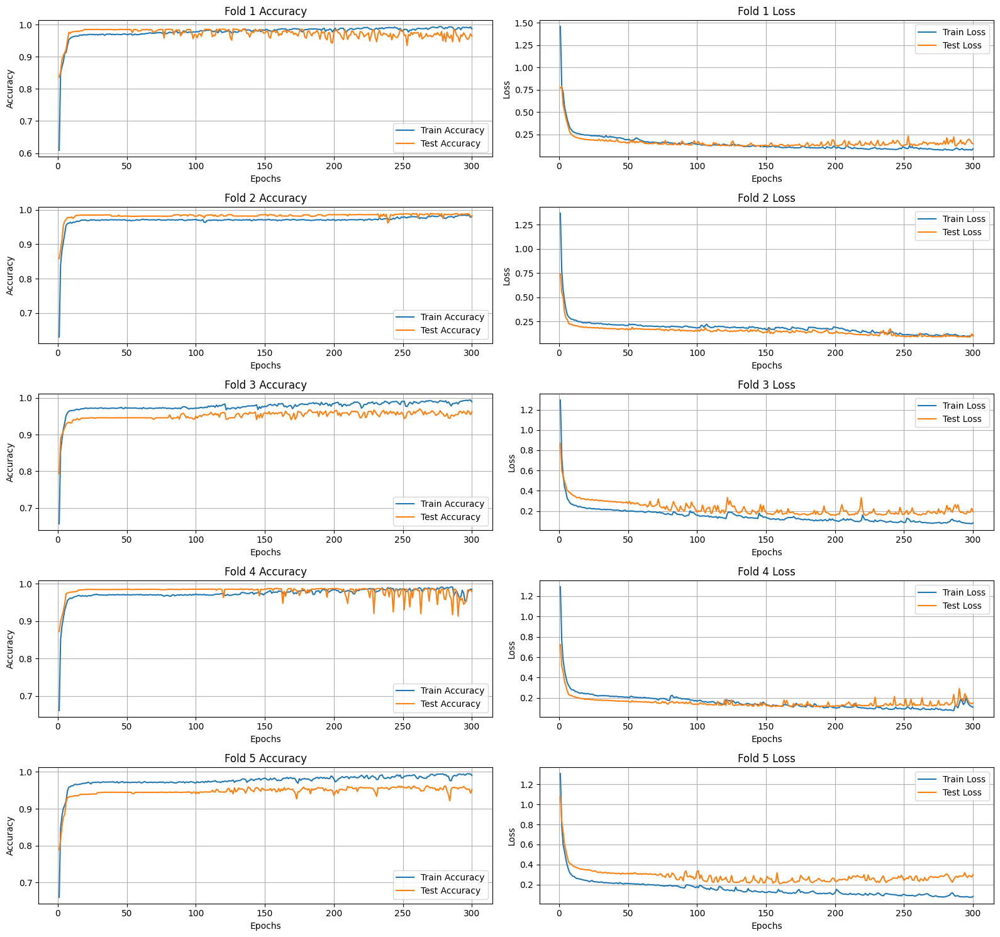

In [33]:
# Select the best fold based on the highest test accuracy in the last epoch
best_fold = max(folds_res, key=lambda fold: fold['test_acc'][-1])

fig, axs = plt.subplots(len(folds_res), 2, figsize=(16, 15))

for idx, fold in enumerate(folds_res):
    axs[idx, 0].plot(np.arange(1, epochs + 1), fold['train_acc'], label='Train Accuracy')
    axs[idx, 0].plot(np.arange(1, epochs + 1), fold['test_acc'], label='Test Accuracy')
    axs[idx, 0].set_ylabel('Accuracy')
    axs[idx, 0].set_xlabel('Epochs')
    axs[idx, 0].set_title(f'Fold {idx + 1} Accuracy')
    axs[idx, 0].legend()
    axs[idx, 0].grid()

    axs[idx, 1].plot(np.arange(1, epochs + 1), fold['train_losses'], label='Train Loss')
    axs[idx, 1].plot(np.arange(1, epochs + 1), fold['test_losses'], label='Test Loss')
    axs[idx, 1].set_ylabel('Loss')
    axs[idx, 1].set_xlabel('Epochs')
    axs[idx, 1].set_title(f'Fold {idx + 1} Loss')
    axs[idx, 1].legend()
    axs[idx, 1].grid()

plt.tight_layout()

plt.show()

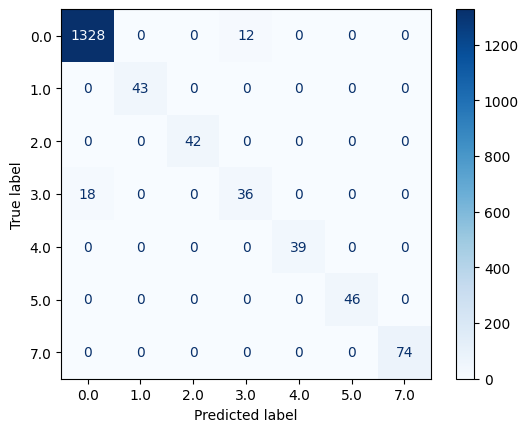

In [35]:
model.load_state_dict(torch.load(f'.\\models\\{best_fold["fold"]}-fold-model.pth'))

model.eval()

y_pred, y_true = np.array([]), np.array([])

with torch.no_grad():
    for x_batch, y_batch in test_loader:
        x_batch = x_batch.to(device)
        y_batch = y_batch.to(device)

        probs = torch.softmax(model(x_batch), dim=1).cpu().numpy()
        y_pred = np.hstack((y_pred, np.argmax(probs, axis=1)))
        y_true = np.hstack((y_true, y_batch.cpu().numpy().ravel()))

cm = confusion_matrix(y_true, y_pred)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=np.unique(y_true))
disp.plot(cmap='Blues')
plt.show()


In [36]:
model.eval()

for label in np.unique(y):
    indexes = np.where(y == label)[0]

    x_label = torch.tensor(X[indexes], dtype=torch.float32).to(device)
    y_label = torch.tensor(y[indexes], dtype=torch.long).to(device)
    label_loader = torch.utils.data.DataLoader(torch.utils.data.TensorDataset(x_label, y_label), batch_size=indexes.shape[0])

    for x_batch, y_batch in label_loader:
        with torch.no_grad():
            probs = torch.softmax(model(x_batch), dim=1)
            y_pred = torch.argmax(probs, axis=1)
            y_true = y_batch

            acc = (y_pred == y_true).float().mean().item()

        print(f'Class: {label}, Accuracy: {acc * 100:.2f} %')

Class: 0, Accuracy: 98.86 %
Class: 1, Accuracy: 100.00 %
Class: 2, Accuracy: 100.00 %
Class: 3, Accuracy: 67.51 %
Class: 4, Accuracy: 100.00 %
Class: 5, Accuracy: 100.00 %
Class: 7, Accuracy: 100.00 %
